# Описание данных и задача

Главный показатель в моем иследовани продолжительность жизни SP.DYN.LE00.IN
исторический 1960:2024 этап

- SP.DYN.LE00.IN     Продолжительность жизни при рождении
- SP.DYN.CBRT.IN     Рождаемость (кол-во рождений на 1000 человек)
- SP.DYN.CDRT.IN     Смертность (кол-во смертей на 1000 человек)
- SP.POP.GROW        Рост населения (%)
- SP.DYN.IMRT.IN     Детская смертность (0–1 год)
- NY.GDP.PCAP.CD     ВВП на душу населения (долл. США, номинал)      экономика
- NE.TRD.GNFS.ZS     Торговля (% ВВП)
- EG.USE.PCAP.KG.OE  Энергопотребление на душу (кг нефт. экв.)
- NV.AGR.TOTL.ZS     Сельское хозяйство (% ВВП)
- NV.IND.TOTL.ZS     Промышленность (% ВВП)
- SP.URB.TOTL.IN.ZS  Урбанизация (% населения)
- SE.XPD.TOTL.GD.ZS расходы на образование

In [10]:

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import kruskal
from etl.config import load_cfg, validate_cfg
import pandas as pd
from sqlalchemy import create_engine
import matplotlib.pyplot as plt
import numpy as np
from copy import deepcopy
import seaborn as sns

In [11]:
cfg = load_cfg("configs/config.json")

USER = cfg["user"]
PASSWORD = cfg["password"]
HOST = cfg["host"]
PORT = cfg["port"]
DBNAME = cfg["dbname"]


DATABASE_URL = f"postgresql+psycopg2://{USER}:{PASSWORD}@{HOST}:{PORT}/{DBNAME}?sslmode=require"
engine = create_engine(DATABASE_URL)



In [12]:
df = pd.read_sql("SELECT * FROM public.main_table", engine)
df_c = pd.read_sql("SELECT * FROM public.country", engine)
df_r = pd.read_sql("SELECT * FROM public.region", engine)
df_il = pd.read_sql("SELECT * FROM public.income_level", engine)
df_i = pd.read_sql("SELECT * FROM public.indicator", engine)
display(df.info())
display(df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 164580 entries, 0 to 164579
Data columns (total 7 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   id            164580 non-null  int64 
 1   country_id    164580 non-null  object
 2   indicator_id  164580 non-null  object
 3   date          164580 non-null  object
 4   value         164580 non-null  object
 5   obs_status    164580 non-null  object
 6   unit          164580 non-null  object
dtypes: int64(1), object(6)
memory usage: 8.8+ MB


None

,id,country_id,indicator_id,date,value,obs_status,unit
0,3,AFG,SP.DYN.LE00.IN,2024,N/F,N/F,N/F
1,4,AFG,SP.DYN.LE00.IN,2023,66.035,N/F,N/F
2,5,AFG,SP.DYN.LE00.IN,2022,65.617,N/F,N/F
3,6,AFG,SP.DYN.LE00.IN,2021,60.417,N/F,N/F
4,7,AFG,SP.DYN.LE00.IN,2020,61.454,N/F,N/F


# Знакомство с данными. Заполнение пропущенных значений

In [13]:
df = df[["country_id", "indicator_id", "date", "value" ]]

In [14]:
display(df[df["value"] == "N/F"]["value"].count())
display(df[df["date"] == "N/F"]["date"].count())

np.int64(37961)

np.int64(0)

In [15]:
df['value'] = df['value'].replace("N/F", np.nan)
df['value'] = df['value'].astype(float)
df['date'] = pd.to_datetime(df['date']).dt.year
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 164580 entries, 0 to 164579
Data columns (total 4 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   country_id    164580 non-null  object 
 1   indicator_id  164580 non-null  object 
 2   date          164580 non-null  int32  
 3   value         126619 non-null  float64
dtypes: float64(1), int32(1), object(2)
memory usage: 4.4+ MB


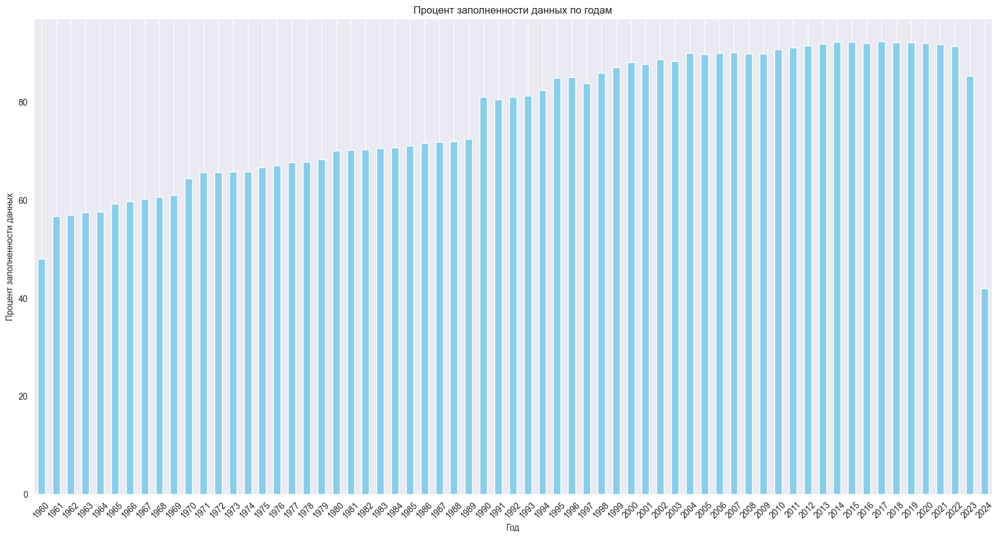

In [16]:
counts_by_year = (df.groupby('date')['value'].count()
                  / df.groupby('date')['value'].size() * 100)

plt.figure(figsize=(20,10))
counts_by_year.plot(kind='bar', color='skyblue')
plt.xlabel('Год')
plt.ylabel('Процент заполненности данных')
plt.title('Процент заполненности данных по годам')
plt.grid(axis='y')
plt.xticks(rotation=45)
plt.show()

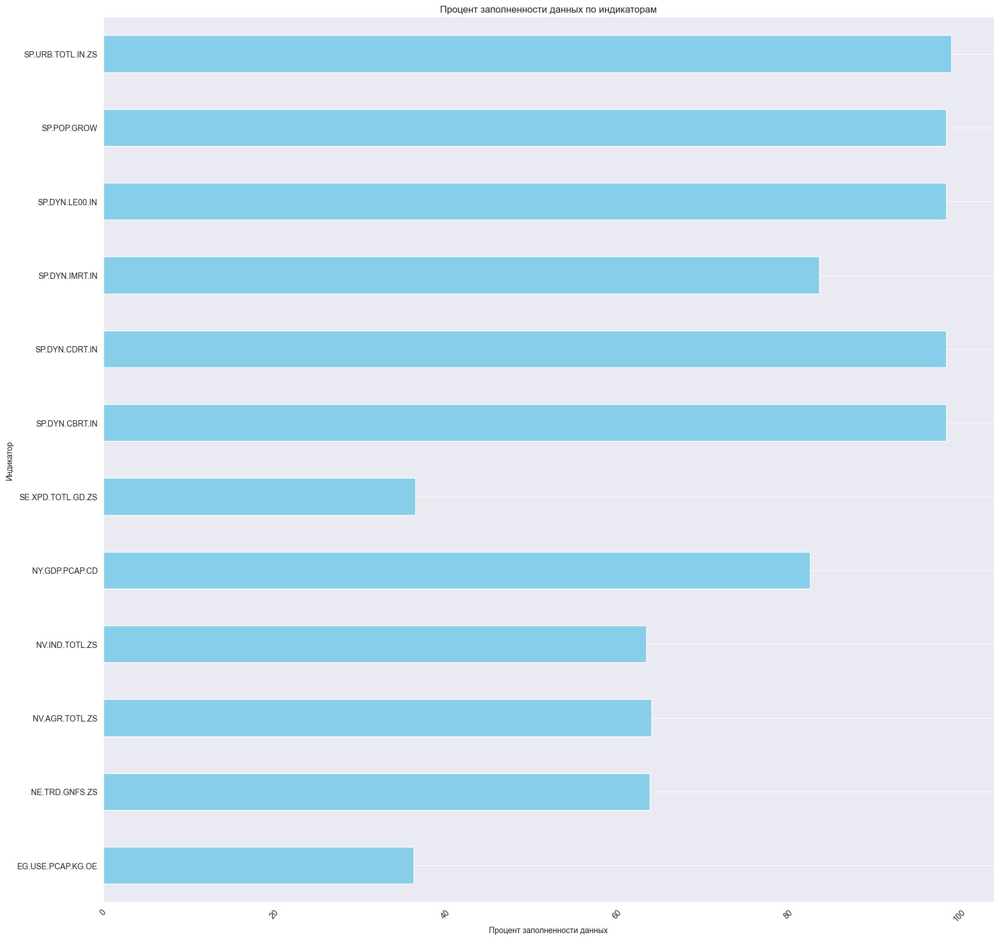

In [17]:
counts_by_indicators = (df.groupby('indicator_id')['value'].count()
                  / df.groupby('indicator_id')['value'].size() * 100)

plt.figure(figsize=(20,20))
counts_by_indicators.plot(kind='barh', color='skyblue')
plt.xlabel('Процент заполненности данных')
plt.ylabel('Индикатор')
plt.title('Процент заполненности данных по индикаторам')
plt.grid(axis='x')
plt.xticks(rotation=45)
plt.show()

In [18]:
counts_by_countries = (df.groupby('country_id')['value'].count()
                  / df.groupby('country_id')['value'].size() * 100)

counts_by_countries.describe()

count    211.000000
mean      76.934621
std       12.087518
min       33.333333
25%       70.641026
50%       78.717949
75%       87.628205
max       93.333333
Name: value, dtype: float64

Как видно обнаружены пропуски значений некоторых показателей. Их достаточно много около 23%, попробуем исключить наиболее неполные общности для начала, как видно, что 2024 год содержит очень много пропусков, стоит его исключить, набор индикаторов оставляем таким какой он есть, попробуем найти страны с наиболее неполными данными, можно увидеть что есть условная страна где лишь 33 процента непустых строк

In [19]:
counts_by_countries = counts_by_countries.reset_index()
counts_by_countries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211 entries, 0 to 210
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   country_id  211 non-null    object 
 1   value       211 non-null    float64
dtypes: float64(1), object(1)
memory usage: 3.4+ KB


In [20]:
counts_by_countries.sort_values(by='value').head(20)

,country_id,value
114,MAF,33.333333
178,SXM,45.512821
128,MNP,46.538462
78,GUM,46.538462
202,VIR,46.538462
8,ASM,46.666667
206,XKX,48.461538
85,IMN,48.974359
46,CYM,49.102564
108,LIE,51.025641


In [21]:
counts_by_countries[counts_by_countries['value'] >= 60]['country_id'].count() / counts_by_countries['country_id'].count() * 100

np.float64(89.0995260663507)

Остается около 88 процентов стран для анализа если исключить страны, с процентом пропусков более 60 процентов, однако не очевидно что это за страны, посмотрим на

In [22]:
count_c_merged = pd.merge(counts_by_countries, df_c, left_on='country_id', right_on='id', how='left')
count_c_merged = pd.merge(count_c_merged, df_r, left_on='region_id', right_on='region_id', how='left')
count_c_merged = pd.merge(count_c_merged, df_il, left_on='income_level_id', right_on='income_level_id', how='left')

count_c_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211 entries, 0 to 210
Data columns (total 16 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              211 non-null    object 
 1   value                   211 non-null    float64
 2   id                      211 non-null    object 
 3   iso2_code               211 non-null    object 
 4   name                    211 non-null    object 
 5   capital_city            211 non-null    object 
 6   longitude               211 non-null    object 
 7   latitude                211 non-null    object 
 8   region_id               211 non-null    object 
 9   adminregion_id          211 non-null    object 
 10  income_level_id         211 non-null    object 
 11  lending_type_id         211 non-null    object 
 12  region_iso2_code        211 non-null    object 
 13  region_value            211 non-null    object 
 14  income_level_iso2_code  211 non-null    ob

In [23]:
count_c_merged[['name', 'region_value', 'income_level_value', 'value']].sort_values(by='value').head(30)

,name,region_value,income_level_value,value
114,St. Martin (French part),Latin America & Caribbean,High income,33.333333
178,Sint Maarten (Dutch part),Latin America & Caribbean,High income,45.512821
128,Northern Mariana Islands,East Asia & Pacific,High income,46.538462
78,Guam,East Asia & Pacific,High income,46.538462
202,Virgin Islands (U.S.),Latin America & Caribbean,High income,46.538462
8,American Samoa,East Asia & Pacific,High income,46.666667
206,Kosovo,Europe & Central Asia,Upper middle income,48.461538
85,Isle of Man,Europe & Central Asia,High income,48.974359
46,Cayman Islands,Latin America & Caribbean,High income,49.102564
108,Liechtenstein,Europe & Central Asia,High income,51.025641


In [24]:
count_c_d_merged = pd.merge(df, count_c_merged[['country_id','name', 'value']], left_on='country_id', right_on='country_id', how='left', suffixes=('', '_merged'))
count_c_d_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 164580 entries, 0 to 164579
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   country_id    164580 non-null  object 
 1   indicator_id  164580 non-null  object 
 2   date          164580 non-null  int32  
 3   value         126619 non-null  float64
 4   name          164580 non-null  object 
 5   value_merged  164580 non-null  float64
dtypes: float64(2), int32(1), object(3)
memory usage: 6.9+ MB


<Figure size 2000x5000 with 0 Axes>

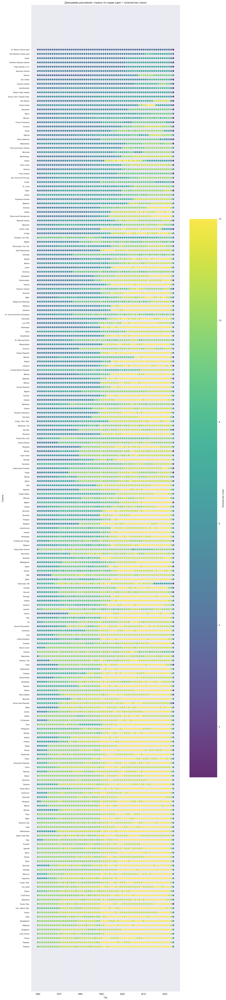

In [25]:
plt.figure(figsize=(20,50))
df_new = count_c_d_merged[count_c_d_merged['value'].notna()].sort_values(by='value_merged', ascending=False)
df_new_agg = df_new.groupby(['name', 'date', 'value_merged']).size().reset_index(name='count').sort_values(by='value_merged', ascending=False)
plt.figure(figsize=(15, 80))
scatter = plt.scatter(
    df_new_agg['date'],
    df_new_agg['name'],
    s=50,
    c=df_new_agg['count'],
    cmap='viridis',
    alpha=0.8
)

plt.xlabel('Год')
plt.ylabel('Страна')
plt.yticks(fontsize=8)
plt.title('Диаграмма рассеяния: страны по годам (цвет = количество строк)')
plt.colorbar(scatter, label='Количество строк')  # легенда цвета
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.show()

<Figure size 2000x5000 with 0 Axes>

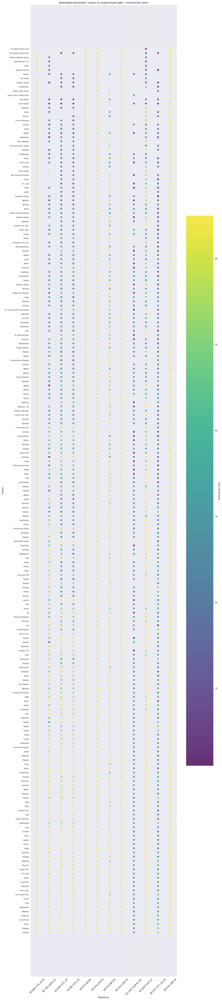

In [26]:
plt.figure(figsize=(20,50))

df_new_agg = df_new.groupby(['name', 'indicator_id', 'value_merged']).size().reset_index(name='count').sort_values(by='value_merged', ascending=False)
plt.figure(figsize=(15, 80))
scatter = plt.scatter(
    df_new_agg['indicator_id'],
    df_new_agg['name'],
    s=50,
    c=df_new_agg['count'],
    cmap='viridis',
    alpha=0.8
)

plt.xlabel('Индикатор')
plt.ylabel('Страна')
plt.yticks(fontsize=8)
plt.title('Диаграмма рассеяния: страны по индикаторам (цвет = количество строк)')
plt.colorbar(scatter, label='Количество строк')  # легенда цвета
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.xticks(rotation=45)
plt.show()

<Figure size 2000x5000 with 0 Axes>

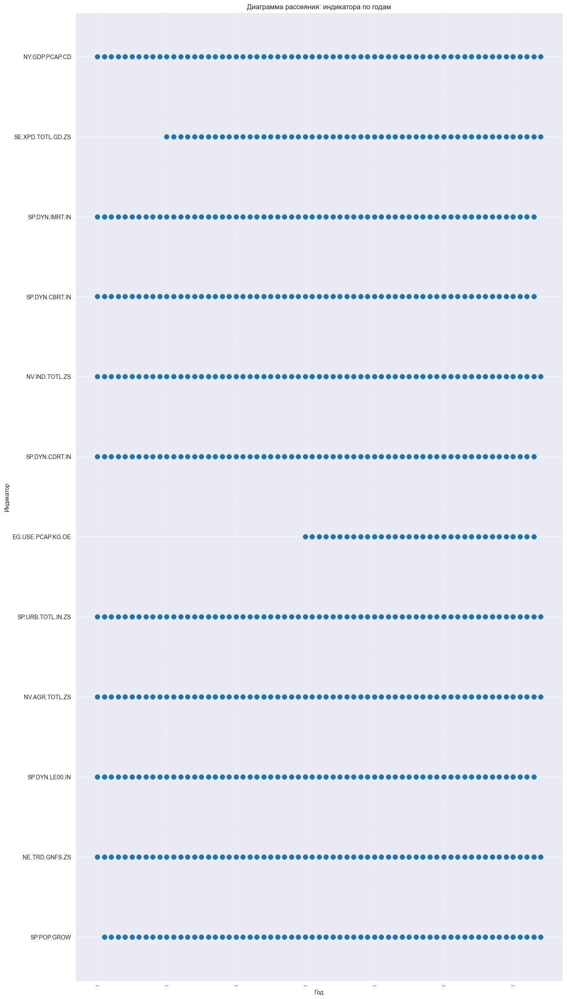

In [27]:
plt.figure(figsize=(20,50))

df_new_agg = df_new.groupby(['date', 'indicator_id', 'value_merged']).size().reset_index(name='count').sort_values(by='value_merged', ascending=False)
plt.figure(figsize=(15, 30))
scatter = plt.scatter(
    df_new_agg['date'],
    df_new_agg['indicator_id'],
    s=50,
)

plt.xlabel('Год')
plt.ylabel('Индикатор')
plt.xticks(fontsize=3)
plt.title('Диаграмма рассеяния: индикатора по годам')
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.show()

Первое что хочется заметить что начиная с 1990 года, для большинства стран существуют значения почти всех 12 индикаторов, 2024 год в этом плане очень грязный его точно следует исключить. Также существует ряд стран, многие из них островные гос-ва, бывшие колонии больших стран, про них значительно меньше информации, возьмем страны с нополненостью больше 60 процентов. Также есть два не самых удачных индикатора это EG.USE.PCAP.KG.OE и SE.XPD.TOTL.GD.ZS

In [28]:
df_d = count_c_d_merged[(count_c_d_merged['date'] < 2024)
                        & (count_c_d_merged['date'] >= 1990)
                        & (count_c_d_merged['value_merged'] >= 60)
                        &  (count_c_d_merged['indicator_id'] != "EG.USE.PCAP.KG.OE")
                        &  (count_c_d_merged['indicator_id'] != "SE.XPD.TOTL.GD.ZS")

]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")


'Процент пропусков до23.065378539312192'

'Процент пропусков после 3.3557571964956168'

'Число удаленных строк 64844'

'Число строк до удаления 126619'

Однако все-таки хочется провести анализ на промежутке 1960-2024

In [29]:
df_d = count_c_d_merged[(count_c_d_merged['date'] < 2024)
                        #& (count_c_d_merged['date'] >= 1990)
                        & (count_c_d_merged['value_merged'] >= 60)
                        &  (count_c_d_merged['indicator_id'] != "EG.USE.PCAP.KG.OE")
                        &  (count_c_d_merged['indicator_id'] != "SE.XPD.TOTL.GD.ZS")

]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")

'Процент пропусков до23.065378539312192'

'Процент пропусков после 11.466921542553195'

'Число удаленных строк 20096'

'Число строк до удаления 126619'

In [30]:
df_d = count_c_d_merged[(count_c_d_merged['date'] < 2024)
                        & (count_c_d_merged['date'] >= 1990)
                        & (count_c_d_merged['value_merged'] >= 60)
                        #&  (count_c_d_merged['indicator_id'] != "EG.USE.PCAP.KG.OE")
                        #&  (count_c_d_merged['indicator_id'] != "SE.XPD.TOTL.GD.ZS")

]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")

'Процент пропусков до23.065378539312192'

'Процент пропусков после 8.171672924488945'

'Число удаленных строк 56183'

'Число строк до удаления 126619'

In [31]:
df_d = count_c_d_merged[(count_c_d_merged['date'] < 2024)
                        & (count_c_d_merged['date'] >= 1990)
                        #& (count_c_d_merged['value_merged'] >= 60)
                        &  (count_c_d_merged['indicator_id'] != "EG.USE.PCAP.KG.OE")
                        &  (count_c_d_merged['indicator_id'] != "SE.XPD.TOTL.GD.ZS")

]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")

'Процент пропусков до23.065378539312192'

'Процент пропусков после 6.342347365486475'

'Число удаленных строк 59429'

'Число строк до удаления 126619'

In [32]:
df_d = count_c_d_merged[(count_c_d_merged['date'] < 2024)
                        #& (count_c_d_merged['date'] >= 1990)
                        & (count_c_d_merged['value_merged'] >= 50)
                        #&  (count_c_d_merged['indicator_id'] != "EG.USE.PCAP.KG.OE")
                        #&  (count_c_d_merged['indicator_id'] != "SE.XPD.TOTL.GD.ZS")

]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")

'Процент пропусков до23.065378539312192'

'Процент пропусков после 21.122756806930695'

'Число удаленных строк 4252'

'Число строк до удаления 126619'

Основной вывод есть условная граница в 1990 год когда данные становятся достаточно плотными, да есть индикаторы которые менее наполнены при отдалении от 1990 года, также есть страны - мелкие гос-ва с меньшей наполненностью однако, цена удаления все еще сильно велика, единственное, что точно хочется исключить эт 2024 из исследования уж слишком мало данных меньше чем в 2024 году, для начала теперь заполним промежуточные пропуски.

Пусть есть участок значений индикатора для определенной страны на временном участке пусть есть значения при дате date_1 и date_2, причем date_2 > date_1, в даты на этом интервале пропущены все значения, заполним их средним значением индикатора для date_1 и date_2


In [33]:
def fill_missing_values(df):
    df = df.sort_values(['country_id', 'indicator_id', 'date'])

    def fill_group(x):
        if x.isna().all():
            return x
        x = x.ffill()
        x = x.bfill()
        x = x.interpolate(method='linear')
        return x

    df['value'] = df.groupby(['country_id', 'indicator_id'])['value'].transform(fill_group)

    return df

In [34]:
df = df[df['date'] <= 2023].copy()
df_filled = fill_missing_values(df)

df_filled.info()
display(f"Процент пропусков {(df_filled['value'].isna().mean()) * 100}")

<class 'pandas.core.frame.DataFrame'>
Index: 162048 entries, 110372 to 164516
Data columns (total 4 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   country_id    162048 non-null  object 
 1   indicator_id  162048 non-null  object 
 2   date          162048 non-null  int32  
 3   value         155264 non-null  float64
dtypes: float64(1), int32(1), object(2)
memory usage: 5.6+ MB


'Процент пропусков 4.1864139020537126'

In [35]:
count_c_d_merged = pd.merge(df_filled, count_c_merged[['country_id','name', 'value']], left_on='country_id', right_on='country_id', how='left', suffixes=('', '_merged'))
count_c_d_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162048 entries, 0 to 162047
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   country_id    162048 non-null  object 
 1   indicator_id  162048 non-null  object 
 2   date          162048 non-null  int32  
 3   value         155264 non-null  float64
 4   name          162048 non-null  object 
 5   value_merged  162048 non-null  float64
dtypes: float64(2), int32(1), object(3)
memory usage: 6.8+ MB


<Figure size 2000x5000 with 0 Axes>

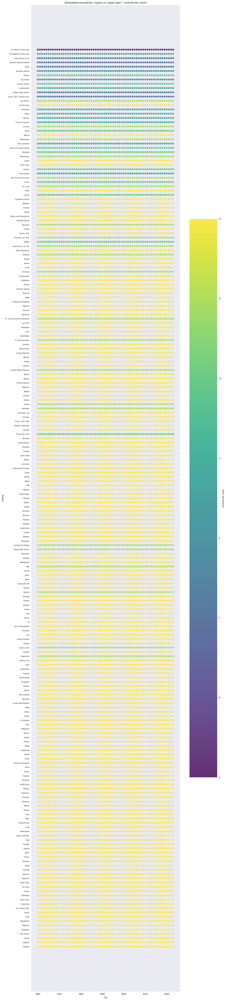

In [36]:
plt.figure(figsize=(20,50))
df_new = count_c_d_merged[count_c_d_merged['value'].notna()].sort_values(by='value_merged', ascending=False)
df_new_agg = df_new.groupby(['name', 'date', 'value_merged']).size().reset_index(name='count').sort_values(by='value_merged', ascending=False)
plt.figure(figsize=(15, 80))
scatter = plt.scatter(
    df_new_agg['date'],
    df_new_agg['name'],
    s=50,
    c=df_new_agg['count'],
    cmap='viridis',
    alpha=0.8
)

plt.xlabel('Год')
plt.ylabel('Страна')
plt.yticks(fontsize=8)
plt.title('Диаграмма рассеяния: страны по годам (цвет = количество строк)')
plt.colorbar(scatter, label='Количество строк')  # легенда цвета
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.show()

In [37]:
df = deepcopy(df_filled)

In [38]:
countries_with_na = df[df['value'].isna()]['country_id'].unique()
display(countries_with_na, len(countries_with_na))

indicators_with_na = df[df['value'].isna()]['indicator_id'].unique()
display(indicators_with_na, len(indicators_with_na))

i_c_with_na = df[df['value'].isna()][['indicator_id', 'country_id']].drop_duplicates()
display(i_c_with_na.count())

array(['ABW', 'AFG', 'AND', 'ASM', 'BDI', 'BMU', 'BRB', 'CAF', 'CUW',
       'CYM', 'DMA', 'FRO', 'FSM', 'GIN', 'GRD', 'GRL', 'GUM', 'IMN',
       'KNA', 'LBR', 'LCA', 'LIE', 'MAF', 'MCO', 'MLI', 'MMR', 'MNE',
       'MNP', 'MRT', 'MWI', 'NCL', 'NRU', 'PNG', 'PRI', 'PRK', 'PYF',
       'SLE', 'SMR', 'SOM', 'STP', 'SXM', 'TCA', 'TTO', 'TUV', 'VCT',
       'VGB', 'VIR', 'XKX'], dtype=object)

48

array(['EG.USE.PCAP.KG.OE', 'SP.DYN.IMRT.IN', 'NE.TRD.GNFS.ZS',
       'NV.AGR.TOTL.ZS', 'NV.IND.TOTL.ZS', 'SE.XPD.TOTL.GD.ZS',
       'SP.URB.TOTL.IN.ZS', 'NY.GDP.PCAP.CD'], dtype=object)

8

indicator_id    106
country_id      106
dtype: int64

In [39]:
count_miss_ind_for_count = i_c_with_na.groupby(['country_id']).count().sort_values(by='indicator_id', ascending=False).reset_index()
display(count_miss_ind_for_count.head())
list_countr = count_miss_ind_for_count[count_miss_ind_for_count['indicator_id'] >= 3 ]['country_id'].tolist()
display(list_countr)

,country_id,indicator_id
0,MAF,7
1,PRK,5
2,VGB,5
3,MNP,5
4,GUM,5


['MAF',
 'PRK',
 'VGB',
 'MNP',
 'GUM',
 'VIR',
 'ASM',
 'IMN',
 'MCO',
 'FRO',
 'GRL',
 'LIE',
 'SXM',
 'NRU',
 'NCL',
 'PYF']

,country_id
indicator_id,
1,22
2,10
3,8
5,5
4,2
7,1


<Figure size 1200x600 with 0 Axes>

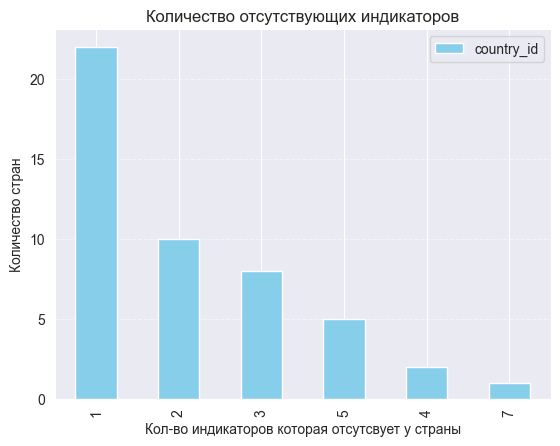

In [40]:
counts = count_miss_ind_for_count.groupby(['indicator_id']).count().sort_values(by='country_id', ascending=False)
display(counts)
plt.figure(figsize=(12,6))
counts.plot(kind='bar', color='skyblue')
plt.xlabel('Кол-во индикаторов которая отсутсвует у страны')
plt.ylabel('Количество стран')
plt.title('Количество отсутствующих индикаторов')
plt.xticks(rotation=90)  # если стран много, поворачиваем подписи
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.show()

In [41]:
counts_df = counts.reset_index()
counts_df.columns = ['indicator_id', 'country_id']
counts_df[counts_df['indicator_id'] >= 3]['country_id'].sum()

np.int64(16)

Изначально было выявлено два индикатора, которые выбивались. Нам точно не нужны в анализе страны, у которых пропущено 3, 4 и там более 5 и 7 индикаторов исключим эти страны, ведь это повышает вероятность того что данные для оставшихся индикаторов были в большинстве получены интерполяцией

Также стоит помнить что данные для тех двух индикаторов для ранних дат были интерполированы, крайним левым известным значением, конкретно эти индикаторы лучше анализировать в промежутке от 1970 года SE.XPD.TOTL.GD.ZS  и 1990 года для EG.USE.PCAP.KG.OE

In [42]:

df_d = df[~(df['country_id'].isin(list_countr) )]
display(f"Процент пропусков до{100 - (df['value'].count()/ df['value'].size * 100)}")
display(f"Процент пропусков после {100 - (df_d['value'].count()/ df_d['value'].size * 100)}")
display(f"Число удаленных строк {df['value'].count() - df_d['value'].count()}")
display(f"Число строк до удаления {df['value'].count()}")

indicators_with_na = df_d[df_d['value'].isna()]['indicator_id'].unique()
display(indicators_with_na, len(indicators_with_na))

'Процент пропусков до4.186413902053715'

'Процент пропусков после 1.7948717948717956'

'Число удаленных строк 8192'

'Число строк до удаления 155264'

array(['EG.USE.PCAP.KG.OE', 'SP.DYN.IMRT.IN', 'NE.TRD.GNFS.ZS',
       'SE.XPD.TOTL.GD.ZS', 'SP.URB.TOTL.IN.ZS'], dtype=object)

5

Все равно слишком дорого, при этом оставшиеся индикаторы довльно разнообразны, не будем пока убирать страны даже с большим кол-во пропусков по индикаторам, во всяком случае пока

In [43]:
df['value'].isna().count()
display(f"Процент пропусков {(df_filled['value'].isna().mean()) * 100}")

'Процент пропусков 4.1864139020537126'

Процент пропусков был уменьшен с 23% до 4% после интерполяции, а также фильтрации по году (исключили 2023), было удалено 2532 строки (все данные о 2023 годе) чуть меньше 2 процентов, оставшиеся 4 процента есть строки страна индликатор полностью пустые они нам не пригодятся уберем их из анализа

In [44]:
df = df[df['value'].notna()]
df.info()

df = pd.merge(df, df_c, left_on='country_id', right_on='id', how='left', suffixes=('', '_country'))
df = pd.merge(df, df_r, left_on='region_id', right_on='region_id', how='left')
df = pd.merge(df, df_il, left_on='income_level_id', right_on='income_level_id', how='left')
df = pd.merge(df, df_i, left_on='indicator_id', right_on='id', how='left', suffixes=('', '_indicator'))


<class 'pandas.core.frame.DataFrame'>
Index: 155264 entries, 96654 to 164516
Data columns (total 4 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   country_id    155264 non-null  object 
 1   indicator_id  155264 non-null  object 
 2   date          155264 non-null  int32  
 3   value         155264 non-null  float64
dtypes: float64(1), int32(1), object(2)
memory usage: 5.3+ MB


In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155264 entries, 0 to 155263
Data columns (total 24 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   country_id              155264 non-null  object 
 1   indicator_id            155264 non-null  object 
 2   date                    155264 non-null  int32  
 3   value                   155264 non-null  float64
 4   id                      155264 non-null  object 
 5   iso2_code               155264 non-null  object 
 6   name                    155264 non-null  object 
 7   capital_city            155264 non-null  object 
 8   longitude               155264 non-null  object 
 9   latitude                155264 non-null  object 
 10  region_id               155264 non-null  object 
 11  adminregion_id          155264 non-null  object 
 12  income_level_id         155264 non-null  object 
 13  lending_type_id         155264 non-null  object 
 14  region_iso2_code    

# Описательная статистика и предварительный анализ

In [46]:
temp = df.groupby(['region_value', 'income_level_id'])['country_id'].nunique().reset_index()

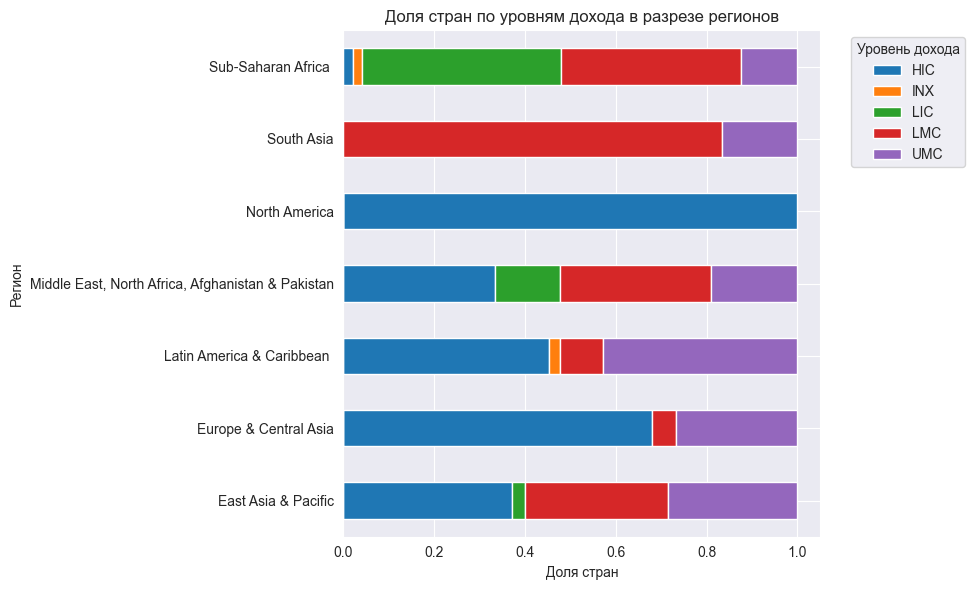

In [47]:
pivot_df = temp.pivot(index='region_value', columns='income_level_id', values='country_id')

pivot_df_rel = pivot_df.div(pivot_df.sum(axis=1), axis=0)

pivot_df_rel.plot(
    kind='barh',
    stacked=True,
    figsize=(10,6)
)

plt.xlabel('Доля стран')
plt.ylabel('Регион')
plt.title('Доля стран по уровням дохода в разрезе регионов')
plt.legend(title='Уровень дохода', bbox_to_anchor=(1.05,1))
plt.tight_layout()
plt.show()

Здесь мы посмотрели на уровни дохода стран в разрезе региона, чтобы понимать доминацию того или иного типа

## SP.DYN.LE00.IN - Продолжительность жизни

In [48]:
df_1 = deepcopy(df[df['indicator_id'] == 'SP.DYN.LE00.IN'])

In [49]:
df_1['value'].describe()

count    13504.000000
mean        64.938456
std         11.213265
min         10.989000
25%         58.204750
50%         67.533000
75%         73.136500
max         86.372000
Name: value, dtype: float64

In [50]:
display(df_1.sort_values(by='value', ascending=False).tail(5))
display(df_1.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
118306,RWA,SP.DYN.LE00.IN,1994,12.158,RWA,RW,Rwanda,Kigali,30.0587,-1.95325,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
73552,KHM,SP.DYN.LE00.IN,1976,11.632,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
73554,KHM,SP.DYN.LE00.IN,1978,11.573,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
73553,KHM,SP.DYN.LE00.IN,1977,11.295,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
126556,SSD,SP.DYN.LE00.IN,1988,10.989,SSD,SS,South Sudan,Juba,31.6,4.85,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
86335,MCO,SP.DYN.LE00.IN,2023,86.372,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
86331,MCO,SP.DYN.LE00.IN,2019,86.151,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
86332,MCO,SP.DYN.LE00.IN,2020,86.089,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
86330,MCO,SP.DYN.LE00.IN,2018,86.084,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2
86329,MCO,SP.DYN.LE00.IN,2017,85.878,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.LE00.IN,"Life expectancy at birth, total (years)",N/F,Life expectancy at birth indicates the number ...,"World Population Prospects, United Nations (UN...",2


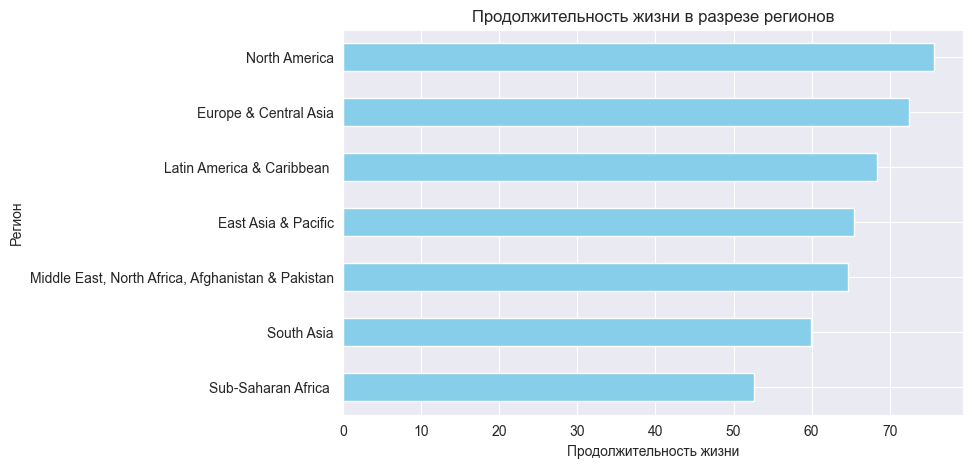

In [51]:
df_1_region = df_1.groupby(['region_value'])['value'].mean().sort_values()

df_1_region.plot(kind='barh', color='skyblue', figsize=(8,5),)
plt.title('Продолжительность жизни в разрезе регионов')
plt.xlabel('Продолжительность жизни')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

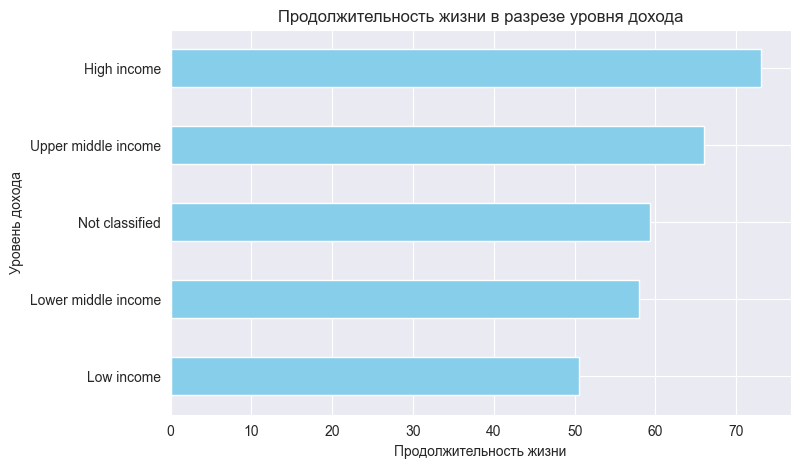

In [52]:
df_1_i_level = df_1.groupby(['income_level_value'])['value'].mean().sort_values()

df_1_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Продолжительность жизни в разрезе уровня дохода')
plt.xlabel('Продолжительность жизни')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

In [53]:
display(df_1['value'].quantile(0.01))
display(df_1['value'].quantile(0.99))


np.float64(36.24106)

np.float64(82.8999268292683)

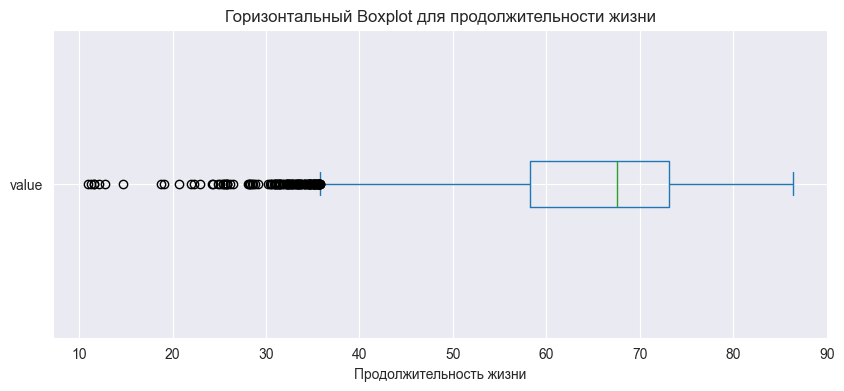

In [54]:
plt.figure(figsize=(10, 4))
df_1['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Горизонтальный Boxplot для продолжительности жизни')
plt.xlabel('Продолжительность жизни')
plt.show()

В целом продолжительность жизни больше 85 выглядит реалистично однако значения 11 лет даже 20 лет в современном мире да даже для 1960 года это довольно мало как мы увидели 1 квантиль 36 лет, перепишем значения индикаторов те что ниже значений для 1 квантиля, прировняем их к этому пороговому значению

In [55]:
filt = df_1['value'].quantile(0.01)

df_1['value'] = df_1['value'].apply(lambda x: filt if x < filt else x)

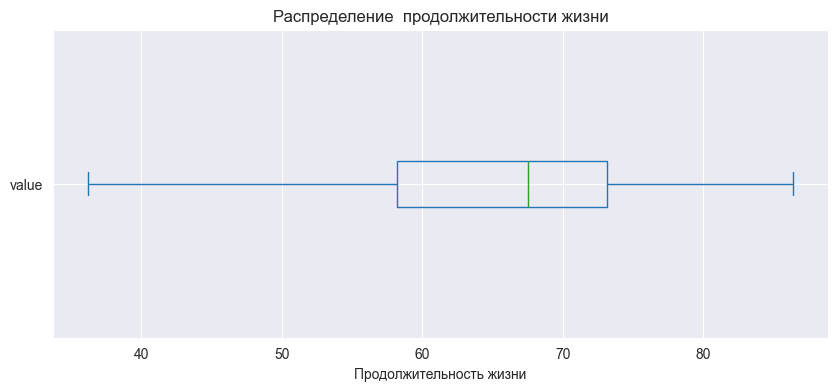

In [56]:
plt.figure(figsize=(10, 4))
df_1['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение  продолжительности жизни')
plt.xlabel('Продолжительность жизни')
plt.show()

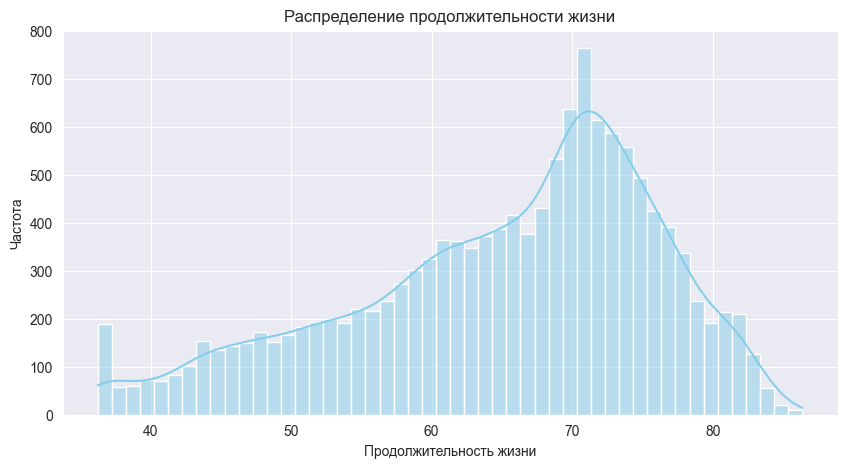

In [57]:
plt.figure(figsize=(10,5))
sns.histplot(df_1['value'].dropna(), bins=50, kde=True, color='skyblue')
plt.title('Распределение продолжительности жизни')
plt.xlabel('Продолжительность жизни')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

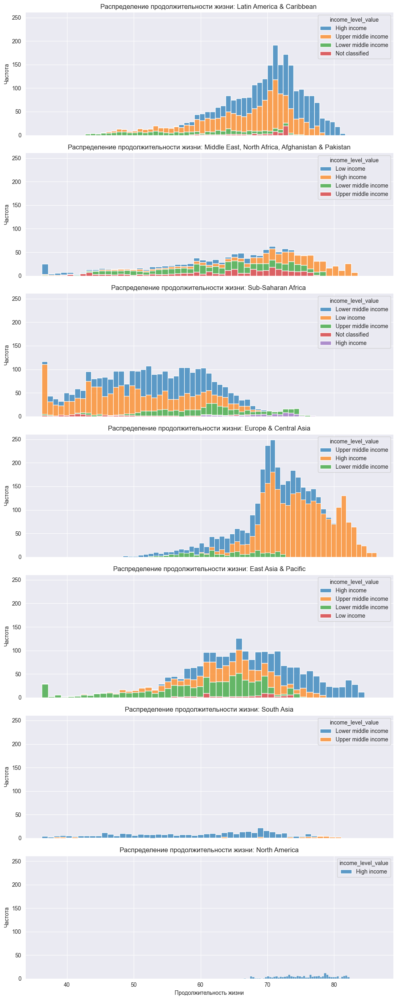

In [58]:
regions = df_1['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_1[df_1['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение продолжительности жизни: {region}')
    ax.set_xlabel('Продолжительность жизни')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

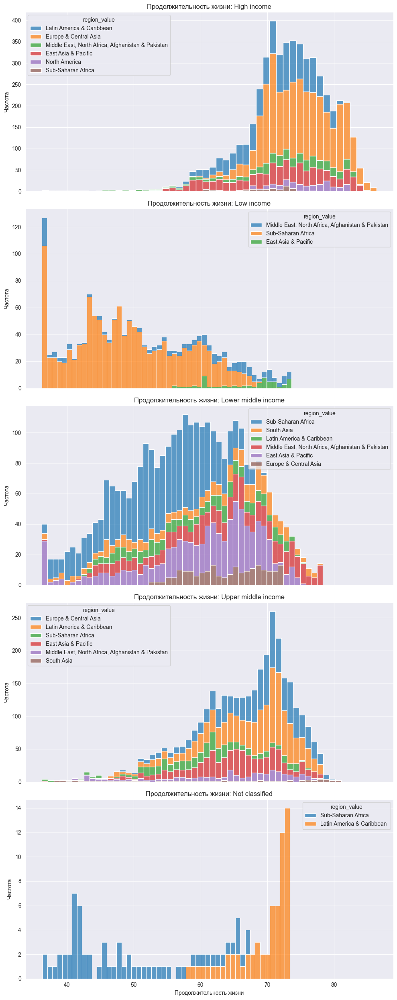

In [59]:
income_level = df_1['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_1[df_1['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Продолжительность жизни: {i_l}')
    ax.set_xlabel('Продолжительность жизни')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

### Промежуточные ввыводы

В данном подразделе мы скорректировали выбросы, теперь колебания средней продолжительности жизни варьируются от ~35 до 86 лет. В разрезе регионов и уровня дохода стран среднее значение больше в более развитых регионах с большим уровнем дохода, нельзя сказать что графики сильно инофрмативны тк это не динамика, однако можно сделать вывод что по большей части на показатель больше влияет не регион, а все таки уровень дохода, а дальше в следствии наполненности региона странами с большим уровнем дохода, растет среднее непосредственно и у региона в целом.
Также хочется что в Африке продолжителность жизни в среднем меньше в разрезе стран с одинаковым уровнем дохода, то есть есь небольшая связь с регионом, для регионов с большей концентрацией богатых стран например Европа такая связь незаметна
Также хочется отметить что для разного уровня дохода разброс распределения становится больше,

## SP.DYN.CBRT.IN - Рождаемость

In [60]:
df_2 = deepcopy(df[df['indicator_id'] == 'SP.DYN.CBRT.IN'])

In [61]:
df_2['value'].describe()

count    13504.000000
mean        27.845879
std         13.171594
min          4.500000
25%         15.829500
50%         26.448500
75%         39.708250
max         57.613000
Name: value, dtype: float64

In [62]:
display(df_2.sort_values(by='value', ascending=False).tail(5))
display(df_2.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
124159,SMR,SP.DYN.CBRT.IN,2023,5.6,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
75644,KOR,SP.DYN.CBRT.IN,2020,5.3,KOR,KR,"Korea, Rep.",Seoul,126.957,37.5323,...,Z4,East Asia & Pacific,XD,High income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
75645,KOR,SP.DYN.CBRT.IN,2021,5.1,KOR,KR,"Korea, Rep.",Seoul,126.957,37.5323,...,Z4,East Asia & Pacific,XD,High income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
75646,KOR,SP.DYN.CBRT.IN,2022,4.9,KOR,KR,"Korea, Rep.",Seoul,126.957,37.5323,...,Z4,East Asia & Pacific,XD,High income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
75647,KOR,SP.DYN.CBRT.IN,2023,4.5,KOR,KR,"Korea, Rep.",Seoul,126.957,37.5323,...,Z4,East Asia & Pacific,XD,High income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
100544,NER,SP.DYN.CBRT.IN,1960,57.613,NER,NE,Niger,Niamey,2.1073,13.514,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
100545,NER,SP.DYN.CBRT.IN,1961,57.410,NER,NE,Niger,Niamey,2.1073,13.514,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
100546,NER,SP.DYN.CBRT.IN,1962,57.242,NER,NE,Niger,Niamey,2.1073,13.514,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
100547,NER,SP.DYN.CBRT.IN,1963,57.026,NER,NE,Niger,Niamey,2.1073,13.514,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2
152582,YEM,SP.DYN.CBRT.IN,1966,56.852,YEM,YE,"Yemen, Rep.",Sana'a,44.2075,15.352,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XM,Low income,SP.DYN.CBRT.IN,"Birth rate, crude (per 1,000 people)",N/F,Crude birth rate indicates the number of live ...,"World Population Prospects, United Nations (UN...",2


In [63]:
display(df_2['value'].quantile(0.01))
display(df_2['value'].quantile(0.99))

np.float64(8.3)

np.float64(52.70888)

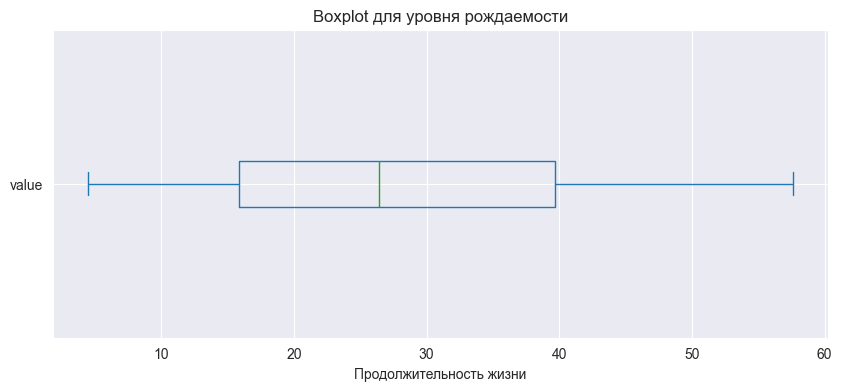

In [64]:
plt.figure(figsize=(10, 4))
df_2['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для уровня рождаемости')
plt.xlabel('Продолжительность жизни')
plt.show()

Сильно выбивающихся значений нет все в рамках здравого смысла

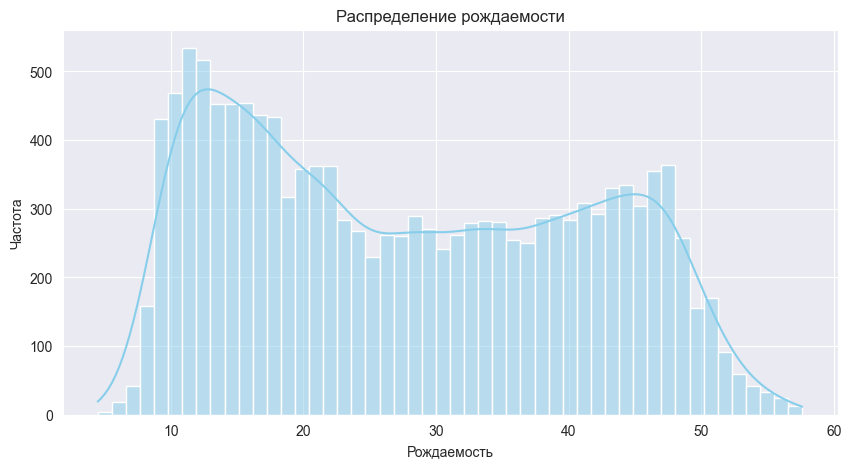

In [65]:
plt.figure(figsize=(10,5))
sns.histplot(df_2['value'].dropna(), bins=50, kde=True, color='skyblue')
plt.title('Распределение рождаемости')
plt.xlabel('Рождаемость')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

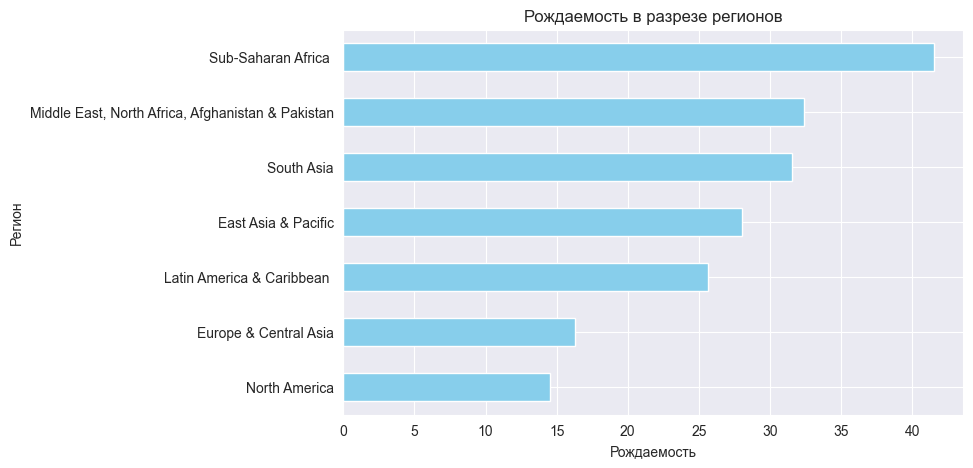

In [66]:
df_2_region = df_2.groupby(['region_value'])['value'].mean().sort_values()

df_2_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Рождаемость в разрезе регионов')
plt.xlabel('Рождаемость')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

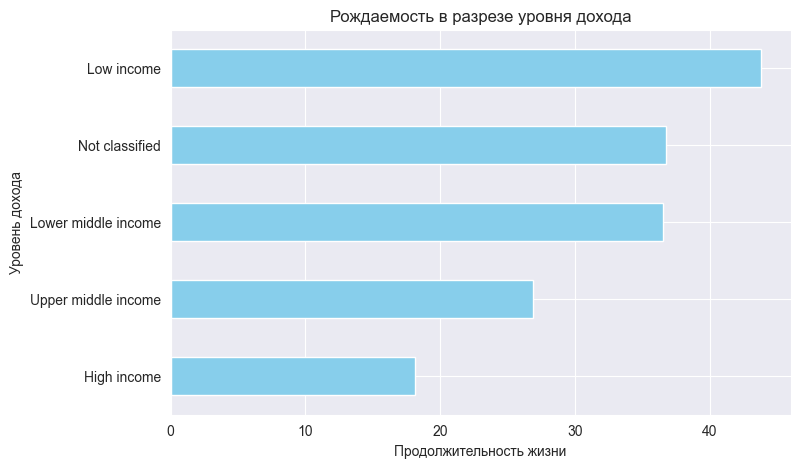

In [67]:
df_2_i_level = df_2.groupby(['income_level_value'])['value'].mean().sort_values()

df_2_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Рождаемость в разрезе уровня дохода')
plt.xlabel('Продолжительность жизни')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

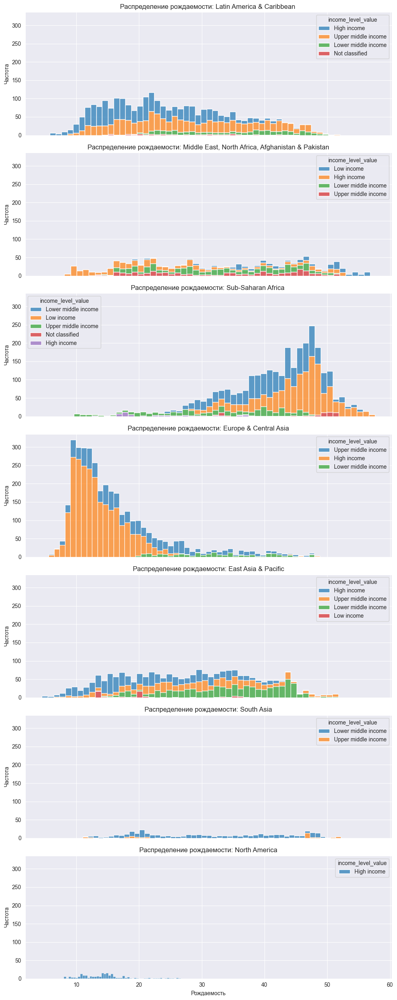

In [68]:
regions = df_2['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_2[df_2['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение рождаемости: {region}')
    ax.set_xlabel('Рождаемость')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

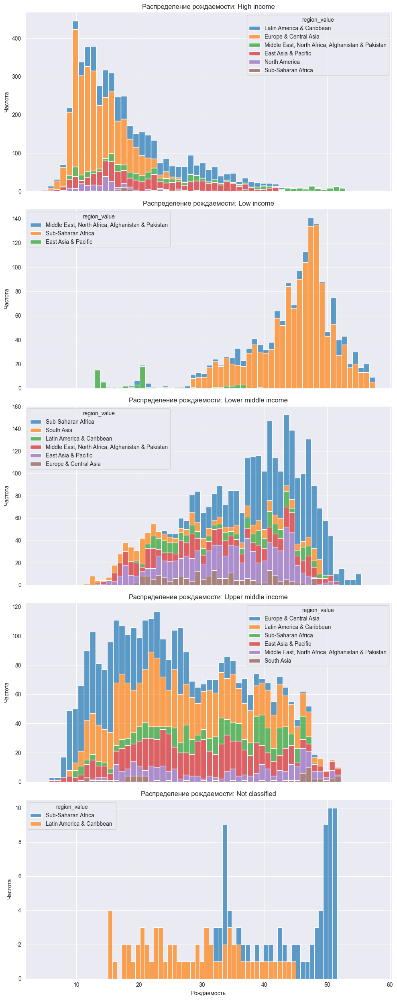

In [69]:
income_level = df_2['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_2[df_2['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение рождаемости: {i_l}')
    ax.set_xlabel('Рождаемость')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

### Промежуточные ввыводы

Данные довольно чистые, выбросов не было обнаружено
Видно, что рождаемость от 4 до 57 промиль
На графике распределения видно два пика - у границы низкой рождаемости и границы высокой рождаемости
Анализируя в разрезе регионов и уровня дохода видно, что чем больше уровень дохода страны тем ниже рождаемость, также и с регионами в европе и северной америке низкая рождаемость, а вот в африке более высокая, тут скорее закономерность наполненности региона уровнем стран.
Перейдем к пикам, заметно что они образуются за счет рождаемости стран европы и африка(скорее правильно будет сказать разбросом рождаемости для богатых и бедных стран), при этом в других регионах больше размазана нежели сконцентрирована. Держим в голове, что это данные всех лет, можно предположить, что это регионы с определенной стогнацией этого показателя, который не меняется сквозь года, то есть регионы, и тут больше не про уровень дохода речь и его концентрации, тут скорее про идеалогию, общественные нормы возможно уровень медицины, сложно сказать без должного подтверждения.
Для Европы и также Латинской америки видно даже в разрезе уровня дохода уровень рождаемости более выражено смещен влево - к более низким показателям, При этом для Африки характерно обратное

## SP.DYN.CDRT.IN - Смертность

In [70]:
df_3 = deepcopy(df[df['indicator_id'] == 'SP.DYN.CDRT.IN'])

In [71]:
df_3['value'].describe()

count    13504.000000
mean        10.351272
std          5.706528
min          0.841000
25%          6.800000
50%          9.014000
75%         12.214000
max        153.963000
Name: value, dtype: float64

In [72]:
display(df_3.sort_values(by='value', ascending=False).tail(5))
display(df_3.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
115903,QAT,SP.DYN.CDRT.IN,2023,0.930,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
115896,QAT,SP.DYN.CDRT.IN,2016,0.920,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
115897,QAT,SP.DYN.CDRT.IN,2017,0.901,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
115898,QAT,SP.DYN.CDRT.IN,2018,0.877,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
115899,QAT,SP.DYN.CDRT.IN,2019,0.841,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
118178,RWA,SP.DYN.CDRT.IN,1994,153.963,RWA,RW,Rwanda,Kigali,30.0587,-1.95325,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
73426,KHM,SP.DYN.CDRT.IN,1978,93.923,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
73425,KHM,SP.DYN.CDRT.IN,1977,92.984,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
73424,KHM,SP.DYN.CDRT.IN,1976,90.595,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2
73423,KHM,SP.DYN.CDRT.IN,1975,86.572,KHM,KH,Cambodia,Phnom Penh,104.874,11.5556,...,Z4,East Asia & Pacific,XN,Lower middle income,SP.DYN.CDRT.IN,"Death rate, crude (per 1,000 people)",N/F,Crude death rate indicates the number of death...,"World Population Prospects, United Nations (UN...",2


In [73]:
display(df_3['value'].quantile(0.01))
display(df_3['value'].quantile(0.99))


np.float64(2.4343000000000004)

np.float64(28.025699999999993)

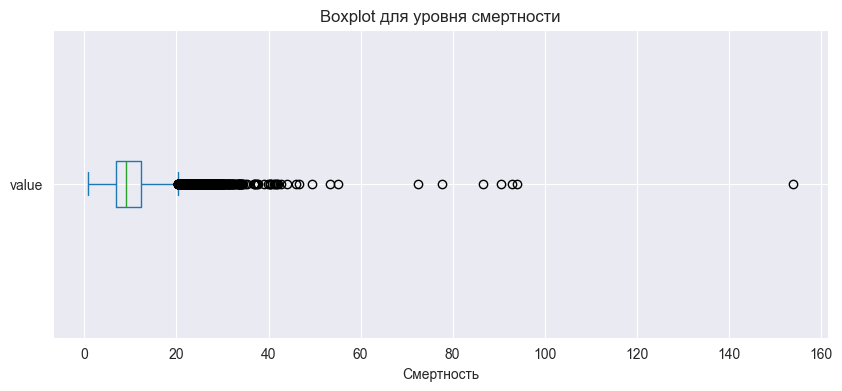

In [74]:
plt.figure(figsize=(10, 4))
df_3['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для уровня смертности')
plt.xlabel('Смертность')
plt.show()

Обнаружены явные выбросы при 99 квантиле равном 28 наличие значений в 160 явно отклонение, однако есть эпидемии войны и тд, сложно вот так с ходу назвать уровень адекватности, ограничим, во всяком случае поиска исторических закономерностей для таких больших значений, в 1994 году в Руанде был геноцид где погибло около 80к населения заа 100 дней, также в 1975–1979 в Камбодже был кризис

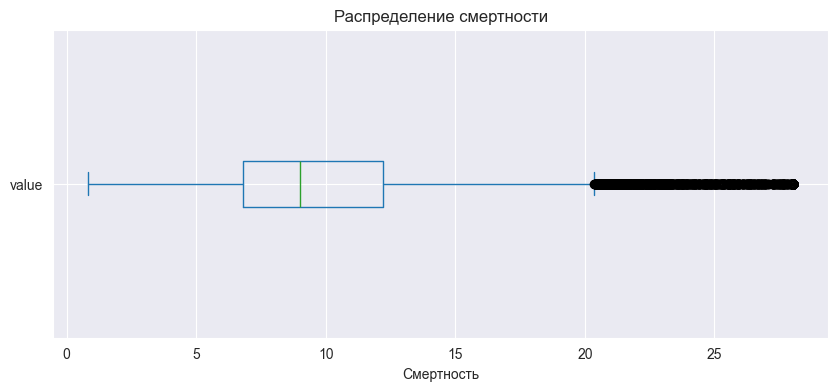

In [75]:
filt = df_3['value'].quantile(0.99)

df_3['value'] = df_3['value'].apply(lambda x: filt if x > filt else x)
plt.figure(figsize=(10, 4))
df_3['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение смертности')
plt.xlabel('Смертность')
plt.show()

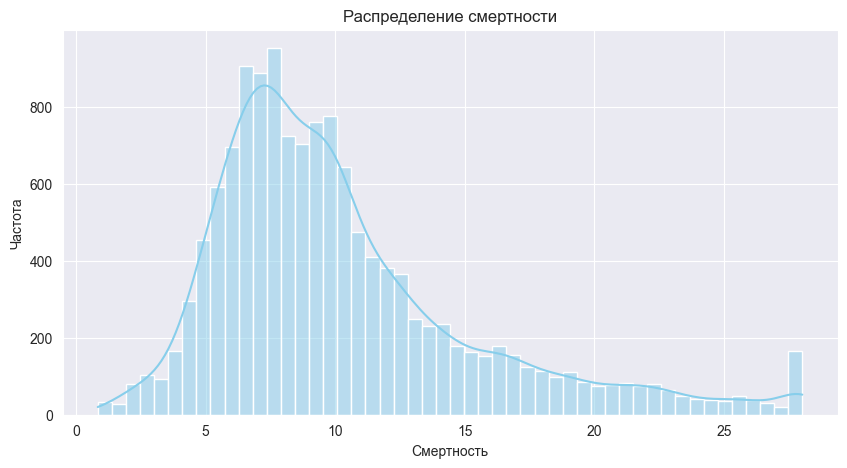

In [76]:
plt.figure(figsize=(10,5))
sns.histplot(df_3['value'].dropna(), bins=50, kde=True, color='skyblue')
plt.title('Распределение смертности')
plt.xlabel('Смертность')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

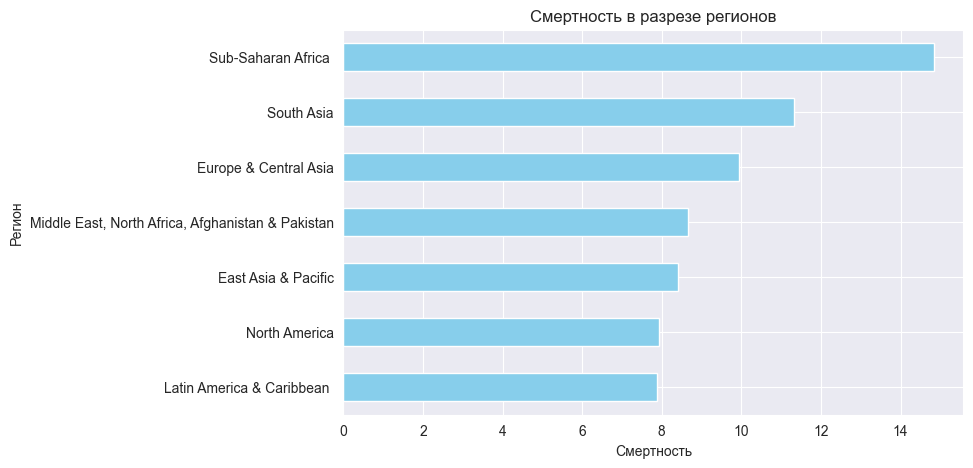

In [77]:
df_3_region = df_3.groupby(['region_value'])['value'].mean().sort_values()

df_3_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Смертность в разрезе регионов')
plt.xlabel('Смертность')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

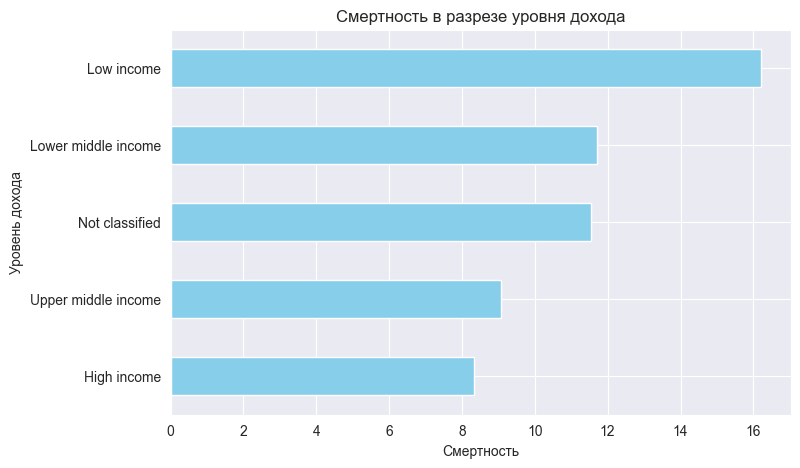

In [78]:
df_3_i_level = df_3.groupby(['income_level_value'])['value'].mean().sort_values()

df_3_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Смертность в разрезе уровня дохода')
plt.xlabel('Смертность')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

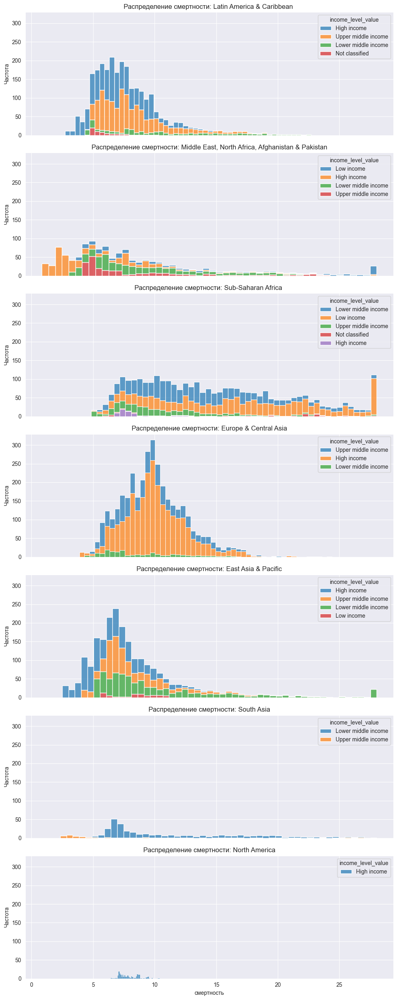

In [79]:
regions = df_3['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_3[df_3['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение смертности: {region}')
    ax.set_xlabel('смертность')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

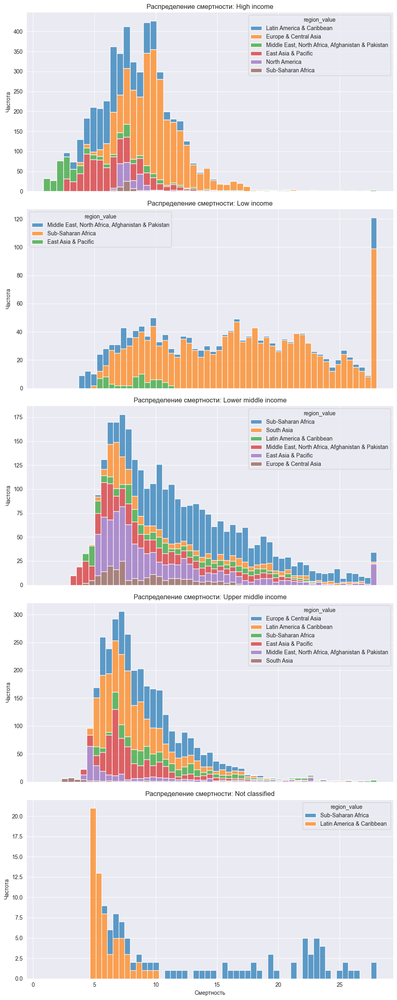

In [80]:
income_level = df_3['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_3[df_3['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение смертности: {i_l}')
    ax.set_xlabel('Смертность')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

### Промежуточные выводы
В среднем смертность лежит где-то от 1 до 25 промили
Есть зависимость смертности от уровня дохода, чем он выше тем она меньше.
При этом интересное замечание, что европа один из лидеров по смертности, возможно это из-за высокого уровня развития пожилого населения и смертность от естественных причин больше, в среднем это значения от 5-10, больше значения могут свидетельствовать о конфликтах, смертности и эпидемиях, это редкость для Европы, или северной америки, тогда как распределение африки размазано. То есть на временном промежутке для данного региона этот показатель чаще переваливает в зону повышенных значений смертности если сравнивать с остальным миром, больший разброс  - показатель неблагополучия и более высокой смертности. То же можно сказать про Южную азию

Сейчас мы отфильтровали данные о смертности, скорее ограничили возможные значения, однако в дальнейшем анализе возможно будем использовать, тк это не ошибка, а исторический экстремум

## SP.POP.GROW - Прирост населения

In [81]:
df_4 = deepcopy(df[df['indicator_id'] == 'SP.POP.GROW'])

In [82]:
df_4['value'].describe()

count    13504.000000
mean         1.752671
std          1.800039
min        -27.470786
25%          0.675593
50%          1.688514
75%          2.676841
max         21.700343
Name: value, dtype: float64

In [83]:
display(df_4.sort_values(by='value', ascending=False).tail(5))
display(df_4.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
78815,LBR,SP.POP.GROW,1991,-12.799127,LBR,LR,Liberia,Monrovia,-10.7957,6.30039,...,ZG,Sub-Saharan Africa,XM,Low income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
118370,RWA,SP.POP.GROW,1994,-16.128298,RWA,RW,Rwanda,Kigali,30.0587,-1.95325,...,ZG,Sub-Saharan Africa,XM,Low income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
118371,RWA,SP.POP.GROW,1995,-17.988214,RWA,RW,Rwanda,Kigali,30.0587,-1.95325,...,ZG,Sub-Saharan Africa,XM,Low income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
76639,KWT,SP.POP.GROW,1991,-22.051779,KWT,KW,Kuwait,Kuwait City,47.9824,29.3721,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
76638,KWT,SP.POP.GROW,1990,-27.470786,KWT,KW,Kuwait,Kuwait City,47.9824,29.3721,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
116079,QAT,SP.POP.GROW,2007,21.700343,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
76640,KWT,SP.POP.GROW,1992,19.047860,KWT,KW,Kuwait,Kuwait City,47.9824,29.3721,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
85079,MAF,SP.POP.GROW,1983,19.038182,MAF,MF,St. Martin (French part),Marigot,N/F,N/F,...,ZJ,Latin America & Caribbean,XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
4169,ARE,SP.POP.GROW,1969,18.382816,ARE,AE,United Arab Emirates,Abu Dhabi,54.3705,24.4764,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2
85080,MAF,SP.POP.GROW,1984,17.875986,MAF,MF,St. Martin (French part),Marigot,N/F,N/F,...,ZJ,Latin America & Caribbean,XD,High income,SP.POP.GROW,Population growth (annual %),N/F,Annual population growth rate for year t is th...,"World Population Prospects, United Nations (UN...",2


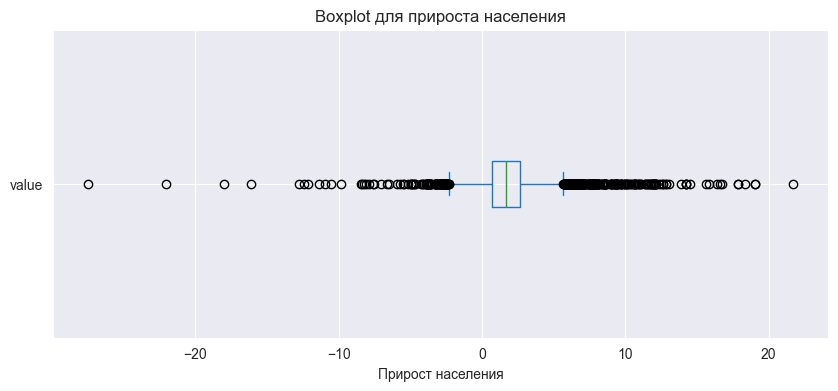

In [84]:
plt.figure(figsize=(10, 4))
df_4['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для прироста населения')
plt.xlabel('Прирост населения')
plt.show()

In [85]:
display(df_4['value'].quantile(0.01))
display(df_4['value'].quantile(0.99))

np.float64(-1.9714743289605046)

np.float64(7.542214955497402)

Ну собственно также есть резкие скачки как вверх так и вниз для этого показателя, все значимые скачки исторически соотв разным периодам высока активной миграции, ниже мы заменим на пороговое по квантилям, чтобы посмотреть на распределение, это явно выбросы, но не ошибочные

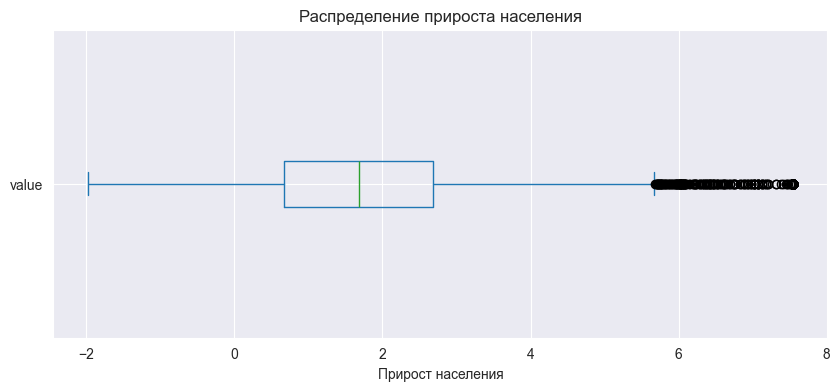

In [86]:
filt_1 = df_4['value'].quantile(0.99)
filt_2 = df_4['value'].quantile(0.01)

df_4['value'] = df_4['value'].apply(lambda x: filt_1 if x > filt_1 else (filt_2 if x < filt_2 else x))
plt.figure(figsize=(10, 4))
df_4['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение прироста населения')
plt.xlabel('Прирост населения')
plt.show()

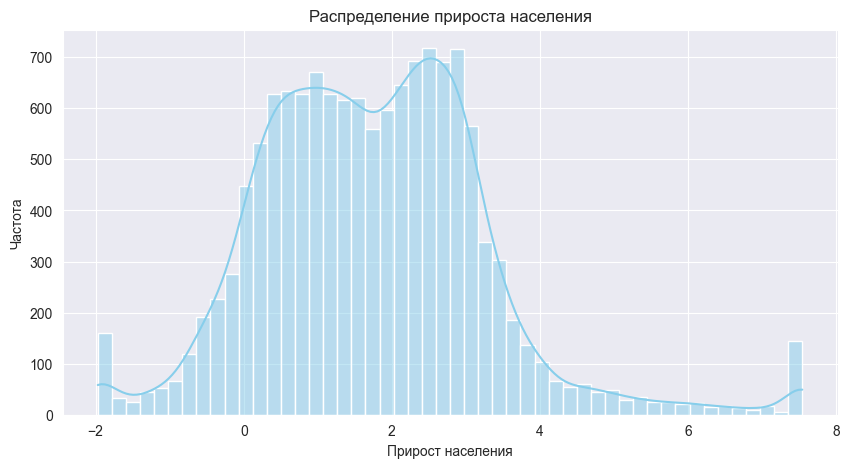

In [87]:
plt.figure(figsize=(10,5))
sns.histplot(df_4['value'], bins=50, kde=True, color='skyblue')
plt.title('Распределение прироста населения')
plt.xlabel('Прирост населения')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

Заметим два пика очень похоже на распределение рождаемости

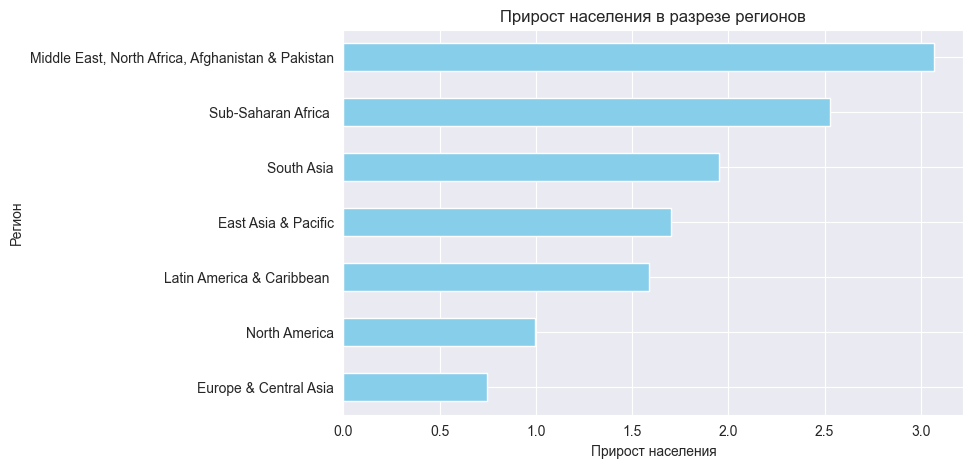

In [88]:
df_4_region = df_4.groupby(['region_value'])['value'].mean().sort_values()

df_4_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Прирост населения в разрезе регионов')
plt.xlabel('Прирост населения')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

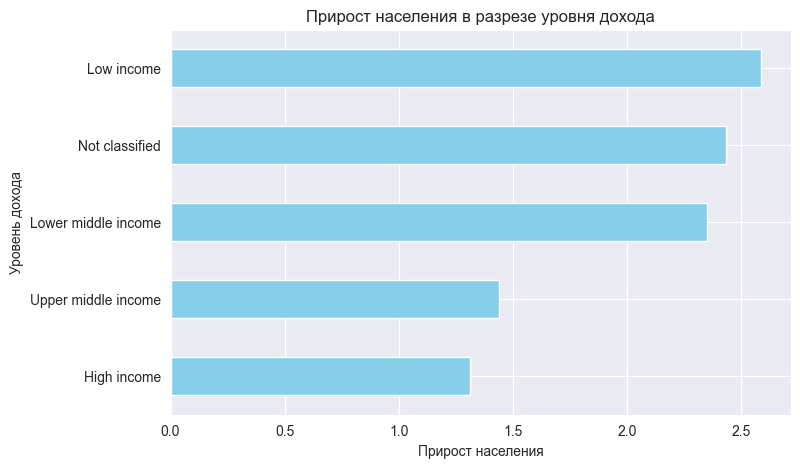

In [89]:
df_4_i_level = df_4.groupby(['income_level_value'])['value'].mean().sort_values()

df_4_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Прирост населения в разрезе уровня дохода')
plt.xlabel('Прирост населения')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

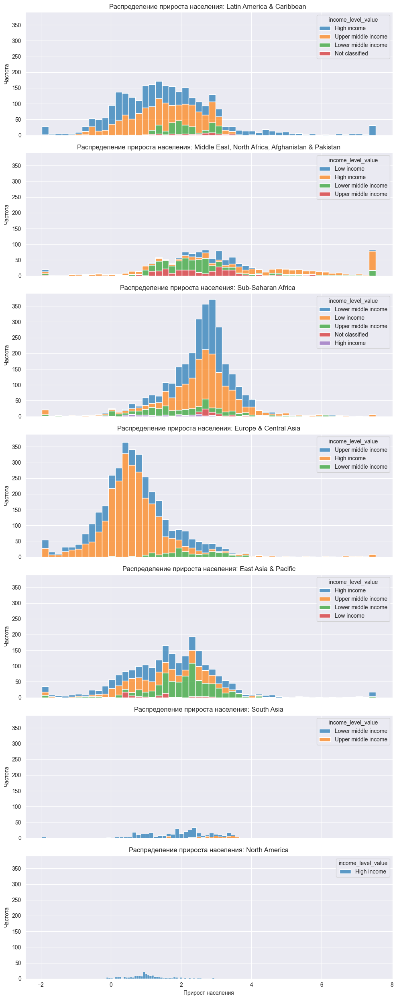

In [90]:
regions = df_4['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_4[df_4['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение прироста населения: {region}')
    ax.set_xlabel('Прирост населения')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

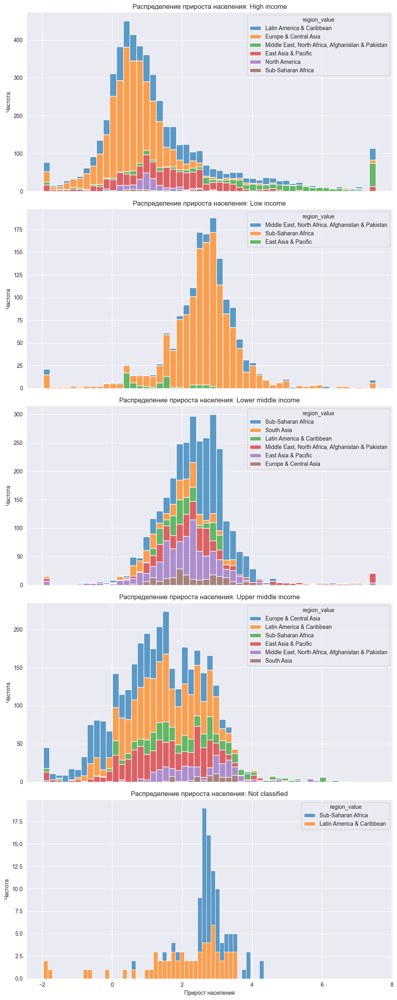

In [91]:
income_level = df_4['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_4[df_4['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение прироста населения: {i_l}')
    ax.set_xlabel('Прирост населения')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

###  Промежуточные выводы

Похоже на распределение смертности. Заметим что в общем вне зависимости от региона уровня дохода прирост населения в среднем положительный, однако есть предположение что для регионов с большим доходом, он скорее вызван миграциями (уровень рождаемости низкий, при этом уровень смертности не самый низкий) и колеблется навскидку от 0 до 2.
Для более бедных регинов в среднем прирост населения больше, что скорее связано с высокой рождаемостью, причем мера разброса по видам графиков, а также по кол-ву экстремальных значений для каждого из региона, регионы с низким уровнем дохода имеют больший размах колебаний, и он больше для регионов известными яркими военными конфликтами и другими катастрофами

## SP.DYN.IMRT.IN - Детская смертность

In [92]:
df_5 = deepcopy(df[df['indicator_id'] == 'SP.DYN.IMRT.IN'])

In [93]:
df_5['value'].describe()


count    12416.000000
mean        51.817896
std         47.182657
min          1.400000
25%         14.600000
50%         36.100000
75%         78.000000
max        472.500000
Name: value, dtype: float64

In [94]:
display(df_5.sort_values(by='value', ascending=False).tail(5))
display(df_5.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
44735,EST,SP.DYN.IMRT.IN,2023,1.6,EST,EE,Estonia,Tallinn,24.7586,59.4392,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
124284,SMR,SP.DYN.IMRT.IN,2020,1.5,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
124285,SMR,SP.DYN.IMRT.IN,2021,1.5,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
124287,SMR,SP.DYN.IMRT.IN,2023,1.4,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
124286,SMR,SP.DYN.IMRT.IN,2022,1.4,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
126492,SSD,SP.DYN.IMRT.IN,1988,472.5,SSD,SS,South Sudan,Juba,31.6,4.85,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
124960,SOM,SP.DYN.IMRT.IN,1992,274.0,SOM,SO,"Somalia, Fed. Rep.",Mogadishu,45.3254,2.07515,...,ZG,Sub-Saharan Africa,XM,Low income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
152704,YEM,SP.DYN.IMRT.IN,1960,272.8,YEM,YE,"Yemen, Rep.",Sana'a,44.2075,15.352,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XM,Low income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
152705,YEM,SP.DYN.IMRT.IN,1961,270.4,YEM,YE,"Yemen, Rep.",Sana'a,44.2075,15.352,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XM,Low income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2
152706,YEM,SP.DYN.IMRT.IN,1962,267.9,YEM,YE,"Yemen, Rep.",Sana'a,44.2075,15.352,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XM,Low income,SP.DYN.IMRT.IN,"Mortality rate, infant (per 1,000 live births)",N/F,Infant mortality rate is the number of infants...,UN Inter-agency Group for Child Mortality Esti...,2


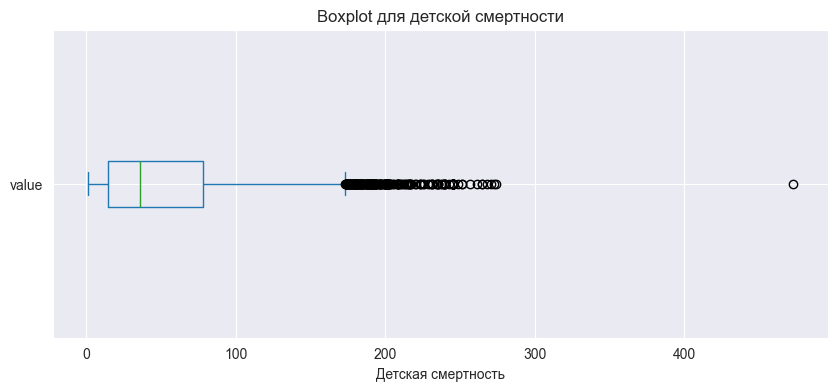

In [95]:
plt.figure(figsize=(10, 4))
df_5['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для детской смертности')
plt.xlabel('Детская смертность')
plt.show()

In [96]:
display(df_5['value'].quantile(0.01))
display(df_5['value'].quantile(0.99))

np.float64(2.3)

np.float64(199.08500000000004)

Ну явно видно, что есть экстремальные значения детской смертности превышающие 200, особенно 470 детей на 1000 умирало, отфильтруем по пороговому значению

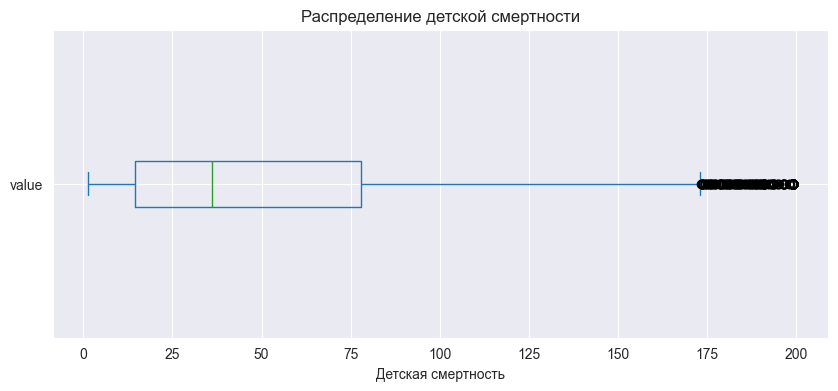

In [97]:
filt = df_5['value'].quantile(0.99)

df_5['value'] = df_5['value'].apply(lambda x: filt if x > filt else x)
plt.figure(figsize=(10, 4))
df_5['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение детской смертности')
plt.xlabel('Детская смертность')
plt.show()

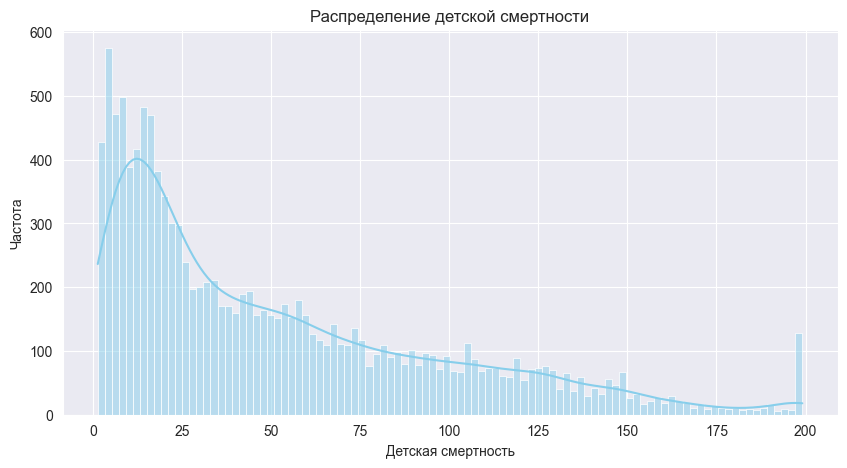

In [98]:
plt.figure(figsize=(10,5))
sns.histplot(df_5['value'], bins=100, kde=True, color='skyblue')
plt.title('Распределение детской смертности')
plt.xlabel('Детская смертность')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

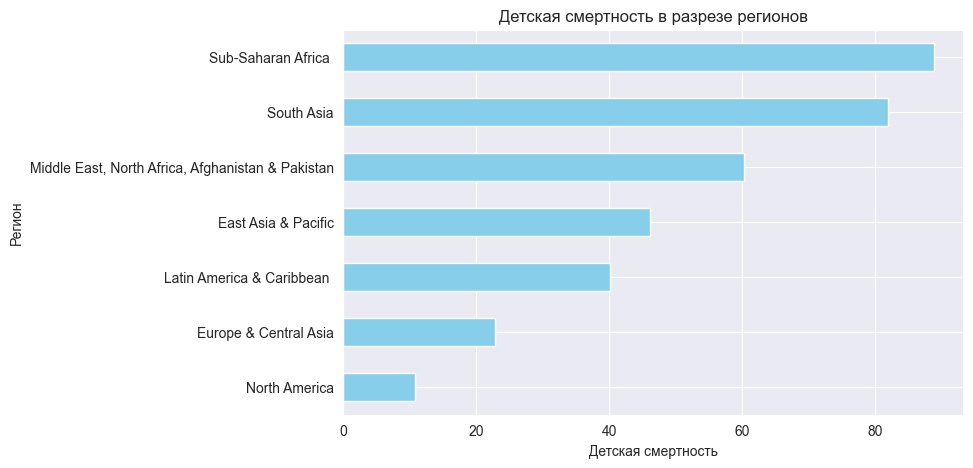

In [99]:
df_5_region = df_5.groupby(['region_value'])['value'].mean().sort_values()

df_5_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Детская смертность в разрезе регионов')
plt.xlabel('Детская смертность')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

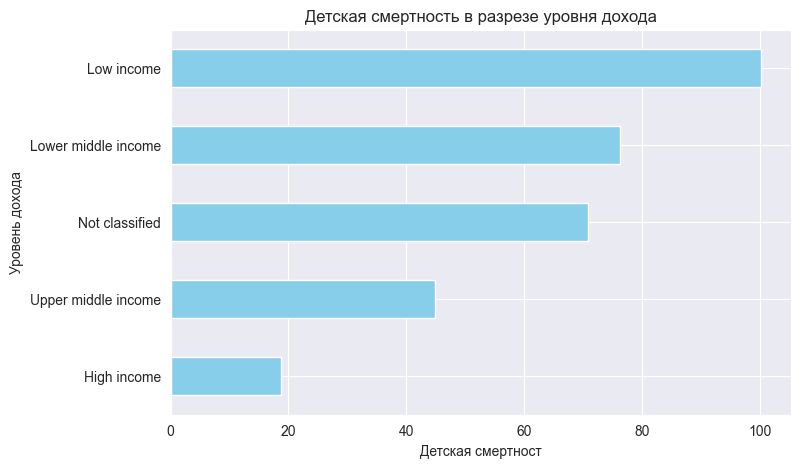

In [100]:
df_5_i_level = df_5.groupby(['income_level_value'])['value'].mean().sort_values()

df_5_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Детская смертность в разрезе уровня дохода')
plt.xlabel('Детская смертност')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

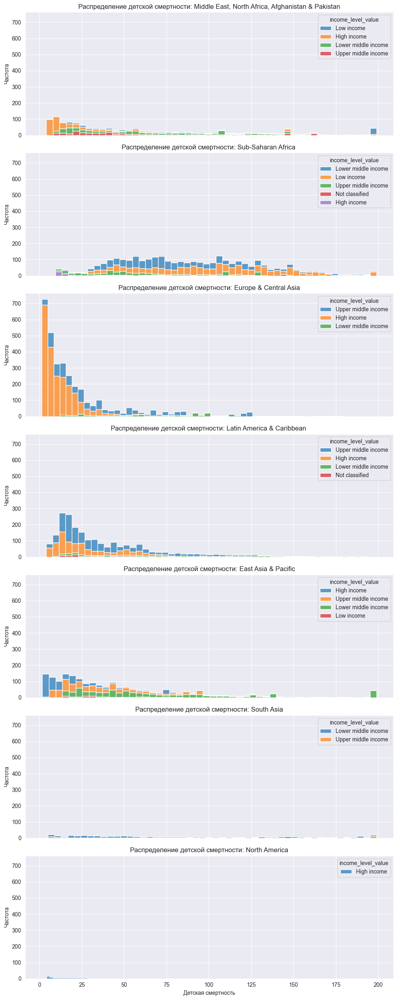

In [101]:
regions = df_5['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_5[df_5['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение детской смертности: {region}')
    ax.set_xlabel('Детская смертность')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

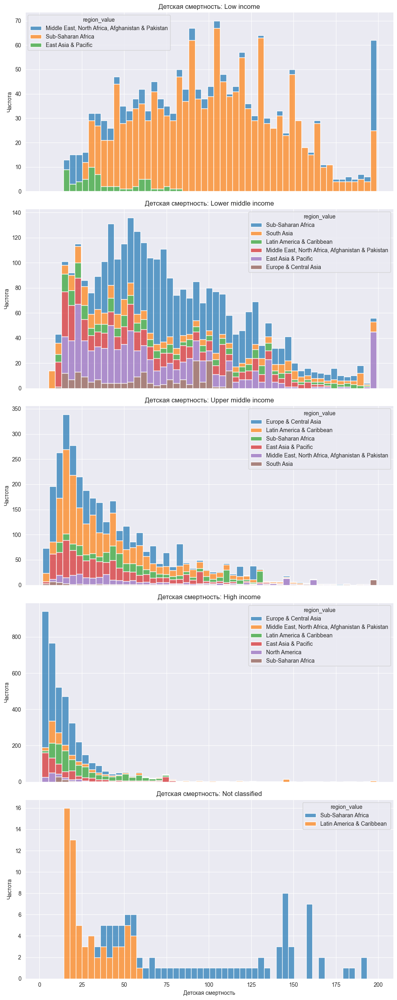

In [102]:
income_level = df_5['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_5[df_5['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Детская смертность: {i_l}')
    ax.set_xlabel('Детская смертность')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

### Промежуточные выводы

Как и ожидалось регионы с более развитыми странами имеют в среднем более низкую детскую смертность, также страны с большим уровнем дохода, имеют более низкие показатели детской смертности.
Концентрация в регионе стран с более высоким уровнем дохода не сильно снижает разброс величины в разрезе именно уровня дохода в регионе - синергия не выявлена. Есть лишь регион Sub-Sharan Africa распределения которой выбиваются в разрезе категория низкого дохода и ниже среднего от остальных регионов, здесь есь еще и корреляция непосредственно с самим регионом
Также в зависимости от уровня дохода рапределение смещается вправо
Есть ряд экстремальных значений, некоторые похожи на выбросы и характерны для бедных стран

## NY.GDP.PCAP.CD - ВВП

In [103]:
df_6 = deepcopy(df[df['indicator_id'] == 'NY.GDP.PCAP.CD'])

In [104]:
df_6['value'].describe()

count     13376.000000
mean       8841.013050
std       17883.420893
min          11.801322
25%         605.798145
50%        1937.680307
75%        8267.274981
max      256580.515123
Name: value, dtype: float64

In [105]:
display(df_6.sort_values(by='value', ascending=False).tail(5))
display(df_6.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
92746,MMR,NY.GDP.PCAP.CD,1970,20.724278,MMR,MM,Myanmar,Naypyidaw,95.9562,21.914,...,Z4,East Asia & Pacific,XN,Lower middle income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
92740,MMR,NY.GDP.PCAP.CD,1964,17.332201,MMR,MM,Myanmar,Naypyidaw,95.9562,21.914,...,Z4,East Asia & Pacific,XN,Lower middle income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
92743,MMR,NY.GDP.PCAP.CD,1967,16.545381,MMR,MM,Myanmar,Naypyidaw,95.9562,21.914,...,Z4,East Asia & Pacific,XN,Lower middle income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
92741,MMR,NY.GDP.PCAP.CD,1965,15.117863,MMR,MM,Myanmar,Naypyidaw,95.9562,21.914,...,Z4,East Asia & Pacific,XN,Lower middle income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
92742,MMR,NY.GDP.PCAP.CD,1966,11.801322,MMR,MM,Myanmar,Naypyidaw,95.9562,21.914,...,Z4,East Asia & Pacific,XN,Lower middle income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
86015,MCO,NY.GDP.PCAP.CD,2023,256580.515123,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
86014,MCO,NY.GDP.PCAP.CD,2022,226052.001905,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
86013,MCO,NY.GDP.PCAP.CD,2021,223823.363960,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
80575,LIE,NY.GDP.PCAP.CD,2023,207973.617747,LIE,LI,Liechtenstein,Vaduz,9.52148,47.1411,...,Z7,Europe & Central Asia,XD,High income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2
86000,MCO,NY.GDP.PCAP.CD,2008,204263.797114,MCO,MC,Monaco,Monaco,7.41891,43.7325,...,Z7,Europe & Central Asia,XD,High income,NY.GDP.PCAP.CD,GDP per capita (current US$),N/F,Gross domestic product is the total income ear...,"Country official statistics, National Statisti...",2


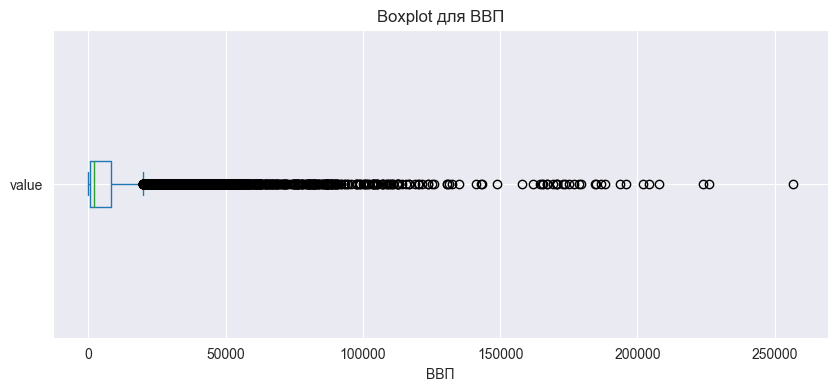

In [106]:
plt.figure(figsize=(10, 4))
df_6['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для ВВП')
plt.xlabel('ВВП')
plt.show()

Ну здесь нужно понимать что это ВВП на душу населения, для стран с высокой экономикой и малым населением хороший пример Монако это цифра улетает в небеса, нельзя отсечь эти данные в целом можно логарифмировать однако посмотрим в разрезе групп стран по уровню дохода

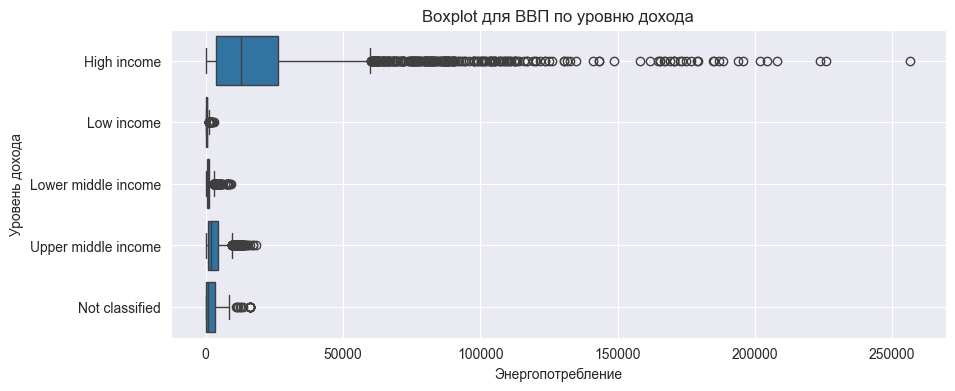

In [107]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='income_level_value', data=df_6, orient='h')
plt.xlabel('Энергопотребление')
plt.ylabel('Уровень дохода')
plt.title('Boxplot для ВВП по уровню дохода')
plt.grid(True)
plt.show()

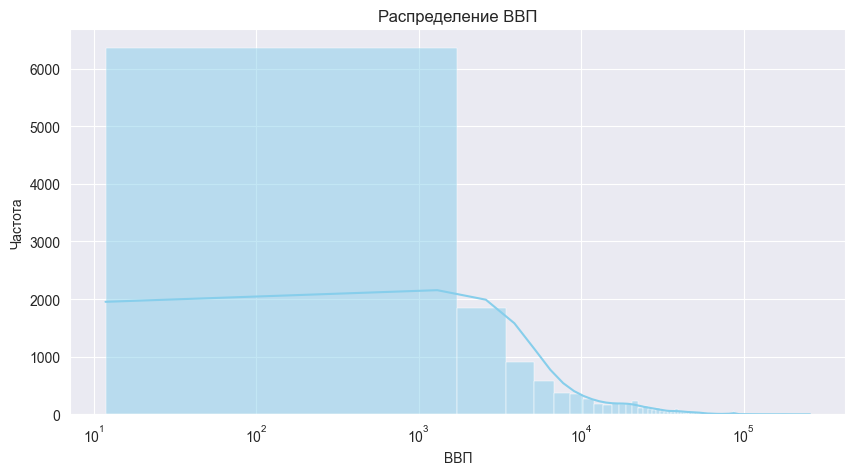

In [108]:
plt.figure(figsize=(10,5))
sns.histplot(df_6['value'], bins=150, kde=True, color='skyblue')
plt.title('Распределение ВВП')
plt.xlabel('ВВП')
plt.ylabel('Частота')
plt.xscale('log')
plt.grid(True)
plt.show()

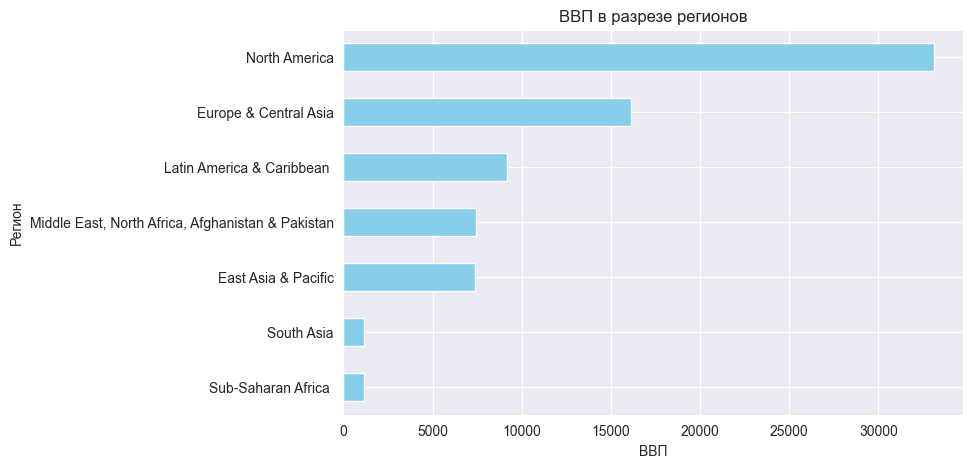

In [109]:
df_6_region = df_6.groupby(['region_value'])['value'].mean().sort_values()

df_6_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('ВВП в разрезе регионов')
plt.xlabel('ВВП')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

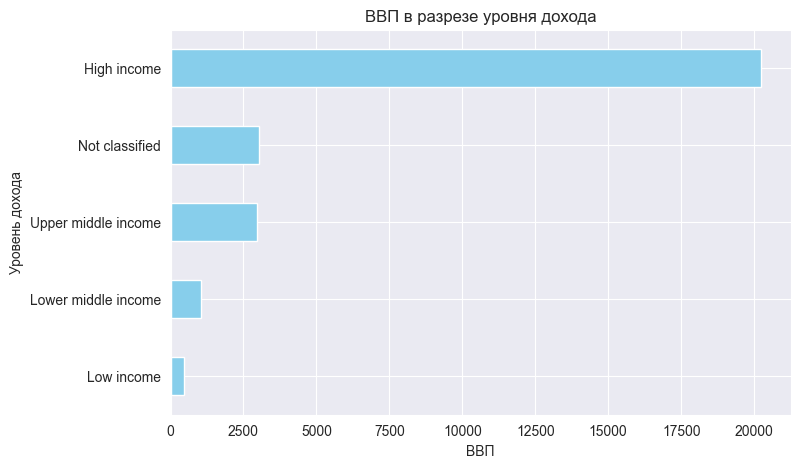

In [110]:
df_6_i_level = df_6.groupby(['income_level_value'])['value'].mean().sort_values()

df_6_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('ВВП в разрезе уровня дохода')
plt.xlabel('ВВП')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

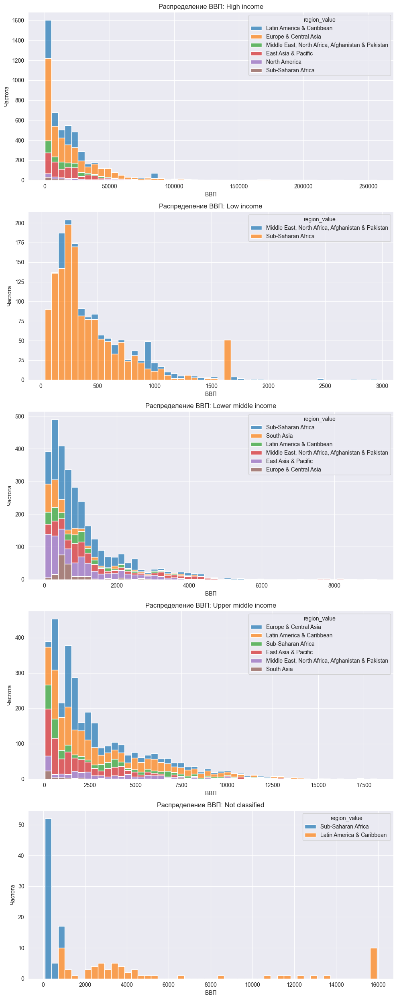

In [111]:
income_level = df_6['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=False, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_6[df_6['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение ВВП: {i_l}')
    ax.set_xlabel('ВВП')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

### Промежуточные выводы
Видно, что форма распределения ВВП внутри групп по уровню дохода не зависит от региона, ВВП напрямую связан с уровнем дохода, особое внимание странам в Not classified, однако к этому вернемся позже, сильно заметна разница в масштабах для разного уровня дохода - высокое неравенство

Было принято не проводить фильтрацию хвостов (также и в разрезе каждой из категории доходов) дабыы не искажать данные сильно,

## NE.TRD.GNFS.ZS - Торговвля

In [112]:
df_7 = deepcopy(df[df['indicator_id'] == 'NE.TRD.GNFS.ZS'])


In [113]:
df_7['value'].describe()


count    12160.000000
mean        82.135197
std         55.752957
min          0.020999
25%         46.709895
50%         70.311044
75%        101.414331
max        863.195099
Name: value, dtype: float64

In [114]:
display(df_7.sort_values(by='value', ascending=False).tail(5))
display(df_7.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
66144,IRQ,NE.TRD.GNFS.ZS,1992,1.921146,IRQ,IQ,Iraq,Baghdad,44.394,33.3302,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XT,Upper middle income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
66145,IRQ,NE.TRD.GNFS.ZS,1993,0.544697,IRQ,IQ,Iraq,Baghdad,44.394,33.3302,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XT,Upper middle income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
66146,IRQ,NE.TRD.GNFS.ZS,1994,0.099582,IRQ,IQ,Iraq,Baghdad,44.394,33.3302,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XT,Upper middle income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
66148,IRQ,NE.TRD.GNFS.ZS,1996,0.026888,IRQ,IQ,Iraq,Baghdad,44.394,33.3302,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XT,Upper middle income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
66147,IRQ,NE.TRD.GNFS.ZS,1995,0.020999,IRQ,IQ,Iraq,Baghdad,44.394,33.3302,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XT,Upper middle income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
148848,VIR,NE.TRD.GNFS.ZS,2008,863.195099,VIR,VI,Virgin Islands (U.S.),Charlotte Amalie,-64.8963,18.3358,...,ZJ,Latin America & Caribbean,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
148851,VIR,NE.TRD.GNFS.ZS,2011,679.232773,VIR,VI,Virgin Islands (U.S.),Charlotte Amalie,-64.8963,18.3358,...,ZJ,Latin America & Caribbean,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
148850,VIR,NE.TRD.GNFS.ZS,2010,586.401480,VIR,VI,Virgin Islands (U.S.),Charlotte Amalie,-64.8963,18.3358,...,ZJ,Latin America & Caribbean,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
148847,VIR,NE.TRD.GNFS.ZS,2007,560.367893,VIR,VI,Virgin Islands (U.S.),Charlotte Amalie,-64.8963,18.3358,...,ZJ,Latin America & Caribbean,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2
148846,VIR,NE.TRD.GNFS.ZS,2006,552.118644,VIR,VI,Virgin Islands (U.S.),Charlotte Amalie,-64.8963,18.3358,...,ZJ,Latin America & Caribbean,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2


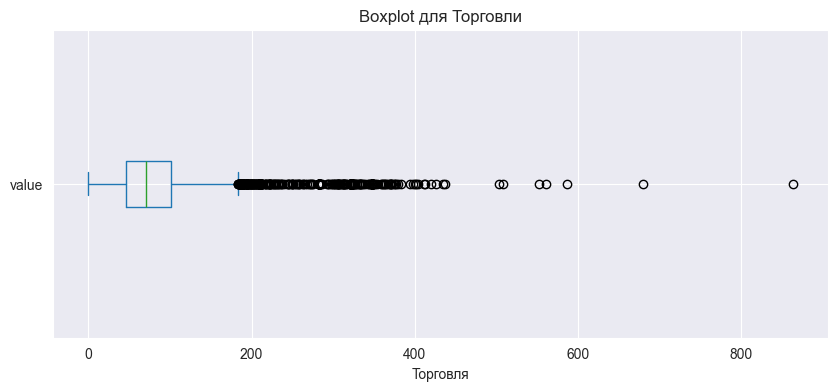

In [115]:
plt.figure(figsize=(10, 4))
df_7['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для Торговли')
plt.xlabel('Торговля')
plt.show()

In [116]:
display(df_7['value'].quantile(0.01))
display(df_7['value'].quantile(0.99))


np.float64(12.5744954171822)

np.float64(321.364013420909)

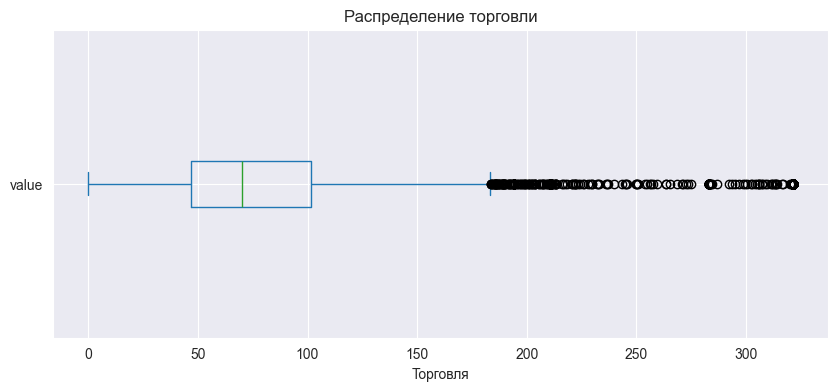

In [117]:
filt = df_7['value'].quantile(0.99)

df_7['value'] = df_7['value'].apply(lambda x: filt if x > filt else x)
plt.figure(figsize=(10, 4))
df_7['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение торговли')
plt.xlabel('Торговля')
plt.show()

Есть значения очень похожие на выбросы, однако все объясняется структурой экономики маленьких стран не хочется фильтровать как и с ВВП, хочется найти взаимосвязь с географией, однако сильно снижается читабельность все таки отфильтруем (возможно следовало произвести фильтрацию внутри категории дохода

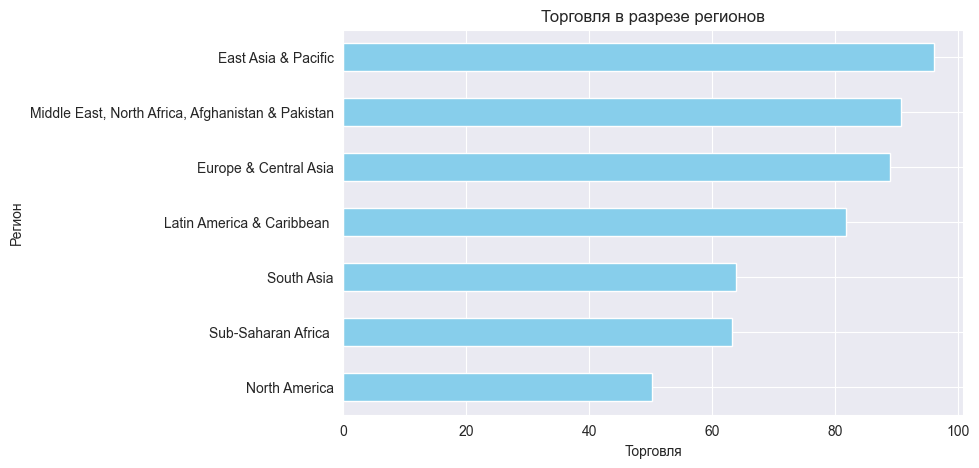

In [118]:
df_7_region = df_7.groupby(['region_value'])['value'].mean().sort_values()

df_7_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Торговля в разрезе регионов')
plt.xlabel('Торговля')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

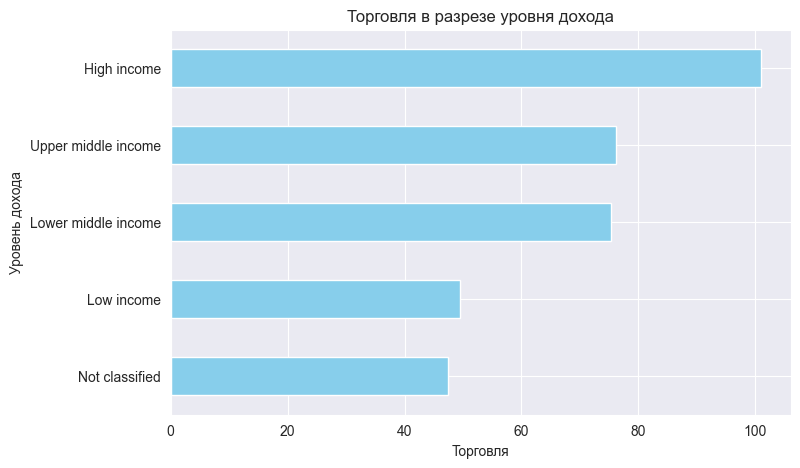

In [119]:
df_7_i_level = df_7.groupby(['income_level_value'])['value'].mean().sort_values()

df_7_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Торговля в разрезе уровня дохода')
plt.xlabel('Торговля')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

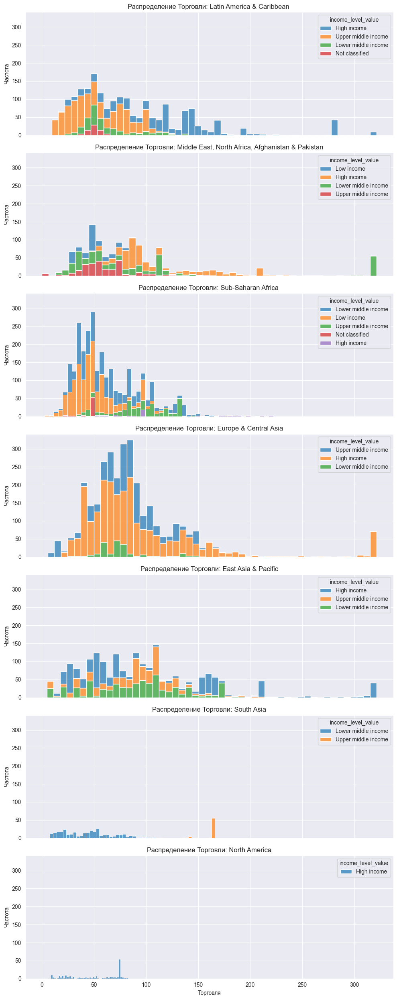

In [120]:
regions = df_7['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_7[df_7['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение Торговли: {region}')
    ax.set_xlabel('Торговля')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

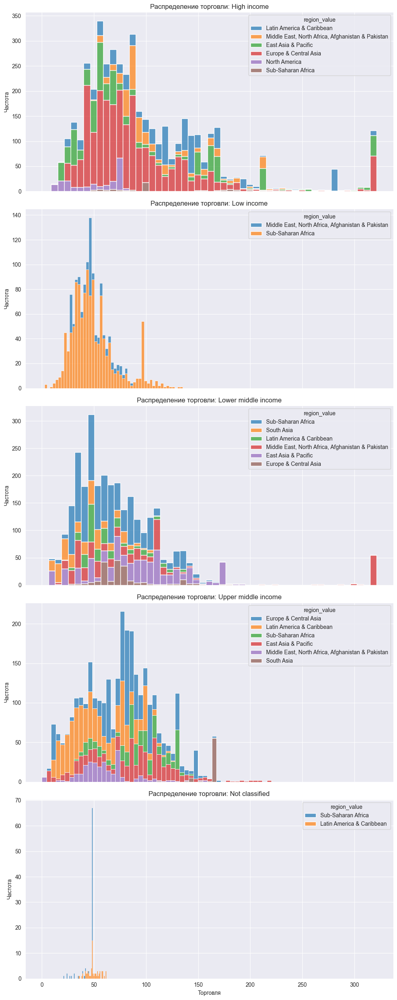

In [121]:
income_level = df_7['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_7[df_7['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение торговли: {i_l}')
    ax.set_xlabel('Торговля')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [122]:
df_7 = deepcopy(df[df['indicator_id'] == 'NE.TRD.GNFS.ZS'])

### Промежуточные выводы

 Были выявлены и отфильтрованы выбросы, однако хочется отметить то что это не ошибки, а скорее особенности вычисления этого показателя (это островные страны, маленькие страны живущие только торговлей и ничего не производящие) не свосем корректно их фильтровать но для лучшей читаемости разведочного анализа это было сделано. Дальге мы будеем использоваать полный набор данных
 Есть корреляция с уровнем дохода чем выше уровень дохода тем больше этот показатель богатые страны много продают. Однако хочется отметить корреляцию с регионом, например регион куда входят малые островные гос-ва, даже для стран этого региона с меньшим уровнем дохода характерны больше значения этого параметра. При этом для Африки обратный эффект, ем меньше уровень дохода тем меньше показатель в сравнении со странами из других регионов в той же категории дохода
 Также северная америка имеет более низкий показатель. То есть на торговлю напрямую влияет география региона, моря - большая торговля, огромные участки континента, пустыня меньший показатель

## EG.USE.PCAP.KG.OE - Энергопотребление

In [123]:
df_8 = deepcopy(df[df['indicator_id'] == 'EG.USE.PCAP.KG.OE'])

In [124]:
df_8['value'].describe()

count    11264.000000
mean      2018.001432
std       2599.337457
min          0.000000
25%        402.070945
50%        921.477199
75%       2671.369629
max      21557.475076
Name: value, dtype: float64

In [125]:
display(df_8.sort_values(by='value', ascending=False).tail(45))
display(df_8.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
81777,LSO,EG.USE.PCAP.KG.OE,2009,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81789,LSO,EG.USE.PCAP.KG.OE,2021,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81788,LSO,EG.USE.PCAP.KG.OE,2020,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81787,LSO,EG.USE.PCAP.KG.OE,2019,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81786,LSO,EG.USE.PCAP.KG.OE,2018,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81782,LSO,EG.USE.PCAP.KG.OE,2014,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81783,LSO,EG.USE.PCAP.KG.OE,2015,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81784,LSO,EG.USE.PCAP.KG.OE,2016,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81785,LSO,EG.USE.PCAP.KG.OE,2017,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
81790,LSO,EG.USE.PCAP.KG.OE,2022,9.727288,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
115436,QAT,EG.USE.PCAP.KG.OE,2004,21557.475076,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
115444,QAT,EG.USE.PCAP.KG.OE,2012,21456.066928,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
115445,QAT,EG.USE.PCAP.KG.OE,2013,20642.142323,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
115437,QAT,EG.USE.PCAP.KG.OE,2005,20198.168905,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
115438,QAT,EG.USE.PCAP.KG.OE,2006,20140.342875,QAT,QA,Qatar,Doha,51.5082,25.2948,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2


In [126]:
df_8.groupby('income_level_value')['value'].describe()

,count,mean,std,min,25%,50%,75%,max
income_level_value,,,,,,,,
High income,3776.0,4354.224831,3234.204137,509.519852,2220.471715,3597.301053,5451.718823,21557.475076
Low income,1088.0,367.462156,307.825426,58.587025,172.693031,302.751273,444.007649,1573.595297
Lower middle income,2880.0,452.427031,371.764495,0.000000,268.258896,359.542085,543.479175,2315.798305
Not classified,128.0,1209.642846,867.573805,360.759293,368.247987,745.439864,1997.564791,2648.886525
Upper middle income,3392.0,1306.483551,1027.890000,77.368023,601.148261,954.708481,1637.466498,5625.645237


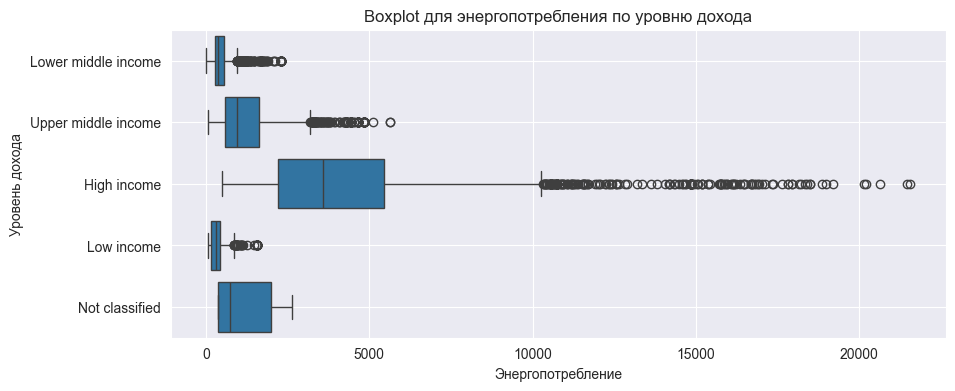

In [127]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='income_level_value', data=df_8, orient='h')
plt.xlabel('Энергопотребление')
plt.ylabel('Уровень дохода')
plt.title('Boxplot для энергопотребления по уровню дохода')
plt.grid(True)
plt.show()

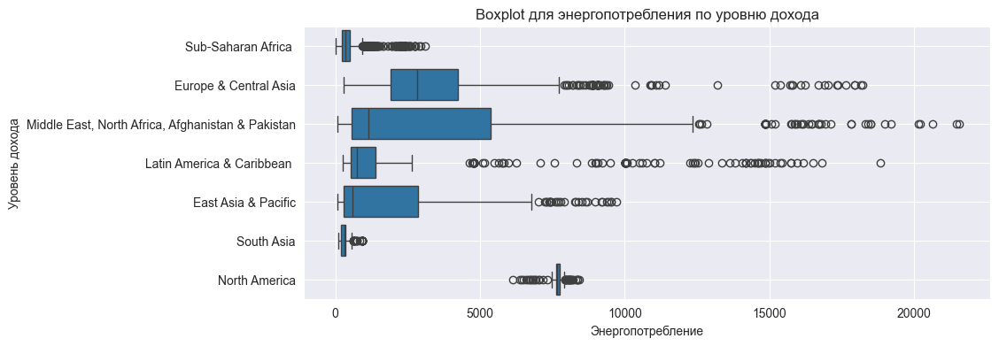

In [128]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='region_value', data=df_8, orient='h')
plt.xlabel('Энергопотребление')
plt.ylabel('Уровень дохода')
plt.title('Boxplot для энергопотребления по уровню дохода')
plt.grid(True)
plt.show()

Как раз таки один из тех показателей, который сильно зависит от уровня развития нежели от региона, хотя география, скорее нефтедобывающая отрасль региона влияет на этот показатель

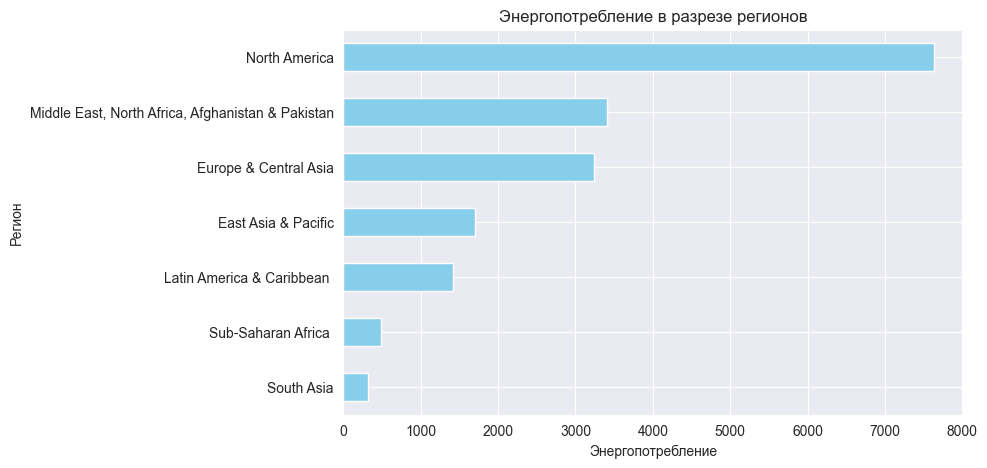

In [129]:
df_8_region = df_8.groupby(['region_value'])['value'].mean().sort_values()

df_8_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Энергопотребление в разрезе регионов')
plt.xlabel('Энергопотребление')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

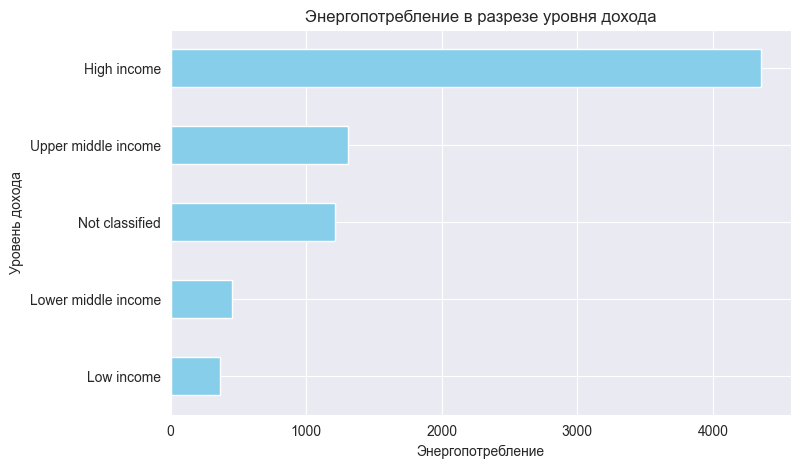

In [130]:
df_8_i_level = df_8.groupby(['income_level_value'])['value'].mean().sort_values()

df_8_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('Энергопотребление в разрезе уровня дохода')
plt.xlabel('Энергопотребление')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

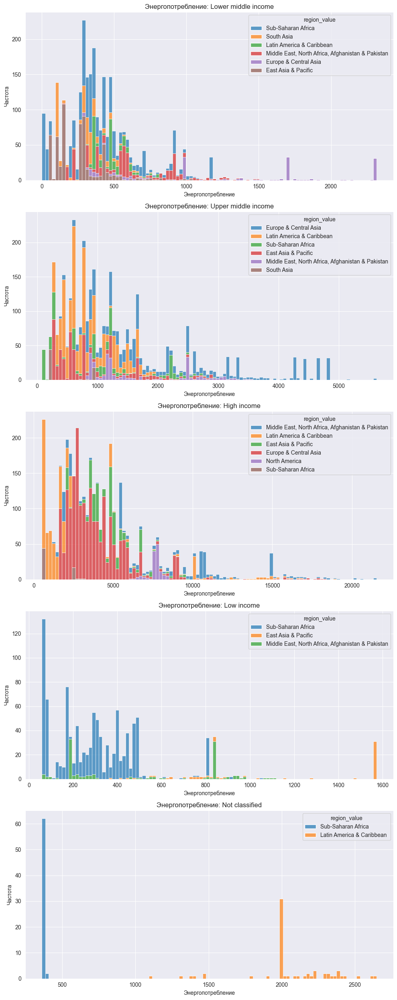

In [131]:
income_level = df_8['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=False, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_8[df_8['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=100,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Энергопотребление: {i_l}')
    ax.set_xlabel('Энергопотребление')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [132]:
display(df_8[df_8['name'] == 'Namibia'].sort_values(by='date').head(35))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
98816,NAM,EG.USE.PCAP.KG.OE,1960,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98817,NAM,EG.USE.PCAP.KG.OE,1961,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98818,NAM,EG.USE.PCAP.KG.OE,1962,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98819,NAM,EG.USE.PCAP.KG.OE,1963,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98820,NAM,EG.USE.PCAP.KG.OE,1964,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98821,NAM,EG.USE.PCAP.KG.OE,1965,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98822,NAM,EG.USE.PCAP.KG.OE,1966,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98823,NAM,EG.USE.PCAP.KG.OE,1967,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98824,NAM,EG.USE.PCAP.KG.OE,1968,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2
98825,NAM,EG.USE.PCAP.KG.OE,1969,0.000000,NAM,NA,Namibia,Windhoek,17.0931,-22.5648,...,ZG,Sub-Saharan Africa,XN,Lower middle income,EG.USE.PCAP.KG.OE,Energy use (kg of oil equivalent per capita),N/F,Energy use refers to use of primary energy bef...,"IEA Energy Statistics Data Browser, Internatio...",2


In [133]:
df_8.loc[(df_8['date'] >= 1960) & (df_8['date'] <= 1990), 'value'] = np.nan
df_8.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11264 entries, 1344 to 154559
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              11264 non-null  object 
 1   indicator_id            11264 non-null  object 
 2   date                    11264 non-null  int32  
 3   value                   5808 non-null   float64
 4   id                      11264 non-null  object 
 5   iso2_code               11264 non-null  object 
 6   name                    11264 non-null  object 
 7   capital_city            11264 non-null  object 
 8   longitude               11264 non-null  object 
 9   latitude                11264 non-null  object 
 10  region_id               11264 non-null  object 
 11  adminregion_id          11264 non-null  object 
 12  income_level_id         11264 non-null  object 
 13  lending_type_id         11264 non-null  object 
 14  region_iso2_code        11264 non-null 

### Промежуточные выводы
В первую очередь сложно отбросить выбросы такие явно имеются

В среденем страны с более высоким уровнем дохода имеют больший показатель
При этом лидеры по регионам - Севернаая америка, MENA и только потом Европа, по распределения имеют довольно высокий разброс, при этом часто особенно для MENA в разных категориях дохода видно двойные пики, MENA и Европа создают высокий разброс в разных категориях, Если для европы можно отметить страны с низким населением, что при делении может повышать показатель, то для MENA, думаю связано с географией и залежами природных ресурсов таких как нефть и развитие этой промышленности в этом регионе

Также мы привели к nan весь хвост от 1960-1990 полученый на этапе интерполяции, эти данные точно абсолютно бесполезны для анализа, с

## NV.AGR.TOTL.ZS - Сельское хозяйство

In [134]:
df_9 = deepcopy(df[df['indicator_id'] == 'NV.AGR.TOTL.ZS'])

In [135]:
df_9['value'].describe()

count    12928.000000
mean        15.540709
std         14.862940
min          0.000000
25%          3.728048
50%         10.827536
75%         24.114076
max         89.414510
Name: value, dtype: float64

In [136]:
display(df_9.sort_values(by='value', ascending=False).tail(25))
display(df_9.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
119,ABW,NV.AGR.TOTL.ZS,2015,0.012520,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,ZJ,Latin America & Caribbean,XD,High income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
123902,SMR,NV.AGR.TOTL.ZS,2022,0.011489,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
123903,SMR,NV.AGR.TOTL.ZS,2023,0.011489,SMR,SM,San Marino,San Marino,12.4486,43.9322,...,Z7,Europe & Central Asia,XD,High income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
91967,MLT,NV.AGR.TOTL.ZS,2023,0.003895,MLT,MT,Malta,Valletta,14.5189,35.9042,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XD,High income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19333,BRA,NV.AGR.TOTL.ZS,1965,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19336,BRA,NV.AGR.TOTL.ZS,1968,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19335,BRA,NV.AGR.TOTL.ZS,1967,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19334,BRA,NV.AGR.TOTL.ZS,1966,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19345,BRA,NV.AGR.TOTL.ZS,1977,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
19338,BRA,NV.AGR.TOTL.ZS,1970,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
81857,LSO,NV.AGR.TOTL.ZS,1961,89.414510,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
81858,LSO,NV.AGR.TOTL.ZS,1962,88.184950,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
81856,LSO,NV.AGR.TOTL.ZS,1960,88.184615,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
81859,LSO,NV.AGR.TOTL.ZS,1963,83.781250,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2
81860,LSO,NV.AGR.TOTL.ZS,1964,81.714286,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.AGR.TOTL.ZS,"Agriculture, forestry, and fishing, value adde...",N/F,"Agriculture, forestry, and fishing corresponds...","Country official statistics, National Statisti...",2


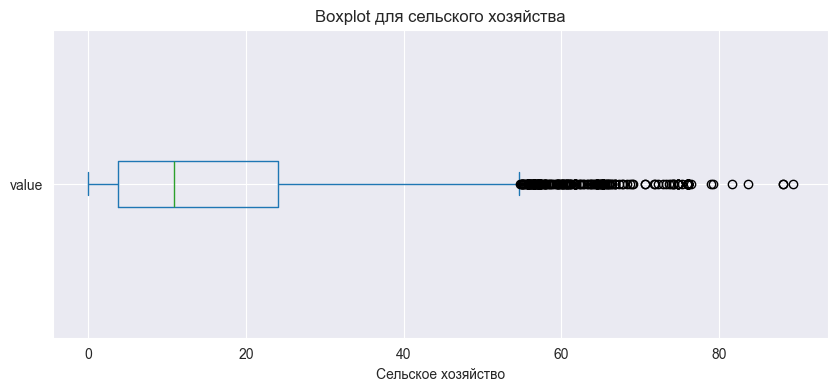

In [137]:
plt.figure(figsize=(10, 4))
df_9['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для сельского хозяйства')
plt.xlabel('Сельское хозяйство')
plt.show()

In [138]:
display(df_9['value'].quantile(0.01))
display(df_9['value'].quantile(0.99))

np.float64(0.055210350575496316)

np.float64(62.5126138046613)

Значения вполне реальны, да они экстремальные однако думаю отражают действительность

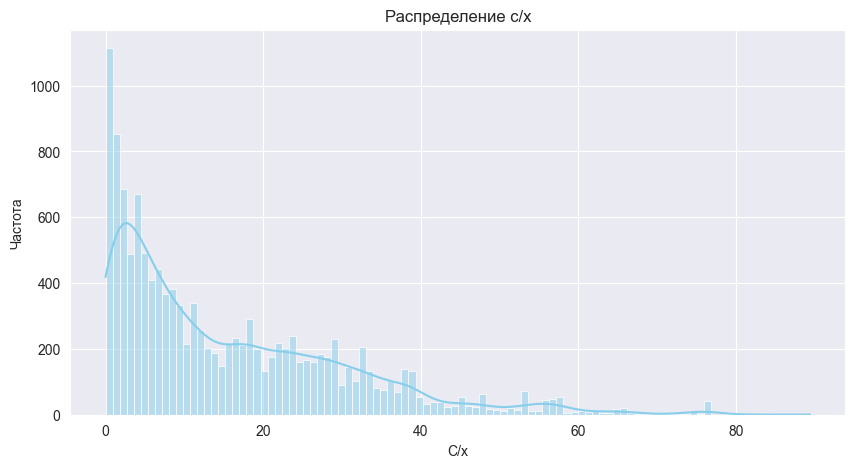

In [139]:
plt.figure(figsize=(10,5))
sns.histplot(df_9['value'], bins=100, kde=True, color='skyblue')
plt.title('Распределение c/х')
plt.xlabel('С/х')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

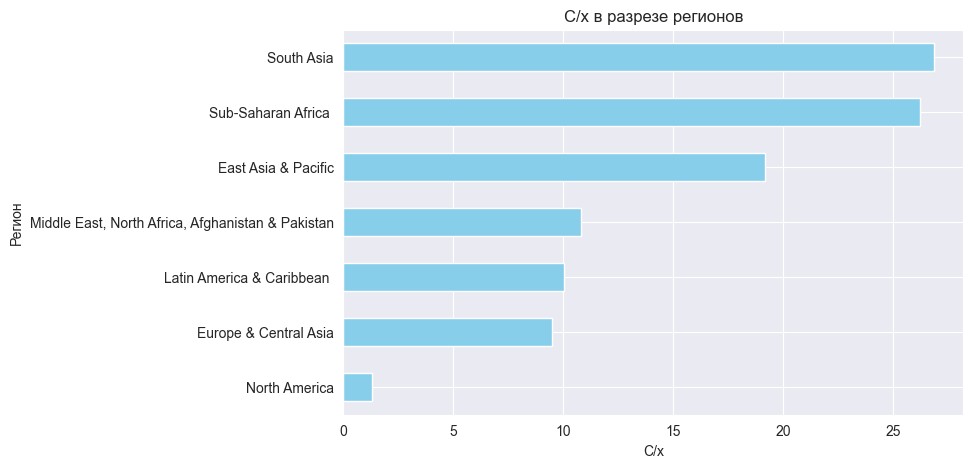

In [140]:
df_9_region = df_9.groupby(['region_value'])['value'].mean().sort_values()

df_9_region.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('С/х в разрезе регионов')
plt.xlabel('С/х')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

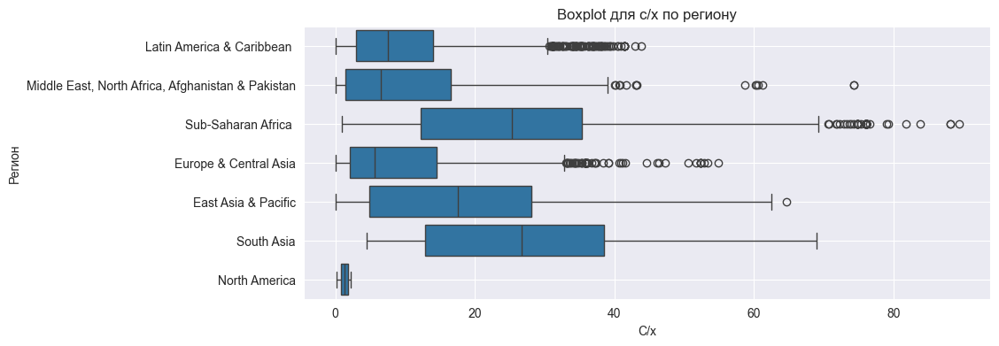

In [141]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='region_value', data=df_9, orient='h')
plt.xlabel('С/х')
plt.ylabel('Регион')
plt.title('Boxplot для с/х по региону')
plt.grid(True)
plt.show()

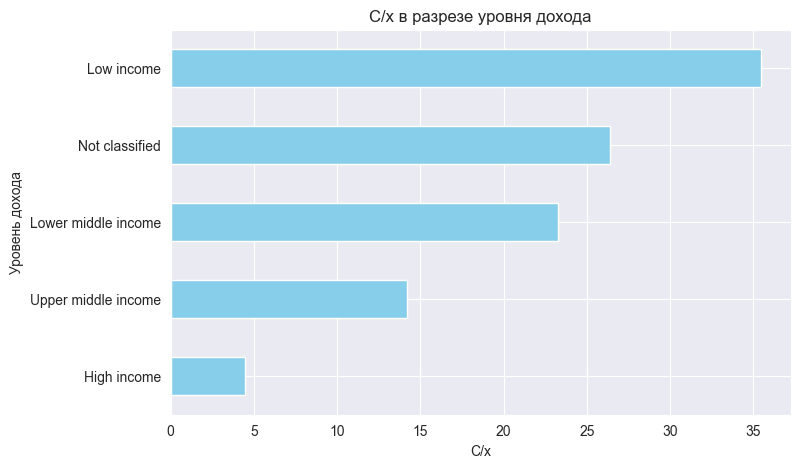

In [142]:
df_9_i_level = df_9.groupby(['income_level_value'])['value'].mean().sort_values()

df_9_i_level.plot(kind='barh', color='skyblue', figsize=(8,5))
plt.title('С/х в разрезе уровня дохода')
plt.xlabel('С/х')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

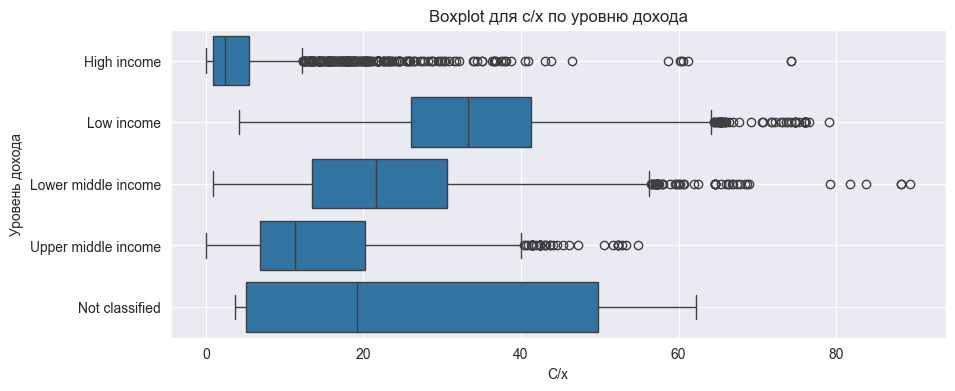

In [143]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='income_level_value', data=df_9, orient='h')
plt.xlabel('С/х')
plt.ylabel('Уровень дохода')
plt.title('Boxplot для с/х по уровню дохода')
plt.grid(True)
plt.show()

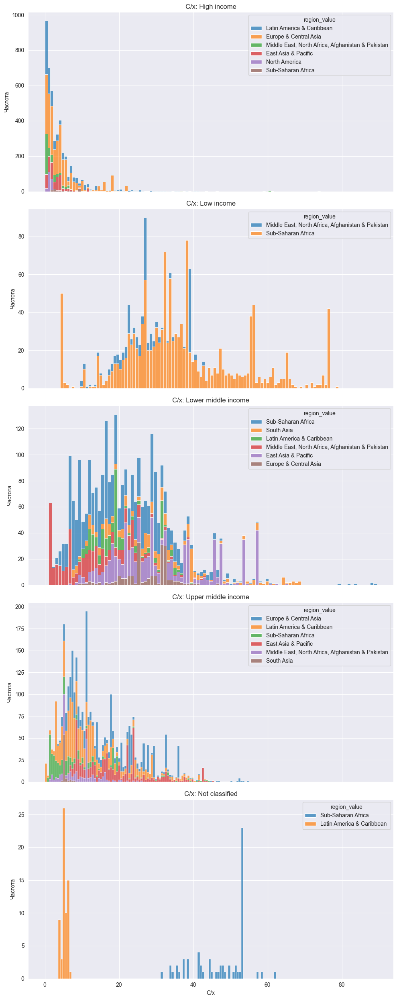

In [144]:
income_level = df_9['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_9[df_9['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=100,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'С/х: {i_l}')
    ax.set_xlabel('С/х')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

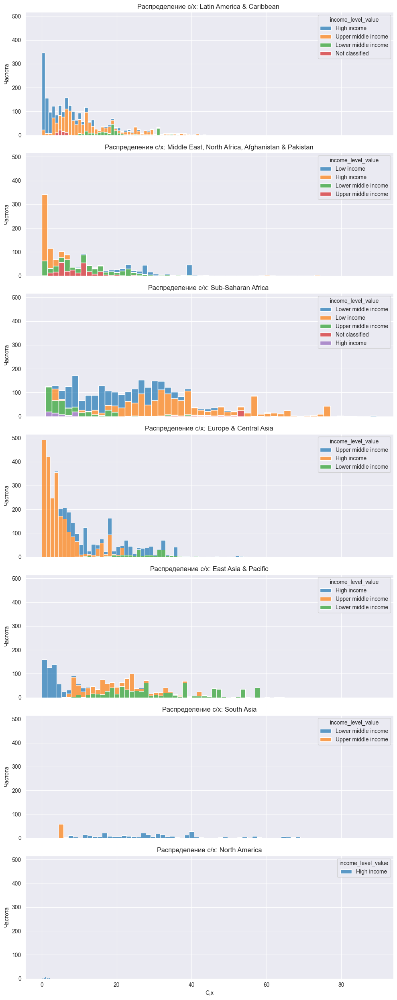

In [145]:
regions = df_9['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_9[df_9['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение с/х: {region}')
    ax.set_xlabel('С,х')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [146]:
df_9.loc[(df_9['date'] >= 1960)
         & (df_9['date'] <= 1980)
         & (df_9['name'] == 'Brazil'), 'value'] = np.nan
df_9.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12928 entries, 64 to 154687
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              12928 non-null  object 
 1   indicator_id            12928 non-null  object 
 2   date                    12928 non-null  int32  
 3   value                   12907 non-null  float64
 4   id                      12928 non-null  object 
 5   iso2_code               12928 non-null  object 
 6   name                    12928 non-null  object 
 7   capital_city            12928 non-null  object 
 8   longitude               12928 non-null  object 
 9   latitude                12928 non-null  object 
 10  region_id               12928 non-null  object 
 11  adminregion_id          12928 non-null  object 
 12  income_level_id         12928 non-null  object 
 13  lending_type_id         12928 non-null  object 
 14  region_iso2_code        12928 non-null  o

### Промежуточные выводы

Отметим что страны с высоким уровнем дохода имеют низкий процент сх в экономике, нет сильной связи с регионом выбивается только Северная америка, также для стран с более высоким уровнем дохода разброс распределения тоже снижается.
Явно есть экстремальные значения однако исторически корректны и не лишены здравого смысла, за исключением значения показателя в Бразилии в период с 1960-1980 значение 0, что совершенно нереалистично, возможно есть результат интерполяции

## NV.IND.TOTL.ZS - промышленность

In [147]:
df_10 = deepcopy(df[df['indicator_id'] == 'NV.IND.TOTL.ZS'])

In [148]:
df_10['value'].describe()

count    12992.000000
mean        26.682054
std         13.921592
min          0.000000
25%         16.960048
50%         24.814554
75%         32.492576
max         97.522278
Name: value, dtype: float64

In [149]:
display(df_10.sort_values(by='value', ascending=False).tail(25))
display(df_10.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
77758,LBN,NV.IND.TOTL.ZS,2022,2.390762,LBN,LB,Lebanon,Beirut,35.5134,33.8872,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
81923,LSO,NV.IND.TOTL.ZS,1963,2.365179,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
81922,LSO,NV.IND.TOTL.ZS,1962,2.365179,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
81921,LSO,NV.IND.TOTL.ZS,1961,2.365179,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
81920,LSO,NV.IND.TOTL.ZS,1960,2.365179,LSO,LS,Lesotho,Maseru,27.7167,-29.5208,...,ZG,Sub-Saharan Africa,XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
77759,LBN,NV.IND.TOTL.ZS,2023,2.086302,LBN,LB,Lebanon,Beirut,35.5134,33.8872,...,ZQ,"Middle East, North Africa, Afghanistan & Pakistan",XN,Lower middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
19406,BRA,NV.IND.TOTL.ZS,1974,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
19407,BRA,NV.IND.TOTL.ZS,1975,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
19403,BRA,NV.IND.TOTL.ZS,1971,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
19409,BRA,NV.IND.TOTL.ZS,1977,0.000000,BRA,BR,Brazil,Brasilia,-47.9292,-15.7801,...,ZJ,Latin America & Caribbean,XT,Upper middle income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
20884,BRN,NV.IND.TOTL.ZS,1980,97.522278,BRN,BN,Brunei Darussalam,Bandar Seri Begawan,114.946,4.94199,...,Z4,East Asia & Pacific,XD,High income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
20864,BRN,NV.IND.TOTL.ZS,1960,96.569679,BRN,BN,Brunei Darussalam,Bandar Seri Begawan,114.946,4.94199,...,Z4,East Asia & Pacific,XD,High income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
20865,BRN,NV.IND.TOTL.ZS,1961,96.569679,BRN,BN,Brunei Darussalam,Bandar Seri Begawan,114.946,4.94199,...,Z4,East Asia & Pacific,XD,High income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
20866,BRN,NV.IND.TOTL.ZS,1962,96.569679,BRN,BN,Brunei Darussalam,Bandar Seri Begawan,114.946,4.94199,...,Z4,East Asia & Pacific,XD,High income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2
20867,BRN,NV.IND.TOTL.ZS,1963,96.569679,BRN,BN,Brunei Darussalam,Bandar Seri Begawan,114.946,4.94199,...,Z4,East Asia & Pacific,XD,High income,NV.IND.TOTL.ZS,"Industry (including construction), value added...",N/F,Industry (including construction) corresponds ...,"Country official statistics, National Statisti...",2


Так же как и для сх значения для бразилии в период 1960-1980 равны нулю

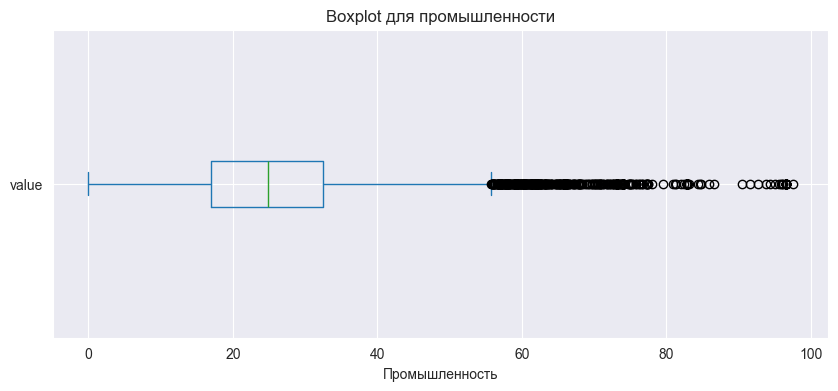

In [150]:
plt.figure(figsize=(10, 4))
df_10['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для промышленности')
plt.xlabel('Промышленность')
plt.show()

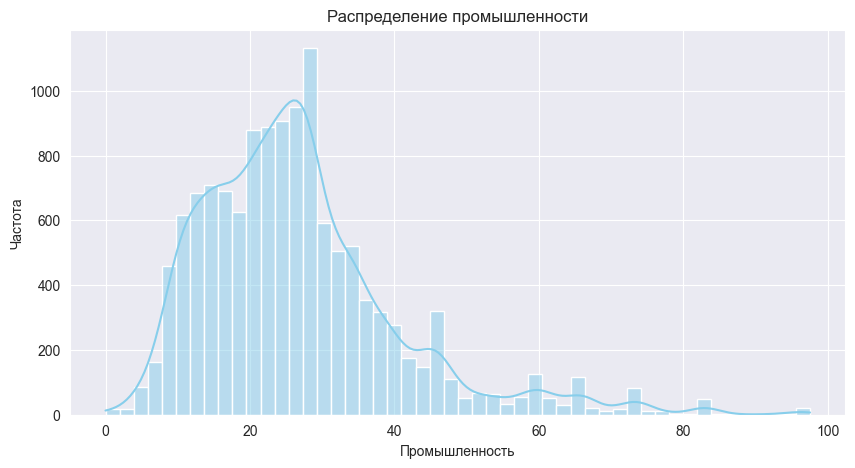

In [151]:
plt.figure(figsize=(10,5))
sns.histplot(df_10['value'], bins=50, kde=True, color='skyblue')
plt.title('Распределение промышленности')
plt.xlabel('Промышленность')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

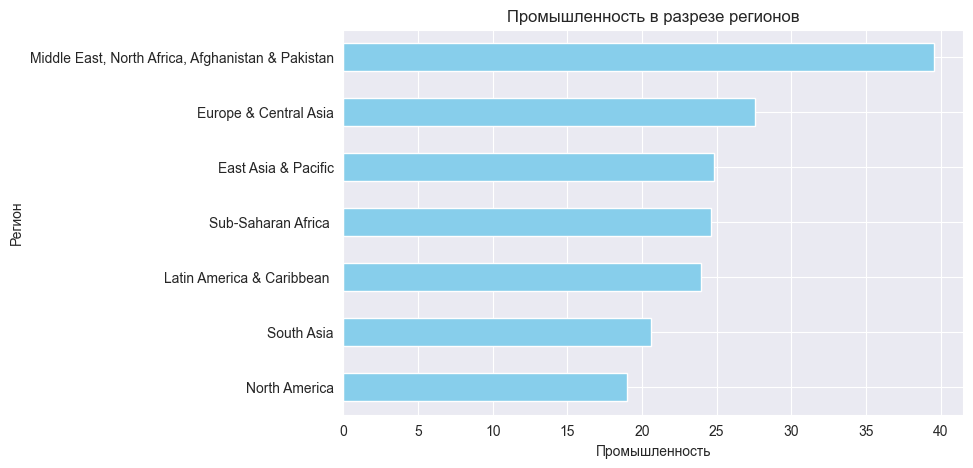

In [152]:
df_10_region = df_10.groupby(['region_value'])['value'].mean().sort_values()

df_10_region.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Промышленность в разрезе регионов')
plt.xlabel('Промышленность')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

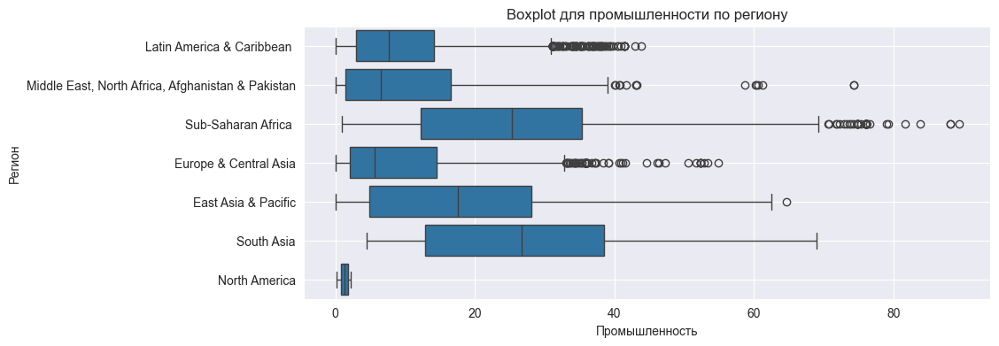

In [153]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='region_value', data=df_9, orient='h')
plt.xlabel('Промышленность')
plt.ylabel('Регион')
plt.title('Boxplot для промышленности по региону')
plt.grid(True)
plt.show()

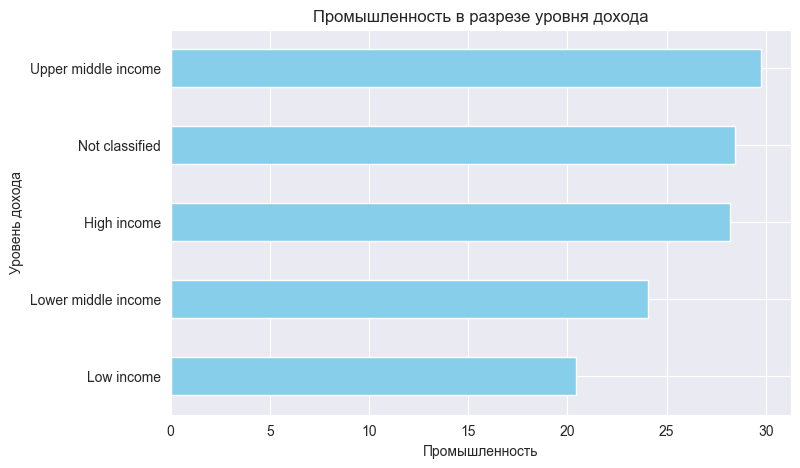

In [154]:
df_10_i_level = df_10.groupby(['income_level_value'])['value'].mean().sort_values()

df_10_i_level.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Промышленность в разрезе уровня дохода')
plt.xlabel('Промышленность')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

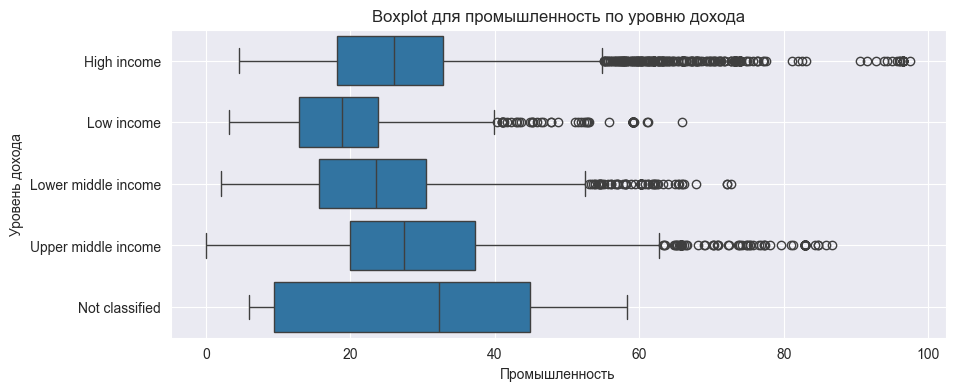

In [155]:
plt.figure(figsize=(10, 4))
sns.boxplot(x='value', y='income_level_value', data=df_10, orient='h')
plt.xlabel('Промышленность')
plt.ylabel('Уровень дохода')
plt.title('Boxplot для промышленность по уровню дохода')
plt.grid(True)
plt.show()

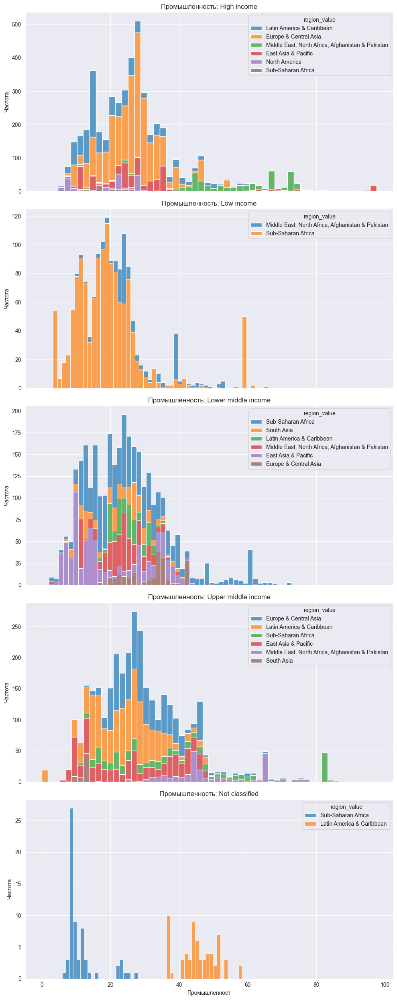

In [156]:
income_level = df_10['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_10[df_10['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Промышленность: {i_l}')
    ax.set_xlabel('Промышленност')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

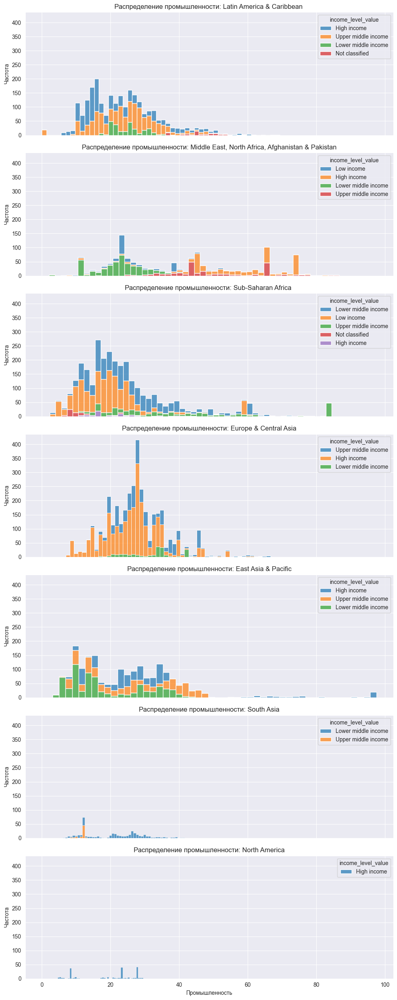

In [157]:
regions = df_10['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_10[df_10['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение промышленности: {region}')
    ax.set_xlabel('Промышленность')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [158]:
df_10.loc[(df_10['date'] >= 1960)
         & (df_10['date'] <= 1980)
         & (df_10['name'] == 'Brazil'), 'value'] = np.nan
df_10.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12992 entries, 128 to 154751
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              12992 non-null  object 
 1   indicator_id            12992 non-null  object 
 2   date                    12992 non-null  int32  
 3   value                   12971 non-null  float64
 4   id                      12992 non-null  object 
 5   iso2_code               12992 non-null  object 
 6   name                    12992 non-null  object 
 7   capital_city            12992 non-null  object 
 8   longitude               12992 non-null  object 
 9   latitude                12992 non-null  object 
 10  region_id               12992 non-null  object 
 11  adminregion_id          12992 non-null  object 
 12  income_level_id         12992 non-null  object 
 13  lending_type_id         12992 non-null  object 
 14  region_iso2_code        12992 non-null  

### Промежуточные выводы

Процент промышленности не сильно и явно зависит от уровня дохода страны, однако есть небольшая зависимость от региона, то есть распределение вв разрезе региона по уровню дохода выглядят похоже

Также как и для с/х для Бразилии данные в период 1960-1980 некорректны, есть регионы с большим разбросом, есть предположение, что это связано с уровнем развития в целом региона и равенством внутри

## SP.URB.TOTL.IN.ZS - Урбанизация

In [159]:
df_11 = deepcopy(df[df['indicator_id'] == 'SP.URB.TOTL.IN.ZS'])

In [160]:
df_11['value'].describe()

count    13376.000000
mean        50.979625
std         25.276800
min          2.077000
25%         30.257000
50%         50.430000
75%         71.168000
max        100.000000
Name: value, dtype: float64

In [161]:
display(df_11.sort_values(by='value', ascending=False).tail(5))
display(df_11.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
10052,BDI,SP.URB.TOTL.IN.ZS,1964,2.233,BDI,BI,Burundi,Bujumbura,29.3639,-3.3784,...,ZG,Sub-Saharan Africa,XM,Low income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
10051,BDI,SP.URB.TOTL.IN.ZS,1963,2.193,BDI,BI,Burundi,Bujumbura,29.3639,-3.3784,...,ZG,Sub-Saharan Africa,XM,Low income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
10050,BDI,SP.URB.TOTL.IN.ZS,1962,2.154,BDI,BI,Burundi,Bujumbura,29.3639,-3.3784,...,ZG,Sub-Saharan Africa,XM,Low income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
10049,BDI,SP.URB.TOTL.IN.ZS,1961,2.115,BDI,BI,Burundi,Bujumbura,29.3639,-3.3784,...,ZG,Sub-Saharan Africa,XM,Low income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
10048,BDI,SP.URB.TOTL.IN.ZS,1960,2.077,BDI,BI,Burundi,Bujumbura,29.3639,-3.3784,...,ZG,Sub-Saharan Africa,XM,Low income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
18389,BMU,SP.URB.TOTL.IN.ZS,1981,100.0,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18400,BMU,SP.URB.TOTL.IN.ZS,1992,100.0,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18388,BMU,SP.URB.TOTL.IN.ZS,1980,100.0,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18387,BMU,SP.URB.TOTL.IN.ZS,1979,100.0,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
105340,NRU,SP.URB.TOTL.IN.ZS,2020,100.0,NRU,NR,Nauru,Yaren District,166.920867,-0.5477,...,Z4,East Asia & Pacific,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2


Сначала кажется нереалистичным значение в 100 процентов, однако это острова-государства, вся территория единая застройка, которая считается городом, ведь город ровно то что страна считает городом, этак категория стоит отдельно нельзя скаазать что это выбросы

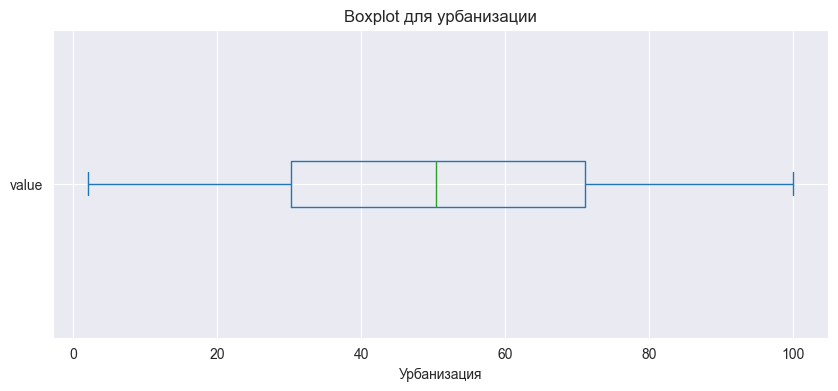

In [162]:
plt.figure(figsize=(10, 4))
df_11['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для урбанизации')
plt.xlabel('Урбанизация')
plt.show()

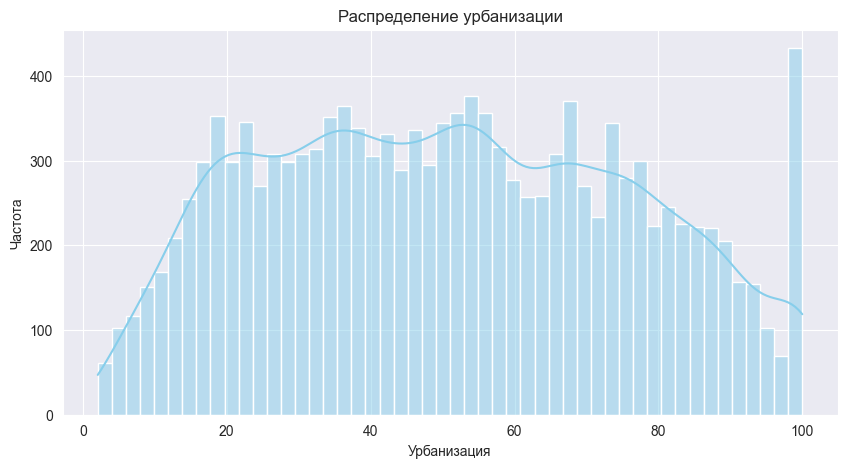

In [163]:
plt.figure(figsize=(10,5))
sns.histplot(df_11['value'], bins=50, kde=True, color='skyblue')
plt.title('Распределение урбанизации')
plt.xlabel('Урбанизация')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

Как раз можно заметить пик вблизи 100 процентов

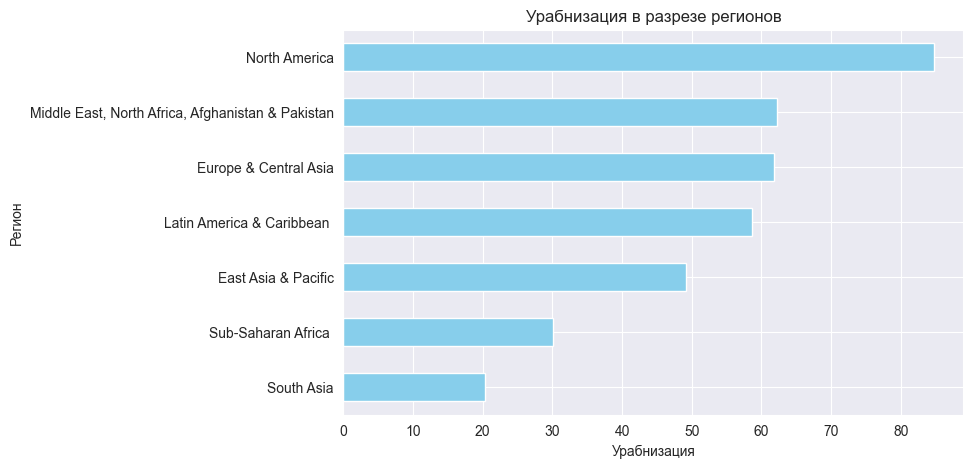

In [164]:
df_11_region = df_11.groupby(['region_value'])['value'].mean().sort_values()

df_11_region.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Урабнизация в разрезе регионов')
plt.xlabel('Урабнизация')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

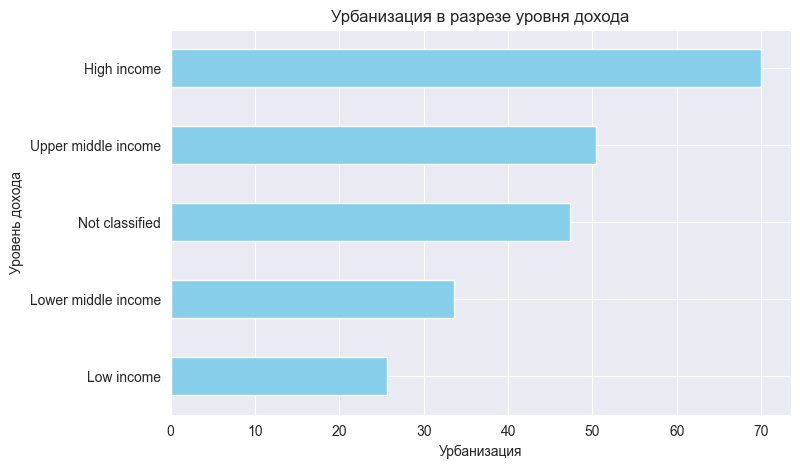

In [165]:
df_11_i_level = df_11.groupby(['income_level_value'])['value'].mean().sort_values()

df_11_i_level.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Урбанизация в разрезе уровня дохода')
plt.xlabel('Урбанизация')
plt.ylabel('Уровень дохода')
plt.grid(True)
plt.show()

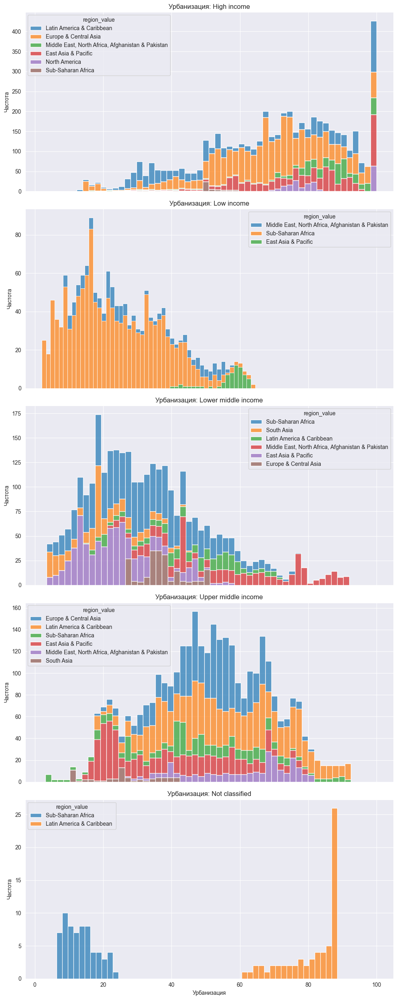

In [166]:
income_level = df_11['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_11[df_11['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Урбанизация: {i_l}')
    ax.set_xlabel('Урбанизация')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

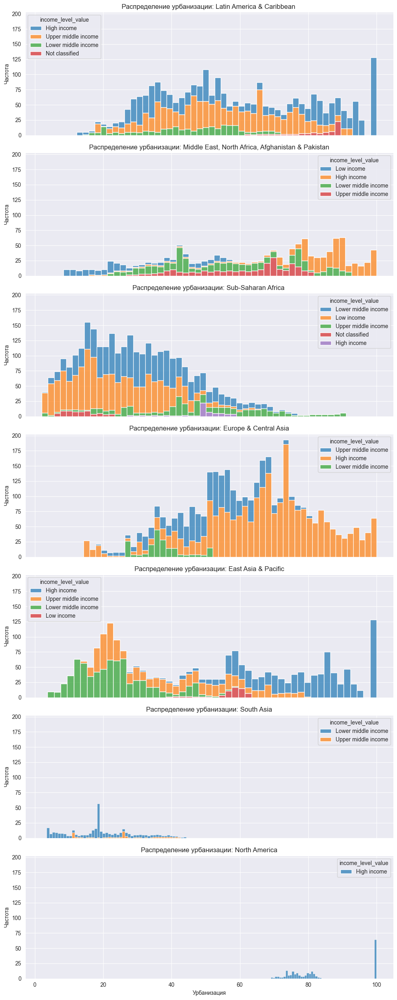

In [167]:
regions = df_11['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_11[df_11['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение урбанизации: {region}')
    ax.set_xlabel('Урбанизация')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [168]:
df_11[(df_11['region_value'] == 'North America') & (df_11['indicator_id'] == 'SP.URB.TOTL.IN.ZS')]

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
18368,BMU,SP.URB.TOTL.IN.ZS,1960,100.000,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18369,BMU,SP.URB.TOTL.IN.ZS,1961,100.000,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18370,BMU,SP.URB.TOTL.IN.ZS,1962,100.000,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18371,BMU,SP.URB.TOTL.IN.ZS,1963,100.000,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
18372,BMU,SP.URB.TOTL.IN.ZS,1964,100.000,BMU,BM,Bermuda,Hamilton,-64.706,32.3293,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146107,USA,SP.URB.TOTL.IN.ZS,2019,82.459,USA,US,United States,Washington D.C.,-77.032,38.8895,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
146108,USA,SP.URB.TOTL.IN.ZS,2020,82.664,USA,US,United States,Washington D.C.,-77.032,38.8895,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
146109,USA,SP.URB.TOTL.IN.ZS,2021,82.873,USA,US,United States,Washington D.C.,-77.032,38.8895,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2
146110,USA,SP.URB.TOTL.IN.ZS,2022,83.084,USA,US,United States,Washington D.C.,-77.032,38.8895,...,XU,North America,XD,High income,SP.URB.TOTL.IN.ZS,Urban population (% of total population),N/F,Urban population refers to people living in ur...,"World Urbanization Prospects, United Nations (...",2


### Промежуточные выводы

Есть ряд стран со значением 100 процентов, которые в дальнейшем анализе стоит исследовать отдельно
Нет явных выбросов.
Есть видимая взаимосвязь с уровнем дохода - больший процент городского населения соотв большему доходу, при этом нет видимой взаимосвязи с регионом кроме разброса данных


## SE.XPD.TOTL.GD.ZS - Расходы на образоввание

In [169]:
df_12 = deepcopy(df[df['indicator_id'] == 'SE.XPD.TOTL.GD.ZS'])

In [170]:
df_12['value'].describe()

count    12736.000000
mean         4.486526
std          4.394590
min          0.000000
25%          2.700420
50%          3.926740
75%          5.281410
max         66.900307
Name: value, dtype: float64

In [171]:
display(df_12.sort_values(by='value', ascending=False).tail(25))
display(df_12.sort_values(by='value', ascending=False).head(5))

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
52622,GIN,SE.XPD.TOTL.GD.ZS,1974,0.334940,GIN,GN,Guinea,Conakry,-13.7,9.51667,...,ZG,Sub-Saharan Africa,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
52632,GIN,SE.XPD.TOTL.GD.ZS,1984,0.334940,GIN,GN,Guinea,Conakry,-13.7,9.51667,...,ZG,Sub-Saharan Africa,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
52631,GIN,SE.XPD.TOTL.GD.ZS,1983,0.334940,GIN,GN,Guinea,Conakry,-13.7,9.51667,...,ZG,Sub-Saharan Africa,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
52633,GIN,SE.XPD.TOTL.GD.ZS,1985,0.334940,GIN,GN,Guinea,Conakry,-13.7,9.51667,...,ZG,Sub-Saharan Africa,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
101311,NGA,SE.XPD.TOTL.GD.ZS,2023,0.319069,NGA,NG,Nigeria,Abuja,7.48906,9.05804,...,ZG,Sub-Saharan Africa,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
147967,VEN,SE.XPD.TOTL.GD.ZS,2023,0.003130,VEN,VE,"Venezuela, RB",Caracas,-69.8371,9.08165,...,ZJ,Latin America & Caribbean,XY,Not classified,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
124799,SOM,SE.XPD.TOTL.GD.ZS,2023,0.000008,SOM,SO,"Somalia, Fed. Rep.",Mogadishu,45.3254,2.07515,...,ZG,Sub-Saharan Africa,XM,Low income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
124798,SOM,SE.XPD.TOTL.GD.ZS,2022,0.000007,SOM,SO,"Somalia, Fed. Rep.",Mogadishu,45.3254,2.07515,...,ZG,Sub-Saharan Africa,XM,Low income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
124797,SOM,SE.XPD.TOTL.GD.ZS,2021,0.000007,SOM,SO,"Somalia, Fed. Rep.",Mogadishu,45.3254,2.07515,...,ZG,Sub-Saharan Africa,XM,Low income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
124796,SOM,SE.XPD.TOTL.GD.ZS,2020,0.000006,SOM,SO,"Somalia, Fed. Rep.",Mogadishu,45.3254,2.07515,...,ZG,Sub-Saharan Africa,XM,Low income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2


,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
48861,FSM,SE.XPD.TOTL.GD.ZS,1989,66.900307,FSM,FM,"Micronesia, Fed. Sts.",Palikir,158.185,6.91771,...,Z4,East Asia & Pacific,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
48858,FSM,SE.XPD.TOTL.GD.ZS,1986,66.900307,FSM,FM,"Micronesia, Fed. Sts.",Palikir,158.185,6.91771,...,Z4,East Asia & Pacific,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
48860,FSM,SE.XPD.TOTL.GD.ZS,1988,66.900307,FSM,FM,"Micronesia, Fed. Sts.",Palikir,158.185,6.91771,...,Z4,East Asia & Pacific,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
48859,FSM,SE.XPD.TOTL.GD.ZS,1987,66.900307,FSM,FM,"Micronesia, Fed. Sts.",Palikir,158.185,6.91771,...,Z4,East Asia & Pacific,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
48863,FSM,SE.XPD.TOTL.GD.ZS,1991,66.900307,FSM,FM,"Micronesia, Fed. Sts.",Palikir,158.185,6.91771,...,Z4,East Asia & Pacific,XN,Lower middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2


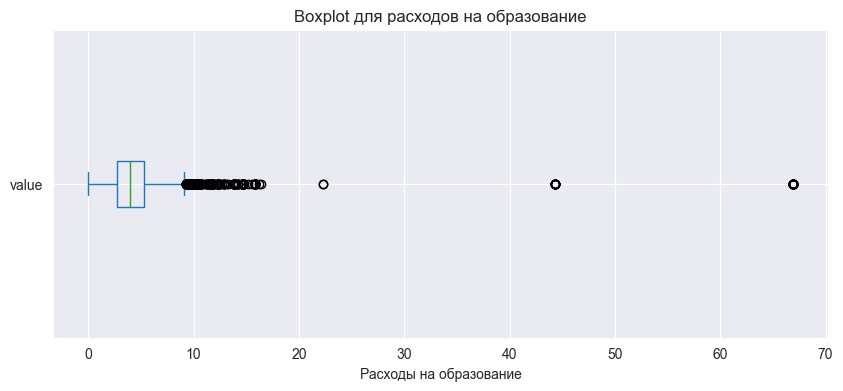

In [172]:
plt.figure(figsize=(10, 4))
df_12['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Boxplot для расходов на образование')
plt.xlabel('Расходы на образование')
plt.show()

Явно нужна фильтрация но отфильтруем только сильно явные хвосты

In [173]:
display(df_12['value'].quantile(0.995))
display(df_12['value'].quantile(0.003))

np.float64(15.8634700775147)

np.float64(0.334939986467362)

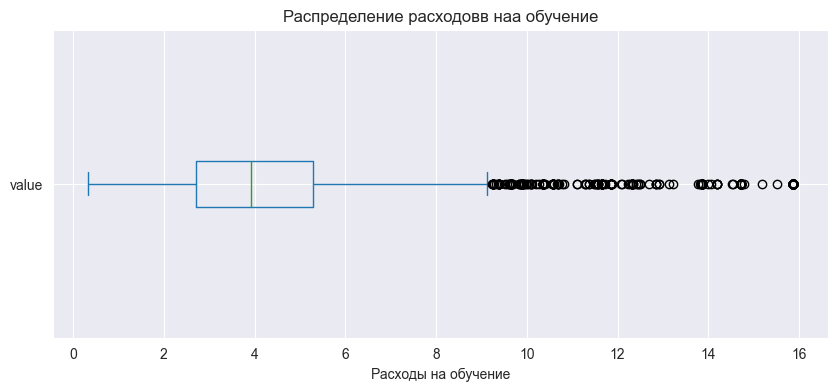

In [174]:
filt_1 = df_12['value'].quantile(0.995)
filt_2 = df_12['value'].quantile(0.003)

df_12['value'] = df_12['value'].apply(lambda x: filt_1 if x > filt_1 else (filt_2 if x < filt_2 else x))
plt.figure(figsize=(10, 4))
df_12['value'].plot.box(
    vert=False,
    grid=True
)
plt.title('Распределение расходовв наа обучение')
plt.xlabel('Расходы на обучение')
plt.show()

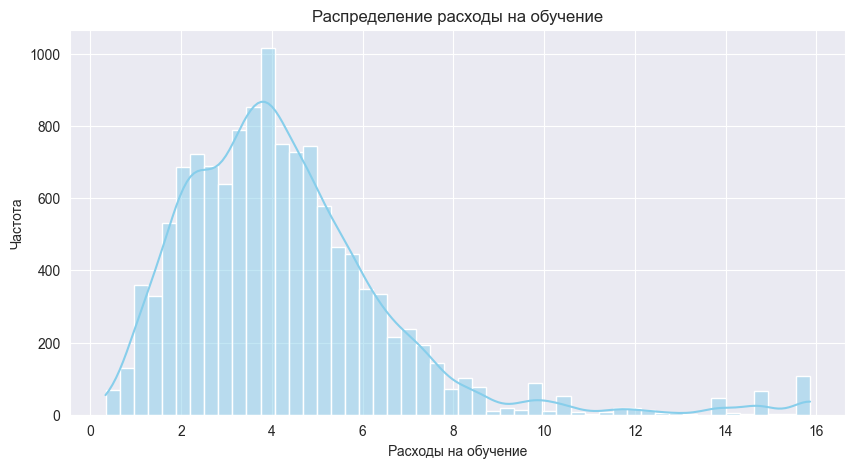

In [175]:
plt.figure(figsize=(10,5))
sns.histplot(df_12['value'], bins=50, kde=True, color='skyblue')
plt.title('Распределение расходы на обучение')
plt.xlabel('Расходы на обучение')
plt.ylabel('Частота')
plt.grid(True)
plt.show()

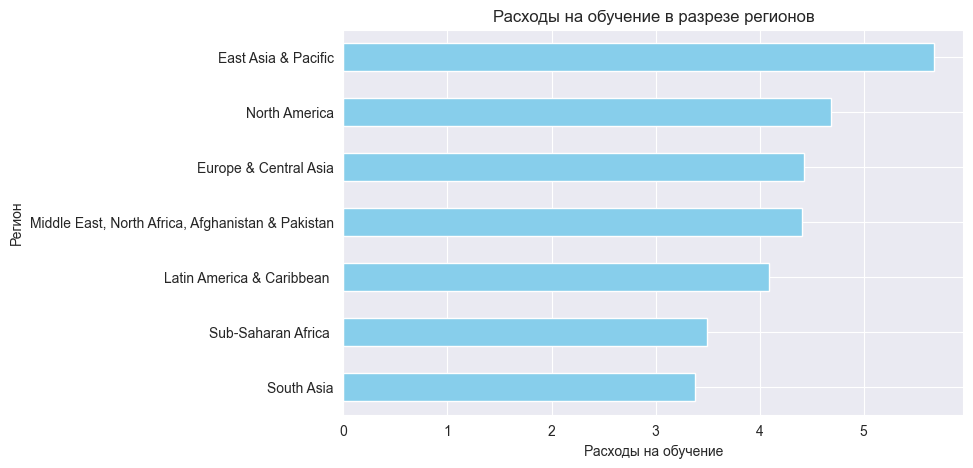

In [176]:
df_12_region = df_12.groupby(['region_value'])['value'].mean().sort_values()

df_12_region.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Расходы на обучение в разрезе регионов')
plt.xlabel('Расходы на обучение')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

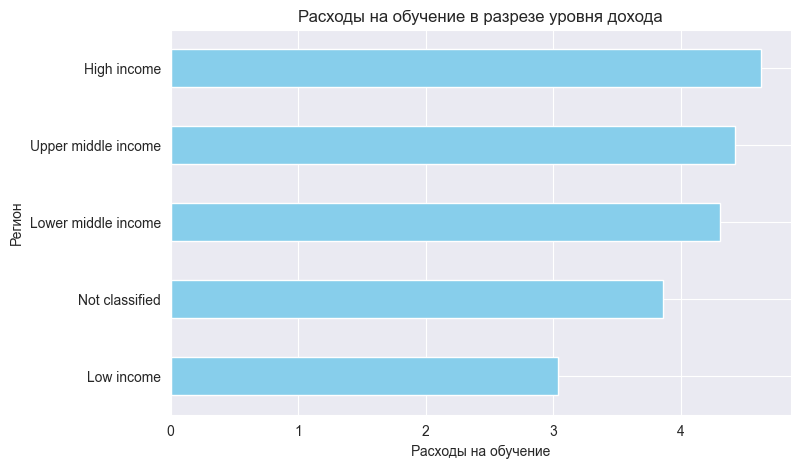

In [177]:
df_12_i_level = df_12.groupby(['income_level_value'])['value'].mean().sort_values()

df_12_i_level.plot(kind='barh', color='skyblue', figsize=(8, 5))
plt.title('Расходы на обучение в разрезе уровня дохода')
plt.xlabel('Расходы на обучение')
plt.ylabel('Регион')
plt.grid(True)
plt.show()

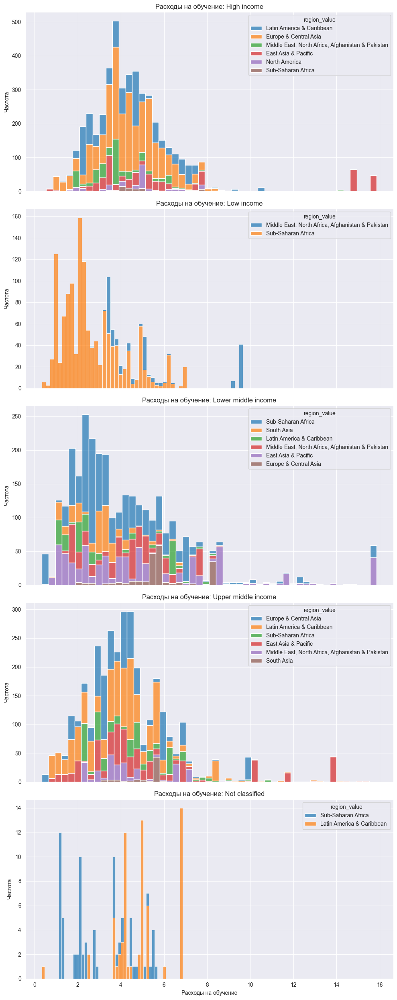

In [178]:
income_level = df_12['income_level_value'].unique()
count = len(income_level)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=False)  # 5 рядов, 1 колонка

for ax, i_l in zip(axes, income_level):
    sns.histplot(
        data=df_12[df_12['income_level_value'] == i_l],
        x='value',
        hue='region_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Расходы на обучение: {i_l}')
    ax.set_xlabel('Расходы на обучение')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

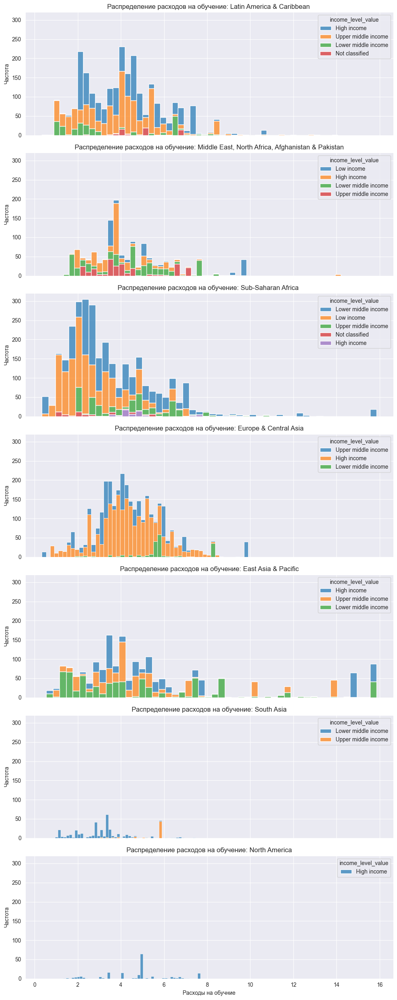

In [179]:
regions = df_12['region_value'].unique()
count = len(regions)
fig, axes = plt.subplots(count, 1, figsize=(10, 25), sharex=True, sharey=True)  # 5 рядов, 1 колонка

for ax, region in zip(axes, regions):
    sns.histplot(
        data=df_12[df_12['region_value'] == region],
        x='value',
        hue='income_level_value',
        bins=50,
        multiple='stack',
        alpha=0.7,
        ax=ax
    )
    ax.set_title(f'Распределение расходов на обучение: {region}')
    ax.set_xlabel('Расходы на обучние')
    ax.set_ylabel('Частота')
    ax.grid(True)

plt.tight_layout()
plt.show()

In [180]:
df_12[(df_12['name'] == "Turkiye")].head(60)

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
141184,TUR,SE.XPD.TOTL.GD.ZS,1960,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141185,TUR,SE.XPD.TOTL.GD.ZS,1961,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141186,TUR,SE.XPD.TOTL.GD.ZS,1962,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141187,TUR,SE.XPD.TOTL.GD.ZS,1963,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141188,TUR,SE.XPD.TOTL.GD.ZS,1964,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141189,TUR,SE.XPD.TOTL.GD.ZS,1965,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141190,TUR,SE.XPD.TOTL.GD.ZS,1966,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141191,TUR,SE.XPD.TOTL.GD.ZS,1967,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141192,TUR,SE.XPD.TOTL.GD.ZS,1968,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141193,TUR,SE.XPD.TOTL.GD.ZS,1969,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2


Этот гап явно аномальный заполним средним

In [181]:
df_12.loc[(df_12['name'] == 'Turkiye')
          & (df_12['date'] >= 1998)
          & (df_12['date'] <= 2010), 'value'] = (4.22 + 2.51)/2
df_12[(df_12['name'] == "Turkiye")].head(60)

,country_id,indicator_id,date,value,id,iso2_code,name,capital_city,longitude,latitude,...,region_iso2_code,region_value,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id
141184,TUR,SE.XPD.TOTL.GD.ZS,1960,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141185,TUR,SE.XPD.TOTL.GD.ZS,1961,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141186,TUR,SE.XPD.TOTL.GD.ZS,1962,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141187,TUR,SE.XPD.TOTL.GD.ZS,1963,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141188,TUR,SE.XPD.TOTL.GD.ZS,1964,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141189,TUR,SE.XPD.TOTL.GD.ZS,1965,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141190,TUR,SE.XPD.TOTL.GD.ZS,1966,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141191,TUR,SE.XPD.TOTL.GD.ZS,1967,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141192,TUR,SE.XPD.TOTL.GD.ZS,1968,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2
141193,TUR,SE.XPD.TOTL.GD.ZS,1969,4.34774,TUR,TR,Turkiye,Ankara,32.3606,39.7153,...,Z7,Europe & Central Asia,XT,Upper middle income,SE.XPD.TOTL.GD.ZS,"Government expenditure on education, total (% ...",N/F,General government expenditure on education (c...,"Data API, UN Educational, Scientific and Cultu...",2


In [182]:
df_12.loc[(df_12['date'] >= 1960) & (df_12['date'] <= 1970), 'value'] = np.nan
df_12.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12736 entries, 256 to 154879
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              12736 non-null  object 
 1   indicator_id            12736 non-null  object 
 2   date                    12736 non-null  int32  
 3   value                   10547 non-null  float64
 4   id                      12736 non-null  object 
 5   iso2_code               12736 non-null  object 
 6   name                    12736 non-null  object 
 7   capital_city            12736 non-null  object 
 8   longitude               12736 non-null  object 
 9   latitude                12736 non-null  object 
 10  region_id               12736 non-null  object 
 11  adminregion_id          12736 non-null  object 
 12  income_level_id         12736 non-null  object 
 13  lending_type_id         12736 non-null  object 
 14  region_iso2_code        12736 non-null  

### Промежуточные выводы

Сильно явных закономерностей не обнаружено, в среднем чем больше доход страны тем выше расходы на образование
Были обнаружены нестственно низкие значения - выбросы и отфильтрованы
Также хочется отметить довольно слабый показатель с точки зрения действ информаиции, во первых до 1970 года совершенно нет информации, на примере турции развитой страны видим как много гапов было заполнено интерполяцией

## Общие выводы по главе

Был проведен легкий разведочный анализ, следующий шаг подготовка итоговой панели
формат таблицы следующий
страна | регион | уровень дохода | indicator_1_raw | indicator_1_proc | flag | ...

Были обнаружены сильно выбивающиеся не похожие на правду значения некоторых показателей для них флаг будет 2, зачастую мы не будем их использовать, вероятнее всего это некореткная интерполяция и заполнение пропусков, такие флаги мы поставим, если значение индиктора до обработки nan (полностью пропущенные ряды), выставим для двух индикаторов (EG.USE.PCAP.KG.OE Энергопотребление на душу) SE.XPD.TOTL.GD.ZS расходы на образование) на том интервале где для этих индикаторов данных вообще нет - значение тренарного флага 2

Для всех демографических показателей, мы установим тренарный флаг значением 1, который лишь будет отражать экстремальность, флаг значением 0 - это остальные данные.
Значения экономических показателей оставим неизменными флаг - 0

# Подготовка панели на основе произведенного аналииза

Ранее уже были подготовлены отдельные таблицы для каааждого индикатора в отдельности
теперь соеденим все вместе


In [183]:
df_panel = deepcopy(df)
df_panel = (df_panel[['country_id', 'name', 'region_id', 'region_value',
                    'income_level_id', 'income_level_value', 'date']]
            .drop_duplicates())
df_panel.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13504 entries, 0 to 154559
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   country_id          13504 non-null  object
 1   name                13504 non-null  object
 2   region_id           13504 non-null  object
 3   region_value        13504 non-null  object
 4   income_level_id     13504 non-null  object
 5   income_level_value  13504 non-null  object
 6   date                13504 non-null  int32 
dtypes: int32(1), object(6)
memory usage: 791.2+ KB


In [184]:
df_combined = pd.concat([df_1
                         , df_2
                         , df_3
                         , df_4
                         , df_5
                         , df_6
                         , df_7
                         , df_8
                         , df_9
                         , df_10
                         , df_11
                         , df_12 ], axis=0, ignore_index=True)
df_combined.info()
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155264 entries, 0 to 155263
Data columns (total 24 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   country_id              155264 non-null  object 
 1   indicator_id            155264 non-null  object 
 2   date                    155264 non-null  int32  
 3   value                   147577 non-null  float64
 4   id                      155264 non-null  object 
 5   iso2_code               155264 non-null  object 
 6   name                    155264 non-null  object 
 7   capital_city            155264 non-null  object 
 8   longitude               155264 non-null  object 
 9   latitude                155264 non-null  object 
 10  region_id               155264 non-null  object 
 11  adminregion_id          155264 non-null  object 
 12  income_level_id         155264 non-null  object 
 13  lending_type_id         155264 non-null  object 
 14  region_iso2_code    

In [185]:
df_merged = pd.merge(
    df,
    df_combined[['country_id','date','indicator_id', 'value']],
    on=['country_id','date','indicator_id'],
    how='left',
    suffixes=('_raw','_proc')
)
df_merged['flag'] = 0
df_merged.loc[df_merged['value_proc'] != df_merged['value_raw'], 'flag'] = 1
df_merged.loc[df_merged['value_proc'].isna(), 'flag']= 2


In [186]:
display(df_merged['flag'].unique())
display(df_merged.head())
display(df_merged.info())

array([0, 2, 1])

,country_id,indicator_id,date,value_raw,id,iso2_code,name,capital_city,longitude,latitude,...,income_level_iso2_code,income_level_value,id_indicator,name_indicator,unit,source_note,source_organization,source_id,value_proc,flag
0,ABW,NE.TRD.GNFS.ZS,1960,171.362098,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2,171.362098,0
1,ABW,NE.TRD.GNFS.ZS,1961,171.362098,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2,171.362098,0
2,ABW,NE.TRD.GNFS.ZS,1962,171.362098,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2,171.362098,0
3,ABW,NE.TRD.GNFS.ZS,1963,171.362098,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2,171.362098,0
4,ABW,NE.TRD.GNFS.ZS,1964,171.362098,ABW,AW,Aruba,Oranjestad,-70.0167,12.5167,...,XD,High income,NE.TRD.GNFS.ZS,Trade (% of GDP),N/F,Trade is the sum of exports and imports of goo...,"Country official statistics, National Statisti...",2,171.362098,0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 155264 entries, 0 to 155263
Data columns (total 26 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   country_id              155264 non-null  object 
 1   indicator_id            155264 non-null  object 
 2   date                    155264 non-null  int32  
 3   value_raw               155264 non-null  float64
 4   id                      155264 non-null  object 
 5   iso2_code               155264 non-null  object 
 6   name                    155264 non-null  object 
 7   capital_city            155264 non-null  object 
 8   longitude               155264 non-null  object 
 9   latitude                155264 non-null  object 
 10  region_id               155264 non-null  object 
 11  adminregion_id          155264 non-null  object 
 12  income_level_id         155264 non-null  object 
 13  lending_type_id         155264 non-null  object 
 14  region_iso2_code    

None

In [187]:
df_panel = df_merged.pivot_table(
        index=['country_id', 'date', 'region_id', 'region_value', 'income_level_id', 'income_level_value',],
        columns='indicator_id',
        values=['value_raw','value_proc', 'flag'],
        aggfunc='first'  # на случай дубликатов оставляем первое значение
    ).reset_index()

df_panel.columns = df_panel.columns.swaplevel(0,1)
df_panel = df_panel.sort_index(axis=1, level=0)
df_panel.columns = ['_'.join(filter(None, map(str, col))).strip() for col in df_panel.columns.values]
display(df_panel.info())
df_panel.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13504 entries, 0 to 13503
Data columns (total 42 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   country_id                    13504 non-null  object 
 1   date                          13504 non-null  int32  
 2   income_level_id               13504 non-null  object 
 3   income_level_value            13504 non-null  object 
 4   region_id                     13504 non-null  object 
 5   region_value                  13504 non-null  object 
 6   EG.USE.PCAP.KG.OE_flag        11264 non-null  float64
 7   EG.USE.PCAP.KG.OE_value_proc  5808 non-null   float64
 8   EG.USE.PCAP.KG.OE_value_raw   11264 non-null  float64
 9   NE.TRD.GNFS.ZS_flag           12160 non-null  float64
 10  NE.TRD.GNFS.ZS_value_proc     12160 non-null  float64
 11  NE.TRD.GNFS.ZS_value_raw      12160 non-null  float64
 12  NV.AGR.TOTL.ZS_flag           12928 non-null  float64
 13  N

None

,country_id,date,income_level_id,income_level_value,region_id,region_value,EG.USE.PCAP.KG.OE_flag,EG.USE.PCAP.KG.OE_value_proc,EG.USE.PCAP.KG.OE_value_raw,NE.TRD.GNFS.ZS_flag,...,SP.DYN.IMRT.IN_value_raw,SP.DYN.LE00.IN_flag,SP.DYN.LE00.IN_value_proc,SP.DYN.LE00.IN_value_raw,SP.POP.GROW_flag,SP.POP.GROW_value_proc,SP.POP.GROW_value_raw,SP.URB.TOTL.IN.ZS_flag,SP.URB.TOTL.IN.ZS_value_proc,SP.URB.TOTL.IN.ZS_value_raw
0,ABW,1960,HIC,High income,LCN,Latin America & Caribbean,NaN,NaN,NaN,0.0,...,NaN,0.0,64.049,64.049,0.0,1.187344,1.187344,0.0,50.776,50.776
1,ABW,1961,HIC,High income,LCN,Latin America & Caribbean,NaN,NaN,NaN,0.0,...,NaN,0.0,64.215,64.215,0.0,1.187344,1.187344,0.0,50.761,50.761
2,ABW,1962,HIC,High income,LCN,Latin America & Caribbean,NaN,NaN,NaN,0.0,...,NaN,0.0,64.602,64.602,0.0,1.326227,1.326227,0.0,50.746,50.746
3,ABW,1963,HIC,High income,LCN,Latin America & Caribbean,NaN,NaN,NaN,0.0,...,NaN,0.0,64.944,64.944,0.0,1.203664,1.203664,0.0,50.730,50.730
4,ABW,1964,HIC,High income,LCN,Latin America & Caribbean,NaN,NaN,NaN,0.0,...,NaN,0.0,65.303,65.303,0.0,1.076602,1.076602,0.0,50.715,50.715


In [188]:
flag_cols = [col for col in df_panel.columns if col.endswith('_flag')]
df_panel[flag_cols] = df_panel[flag_cols].fillna(2)
display(df_panel.info())
df_panel.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13504 entries, 0 to 13503
Data columns (total 42 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   country_id                    13504 non-null  object 
 1   date                          13504 non-null  int32  
 2   income_level_id               13504 non-null  object 
 3   income_level_value            13504 non-null  object 
 4   region_id                     13504 non-null  object 
 5   region_value                  13504 non-null  object 
 6   EG.USE.PCAP.KG.OE_flag        13504 non-null  float64
 7   EG.USE.PCAP.KG.OE_value_proc  5808 non-null   float64
 8   EG.USE.PCAP.KG.OE_value_raw   11264 non-null  float64
 9   NE.TRD.GNFS.ZS_flag           13504 non-null  float64
 10  NE.TRD.GNFS.ZS_value_proc     12160 non-null  float64
 11  NE.TRD.GNFS.ZS_value_raw      12160 non-null  float64
 12  NV.AGR.TOTL.ZS_flag           13504 non-null  float64
 13  N

None

,country_id,date,income_level_id,income_level_value,region_id,region_value,EG.USE.PCAP.KG.OE_flag,EG.USE.PCAP.KG.OE_value_proc,EG.USE.PCAP.KG.OE_value_raw,NE.TRD.GNFS.ZS_flag,...,SP.DYN.IMRT.IN_value_raw,SP.DYN.LE00.IN_flag,SP.DYN.LE00.IN_value_proc,SP.DYN.LE00.IN_value_raw,SP.POP.GROW_flag,SP.POP.GROW_value_proc,SP.POP.GROW_value_raw,SP.URB.TOTL.IN.ZS_flag,SP.URB.TOTL.IN.ZS_value_proc,SP.URB.TOTL.IN.ZS_value_raw
0,ABW,1960,HIC,High income,LCN,Latin America & Caribbean,2.0,NaN,NaN,0.0,...,NaN,0.0,64.049,64.049,0.0,1.187344,1.187344,0.0,50.776,50.776
1,ABW,1961,HIC,High income,LCN,Latin America & Caribbean,2.0,NaN,NaN,0.0,...,NaN,0.0,64.215,64.215,0.0,1.187344,1.187344,0.0,50.761,50.761
2,ABW,1962,HIC,High income,LCN,Latin America & Caribbean,2.0,NaN,NaN,0.0,...,NaN,0.0,64.602,64.602,0.0,1.326227,1.326227,0.0,50.746,50.746
3,ABW,1963,HIC,High income,LCN,Latin America & Caribbean,2.0,NaN,NaN,0.0,...,NaN,0.0,64.944,64.944,0.0,1.203664,1.203664,0.0,50.730,50.730
4,ABW,1964,HIC,High income,LCN,Latin America & Caribbean,2.0,NaN,NaN,0.0,...,NaN,0.0,65.303,65.303,0.0,1.076602,1.076602,0.0,50.715,50.715


In [189]:
df = deepcopy(df_panel)

В резульате мы получили широкую таблицу, которую будем применять в дальнейшем анализе, для каждой страны и года есть значения каждого индикатора, обработанные, первоначальные, флаг 2 - данные некорректны либо их нет, 1 - экстремальное значение, 0 - все в порядке, это нормально что есть пропуски для значений показателей

# Корреляция

- Общая
- по регионам
- по десятилетиям
- по уровням дохода

- Ключевые парные графики - диаграммы рассеяния

In [190]:
raw_cols = [c for c in df.columns if c.endswith('_value_raw')]
flag_cols = [c.replace('_value_raw', '_flag') for c in raw_cols]

def prepare_corr_df(df_sub):
    tmp = df_sub[raw_cols].copy()
    for r, f in zip(raw_cols, flag_cols):
        tmp.loc[df_sub[f] == 2, r] = np.nan
    return tmp.dropna(axis=1, how='all')

In [191]:
corr_table = pd.DataFrame()

df_all = prepare_corr_df(df)
corr = df_all.corr()
corr_table['Overall'] = df_all.corr()['SP.DYN.LE00.IN_value_raw']

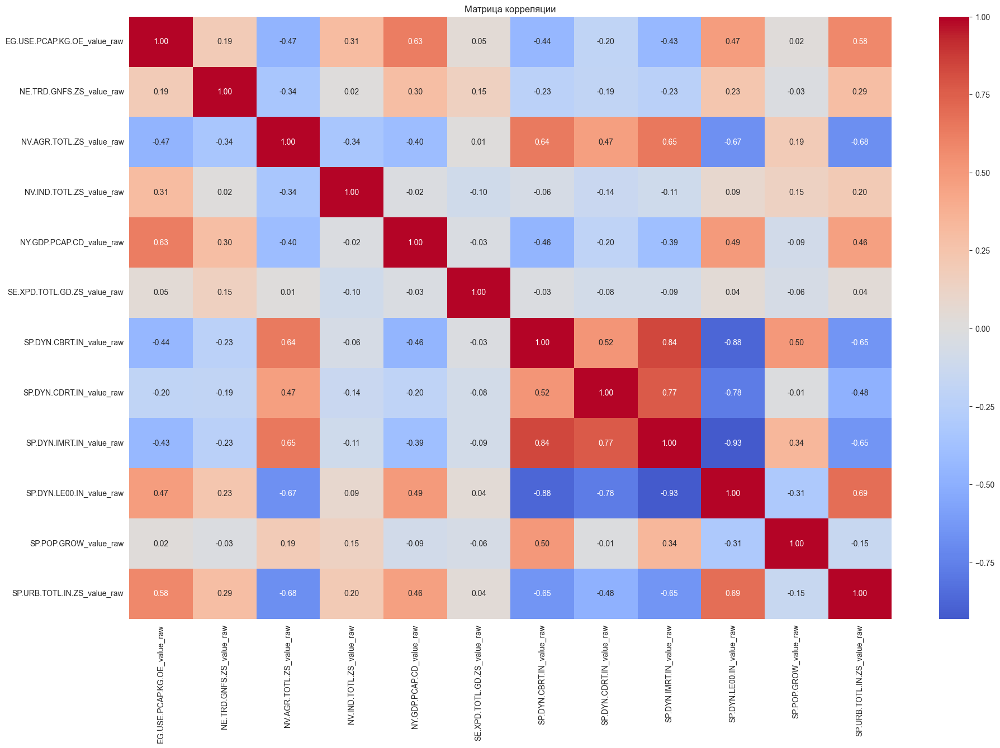

In [192]:
plt.figure(figsize=(22,14))
sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap='coolwarm',
    center=0)
plt.title("Матрица корреляции")
plt.show()

Данная матрица по большей части нужна для нахождения мультиколлинеарности, сам анализ будем проводить по другой

In [193]:
for region in df['region_value'].unique():
    df_region = df[df['region_value'] == region]
    corr_table[region] = (
        prepare_corr_df(df_region)
        .corr()['SP.DYN.LE00.IN_value_raw']
    )

In [194]:
for level in df['income_level_value'].unique():
    df_level = df[df['income_level_value'] == level]
    corr_table[level] = (
        prepare_corr_df(df_level)
        .corr()['SP.DYN.LE00.IN_value_raw']
    )

In [195]:
df['decade'] = (df['date'] // 10) * 10

for decade in sorted(df['decade'].unique()):
    df_decade = df[df['decade'] == decade]

    if df_decade.shape[0] < 100:
        continue

    corr_table[f'{decade}s'] = (
        prepare_corr_df(df_decade)
        .corr()['SP.DYN.LE00.IN_value_raw']
    )

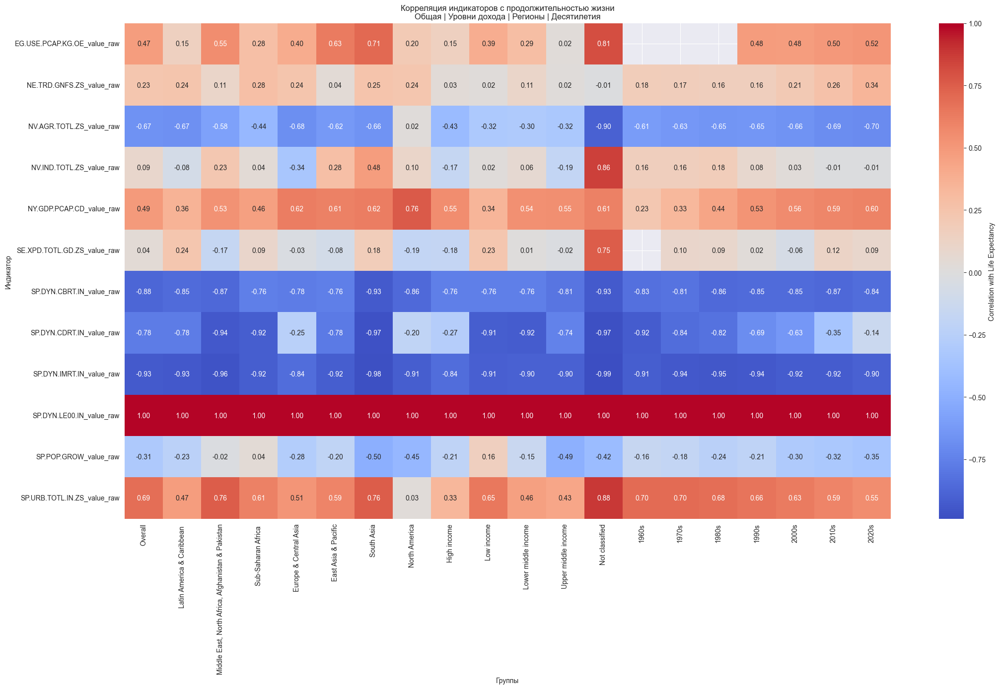

In [196]:
corr_table.index.name = 'Indicator'

plt.figure(figsize=(22,14))
sns.heatmap(
    corr_table,
    annot=True,
    fmt=".2f",
    cmap='coolwarm',
    center=0,
    cbar_kws={'label': 'Correlation with Life Expectancy'}
)
plt.title(
    'Корреляция индикаторов с продолжительностью жизни\n'
    'Общая | Уровни дохода | Регионы | Десятилетия'
)
plt.ylabel('Индикатор')
plt.xlabel('Группы')
plt.tight_layout()
plt.show()

- SP.DYN.CBRT.IN (Рождаемость)
Между уровнем рождаемости и продолжительностью жизни наблюдается сильная отрицательная корреляция, что соответствует гипотезе: по мере социально-экономического развития стран рождаемость снижается, а ожидаемая продолжительность жизни увеличивается. В разрезе регионов, уровней дохода и разных десятилетей закономерностей не обнаружено
- SP.DYN.CDRT.IN (Смертность)
Также между уровнем смертности и ожидаемой продолжительностью жизни наблюдается сильная отрицательная корреляция. Однако при интерпретации данного результата необходимо учитывать демографическую природу показателя смертности, в частности его зависимость от возрастной структуры населения.
Анализ в региональном разрезе показывает, что данная связь отчётливо проявляется для Европы и Северной Америки, а также для группы стран с высоким уровнем дохода. При этом сила корреляции в этих группах заметно ниже по сравнению с остальными регионами, что характерно для стран, где большинство населения доживает до пожилого возраста и смертность в большей степени сосредоточена в старших возрастных группах.
Дополнительный анализ в разрезе десятилетий показывает устойчивое ослабление данной связи во времени. Начиная с 2000-х годов корреляция между уровнем смертности и продолжительностью жизни существенно снижается, а в наиболее поздних периодах становится статистически слабой, что свидетельствует о снижении информативности общего показателя смертности для объяснения динамики продолжительности жизни в современных условиях.
- SP.POP.GROW (Рост населения)
В целом между уровнем рождаемости и ожидаемой продолжительностью жизни наблюдается умеренная отрицательная корреляция.
Усиление отрицательной корреляции между рождаемостью и продолжительностью жизни во времени отражает глобальное снижение рождаемости и рост продолжительности жизни в большинстве стран с высоким уровнем дохода. В то же время для регионов Африки и стран с низким уровнем дохода данная связь ослабевает или меняет направление, что связано с сохранением высокой рождаемости при одновременном росте продолжительности жизни, обусловленном снижением детской смертности и улучшением базовых условий здравоохранения.
- SP.DYN.IMRT.IN (Детская смертность)
Между детской смертностью и ожидаемой продолжительностью жизни наблюдается очень сильная отрицательная корреляция, что отражает роль детской смертности как косвенного индикатора уровня здравоохранения и качества медицины.
В Европе и странах с высоким уровнем дохода эта корреляция слабеет, поскольку в этих странах детская смертность уже крайне низкая и почти не варьируется: продолжительность жизни определяется в большей степени старшими возрастными группами и социально-экономическими факторами, а не риском смерти в младенчестве
При анализе в разрезе десятилетий тенденций к изменению силы корреляции не выявлено
- NY.GDP.PCAP.CD (ВВП)
Между уровнем ВВП на душу населения и ожидаемой продолжительностью жизни наблюдается умеренная положительная корреляция, которая усиливается со временем.
Сильнее всего связь проявляется в более развитых странах и регионах, где рост доходов тесно связан с улучшением условий жизни, доступом к медицине и повышением качества питания.
В странах с низким уровнем дохода, особенно в Африке, сила корреляции заметно ниже, что отражает ограниченное влияние экономического роста на продолжительность жизни на фоне других факторов, таких как высокая детская смертность и проблемы базового здравоохранения
- NE.TRD.GNFS.ZS (Торговля)
Между уровнем торговли и ожидаемой продолжительностью жизни наблюдается слабо-умеренная положительная связь, которая со временем усиливается и становится умеренной.
В то же время в разрезе регионов заметна значительная вариативность. Связь сильнее в регионах, где торговля отражает реальный уровень экономического развития, и слабее в регионах с большим числом стран, чья экономика ориентирована почти исключительно на внешнюю торговлю (например, небольшие островные государства в Тихоокеанском регионе), где размер торговли не коррелирует с общей развитостью экономики
- EG.USE.PCAP.KG.OE (Энергопотребление)
Между энергопотреблением на душу населения и ожидаемой продолжительностью жизни наблюдается умеренная положительная корреляция, при этом выраженных временных тенденций не выявлено.
В разрезе уровня дохода заметна определённая закономерность: в странах с низким доходом связь сильнее, что может отражать то, что рост энергопотребления в этих странах тесно связан с улучшением базовой инфраструктуры, доступом к электричеству и бытовым удобствам, напрямую влияющими на здоровье и продолжительность жизни.
- NV.AGR.TOTL.ZS (С/х)
Между долей сельского хозяйства в ВВП и ожидаемой продолжительностью жизни наблюдается сильная отрицательная корреляция, которая со временем слегка усиливается.
В странах с высоким уровнем дохода эта связь особенно выражена, поскольку с уменьшением доли сельского сектора экономика становится более индустриализированной и сервисно-ориентированной, что сопровождается улучшением условий жизни и ростом продолжительности жизни.
В Африке и странах с низким доходом корреляция слабее, что отражает высокую долю сельского сектора как структурный фактор экономики и меньшую вариативность этого показателя относительно других экономических изменений.
- NV.IND.TOTL.ZS (Промышленность)
Между долей промышленности в ВВП и ожидаемой продолжительностью жизни наблюдается слабая положительная связь, которая со временем ослабевает и в целом стремится к нулю.
В странах с более высоким уровнем дохода направление связи может меняться: в этих странах рост промышленности не всегда сопровождается улучшением условий жизни, а иногда отражает индустриальные структуры с экологическими и социальными рисками.
В Европе наблюдается умеренная отрицательная корреляция, что связано с высокой индустриализацией при уже высокой продолжительности жизни; в Латинской Америке и Северной Америке корреляция близка к нулю, а в остальных регионах — положительная, поскольку рост промышленности сопровождается улучшением экономических условий и инфраструктуры, что положительно влияет на продолжительность жизни.
- SP.URB.TOTL.IN.ZS (Урбанизация)
Между уровнем урбанизации и ожидаемой продолжительностью жизни наблюдается сильная положительная корреляция, которая со временем постепенно слабеет.
В странах и регионах с низким уровнем дохода связь выражена сильнее, что объясняется тем, что рост урбанизации в этих странах сопровождается улучшением инфраструктуры, доступа к медицине и качеством жизни.
В более развитых странах влияние урбанизации на продолжительность жизни менее выражено, так как базовая инфраструктура и здравоохранение уже находятся на высоком уровне, и дальнейший рост урбанизации не оказывает существенного прямого эффекта на продолжительность жизни.
- SE.XPD.TOTL.GD.ZS (расходы на образование)
Между расходами на образование и ожидаемой продолжительностью жизни наблюдается почти нулевая положительная связь.
В странах с низким уровнем дохода корреляция выше, что отражает прямое влияние увеличения государственных расходов на образование на доступ к знаниям, навыкам и косвенно на здоровье населения.
В странах с высоким уровнем дохода связь может меняться на отрицательную, поскольку базовый уровень образования уже высок, и дальнейшие расходы на образование не оказывают прямого влияния на продолжительность жизни

У нас есть три показателя: ВВП, процент торговли, энергопотребелние, которые имеют довольно большой разброс значений, а также довольно много выбрососв, которые нежелательно фильтровать. Для нахождения предыдущей матрицы кореляций мы использовали критерий Пирсона (по умолчанию), однако он менее робастен к выбросам в отличие от критерия спирмана, поэтому для данных индикаторов найдем матрицу корреляций по Спирману

In [197]:
raw_cols = ["NY.GDP.PCAP.CD_value_raw", "EG.USE.PCAP.KG.OE_value_raw", "NE.TRD.GNFS.ZS_value_raw","SP.DYN.LE00.IN_value_raw"]
flag_cols = [c.replace('_value_raw', '_flag') for c in raw_cols]

In [198]:
corr_table_s = pd.DataFrame()

df_all = prepare_corr_df(df)
corr_1 = df_all.corr(method='spearman')
corr_table_s['Overall'] = df_all.corr(method='spearman')['SP.DYN.LE00.IN_value_raw']

In [199]:
for region in df['region_value'].unique():
    df_region = df[df['region_value'] == region]
    corr_table_s[region] = (
        prepare_corr_df(df_region)
        .corr(method='spearman')['SP.DYN.LE00.IN_value_raw']
    )
for level in df['income_level_value'].unique():
    df_level = df[df['income_level_value'] == level]
    corr_table_s[level] = (
        prepare_corr_df(df_level)
        .corr(method='spearman')['SP.DYN.LE00.IN_value_raw']
    )
df['decade'] = (df['date'] // 10) * 10

for decade in sorted(df['decade'].unique()):
    df_decade = df[df['decade'] == decade]
    if df_decade.shape[0] < 100:
        continue
    corr_table_s[f'{decade}s'] = (
        prepare_corr_df(df_decade)
        .corr(method='spearman')['SP.DYN.LE00.IN_value_raw']
    )

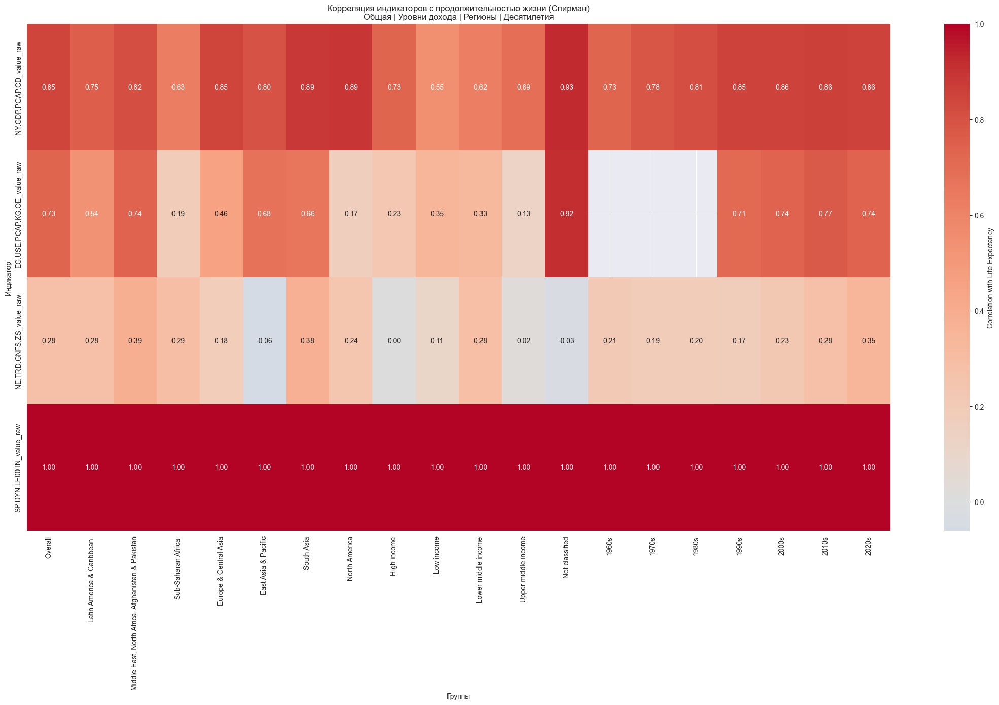

In [200]:
corr_table.index.name = 'Indicator'

plt.figure(figsize=(22,14))
sns.heatmap(
    corr_table_s,
    annot=True,
    fmt=".2f",
    cmap='coolwarm',
    center=0,
    cbar_kws={'label': 'Correlation with Life Expectancy'}
)
plt.title(
    'Корреляция индикаторов с продолжительностью жизни (Спирман)\n'
    'Общая | Уровни дохода | Регионы | Десятилетия'
)
plt.ylabel('Индикатор')
plt.xlabel('Группы')
plt.tight_layout()
plt.show()

- NY.GDP.PCAP.CD (ВВП) - подтверждает прошлые выводы, связь становится сильная
Между уровнем ВВП на душу населения и ожидаемой продолжительностью жизни наблюдается сильная положительная корреляция, которая усиливается со временем.
Сильнее всего связь проявляется в более развитых странах и регионах, где рост доходов тесно связан с улучшением условий жизни, доступом к медицине и повышением качества питания.
В странах с низким уровнем дохода, особенно в Африке, сила корреляции заметно ниже, что отражает ограниченное влияние экономического роста на продолжительность жизни на фоне других факторов, таких как высокая детская смертность
- EG.USE.PCAP.KG.OE (Энергопотребление) подтверждает прошлые выводы, связь становится сильная
Между энергопотреблением на душу населения и ожидаемой продолжительностью жизни наблюдается сильная положительная корреляция, при этом выраженных временных тенденций не выявлено.
В разрезе уровня дохода заметна определённая закономерность: в странах с низким доходом связь сильнее, что может отражать то, что рост энергопотребления в этих странах тесно связан с улучшением базовой инфраструктуры, доступом к электричеству и бытовым удобствам, напрямую влияющими на здоровье и продолжительность жизни.
- NE.TRD.GNFS.ZS (Торговля) одтверждает прошлые выводы, связь становится сильнее
Между уровнем торговли и ожидаемой продолжительностью жизни наблюдается слабо-умеренная положительная связь, которая со временем усиливается и становится умеренной.
В то же время в разрезе регионов заметна значительная вариативность. Связь сильнее в регионах, где торговля отражает реальный уровень экономического развития, и слабее в регионах с большим числом стран, чья экономика ориентирована почти исключительно на внешнюю торговлю (например, небольшие островные государства в Тихоокеанском регионе), где размер торговли не коррелирует с общей развитостью экономики
Как итог сравнения - тенденции для разных критериев схожи, критерий Спирмана лишь усиливает силу связи

## NY.GDP.PCAP.CD

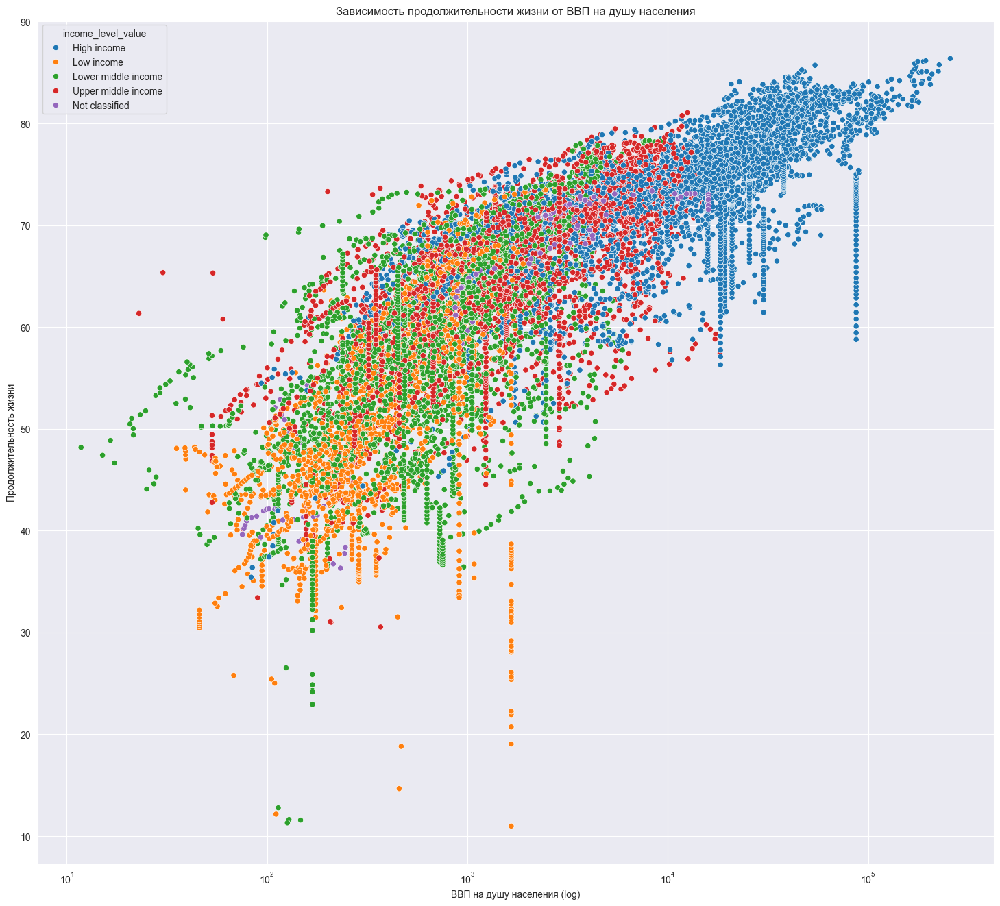

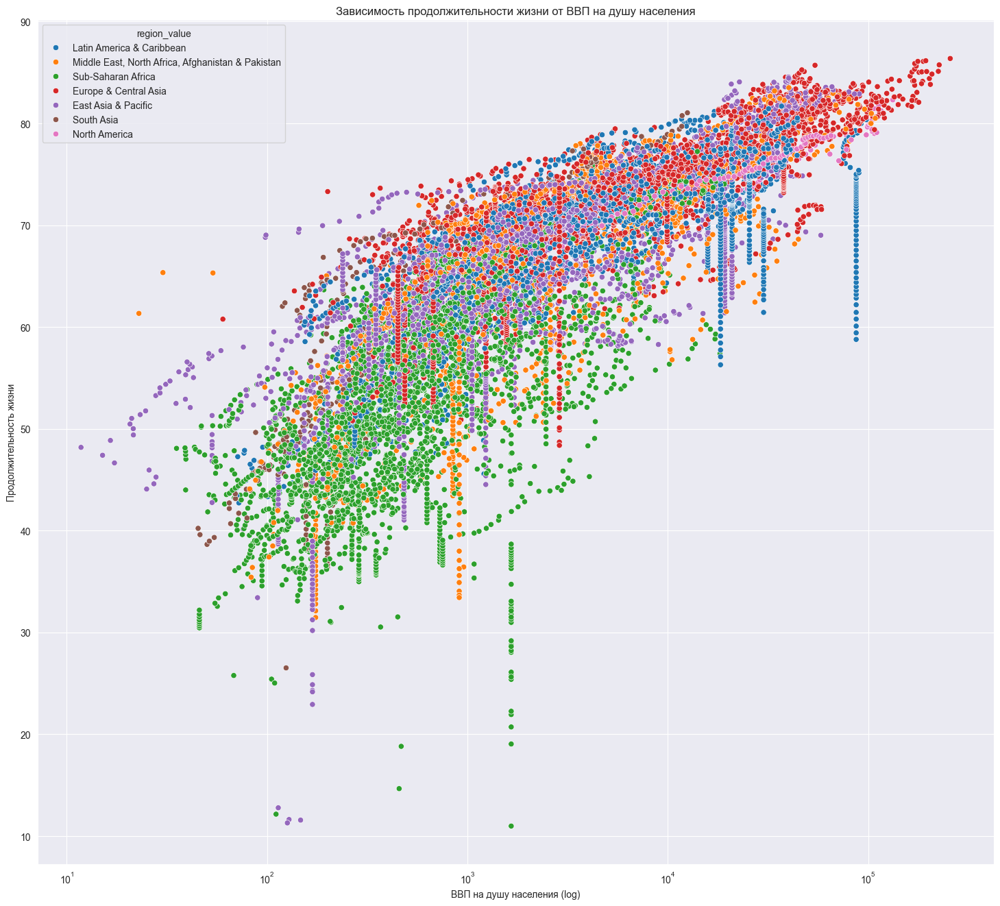

In [201]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NY.GDP.PCAP.CD_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от ВВП на душу населения')
plt.xlabel('ВВП на душу населения (log)')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NY.GDP.PCAP.CD_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от ВВП на душу населения')
plt.xlabel('ВВП на душу населения (log)')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

## SP.DYN.CBRT.IN

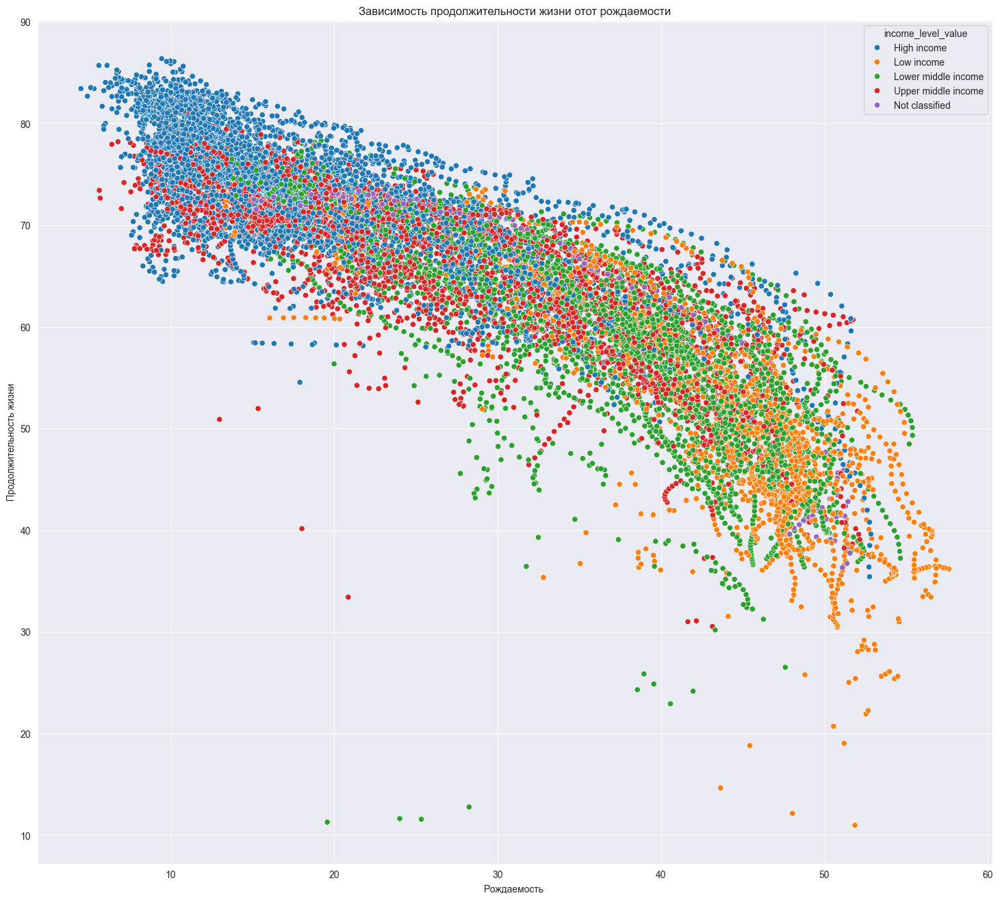

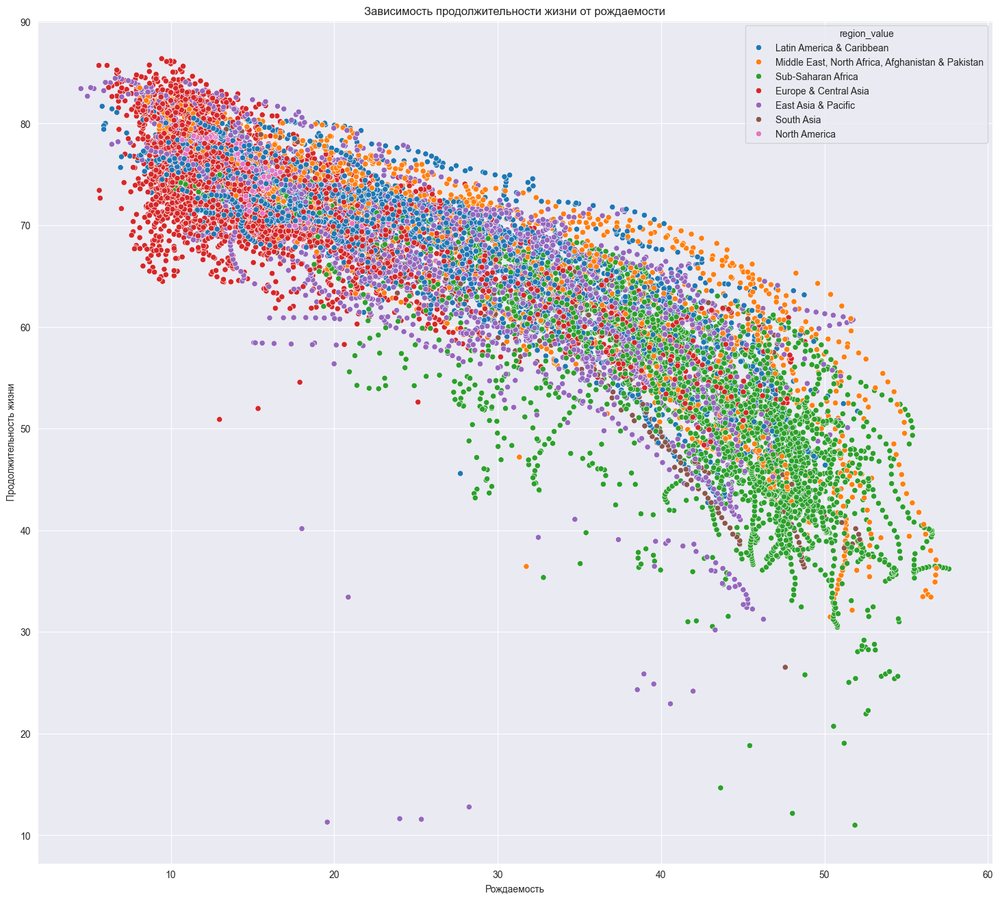

In [202]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.CBRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни отот рождаемости')
plt.xlabel('Рождаемость ')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.CBRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от рождаемости')
plt.xlabel('Рождаемость')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

## SP.DYN.CDRT.IN

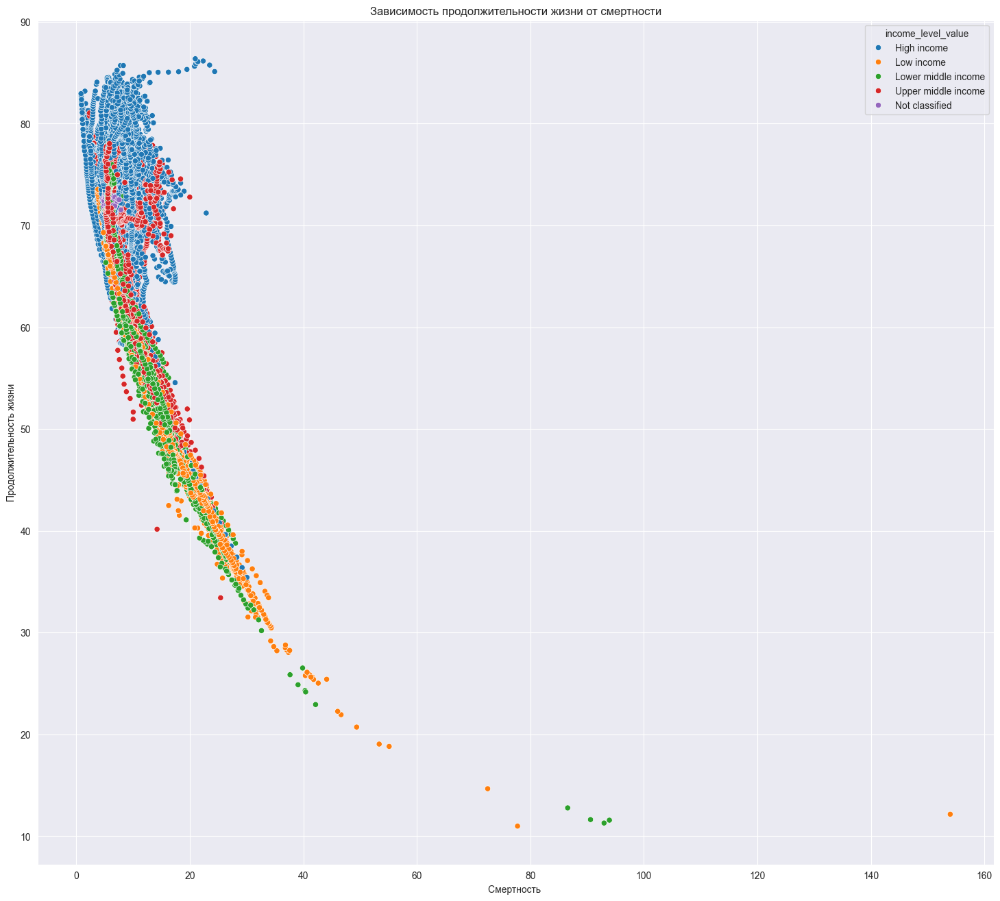

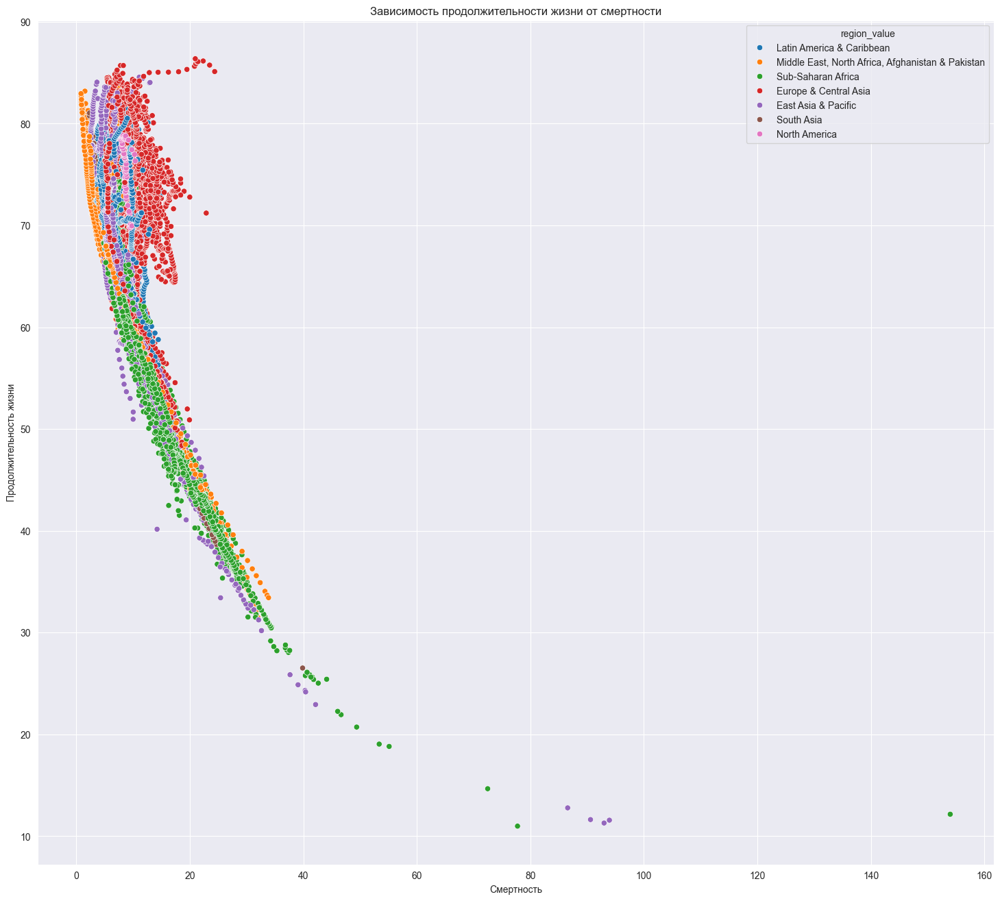

In [203]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.CDRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от смертности')
plt.xlabel('Смертность ')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.CDRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от смертности')
plt.xlabel('Смертность')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

## SP.POP.GROW

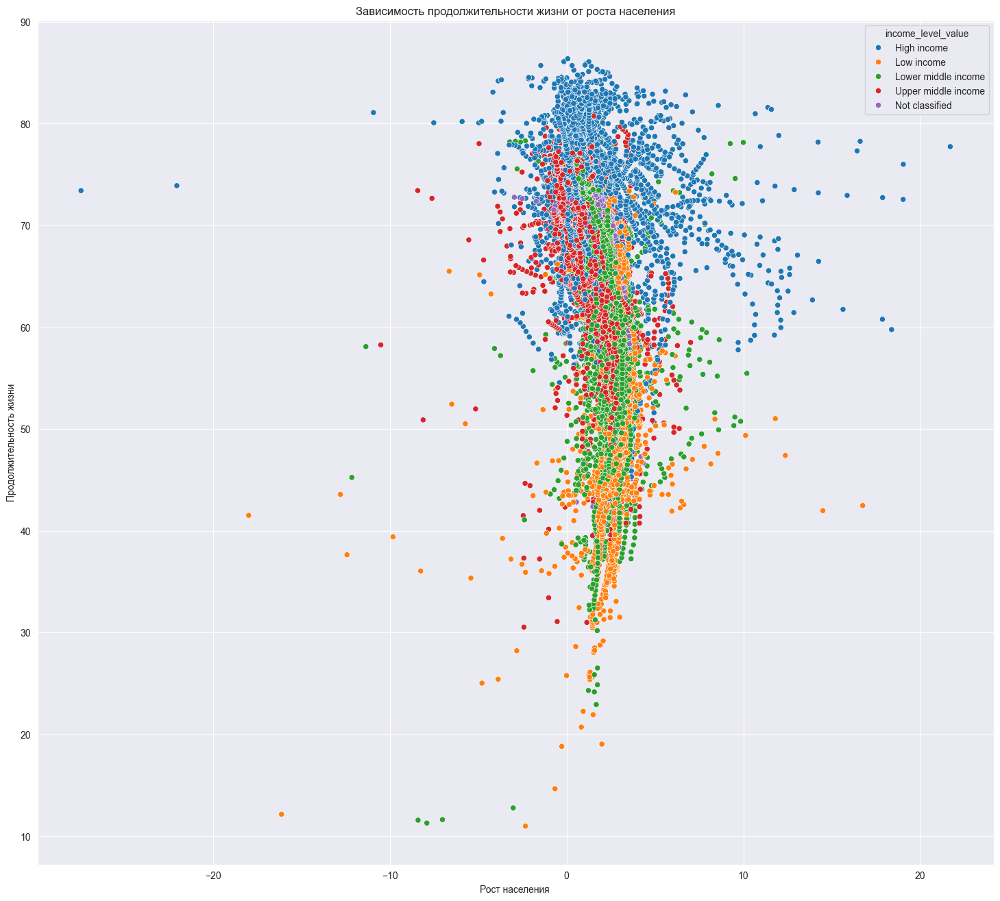

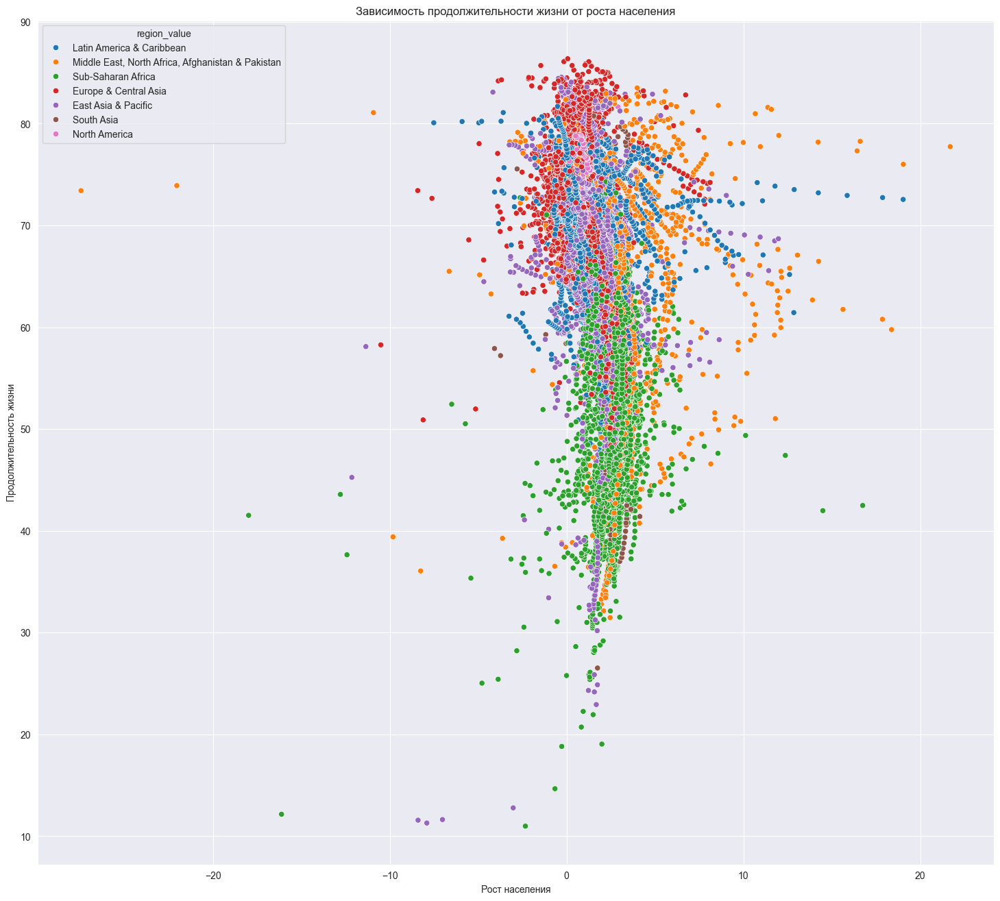

In [204]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.POP.GROW_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от роста населения')
plt.xlabel('Рост населения ')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.POP.GROW_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от роста населения')
plt.xlabel('Рост населения')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

Если предыдущие графики подтверждали анализ таблицы корреляций, то данная диаграма рассеяния показывает что по факту связи нет

## SP.DYN.IMRT.IN

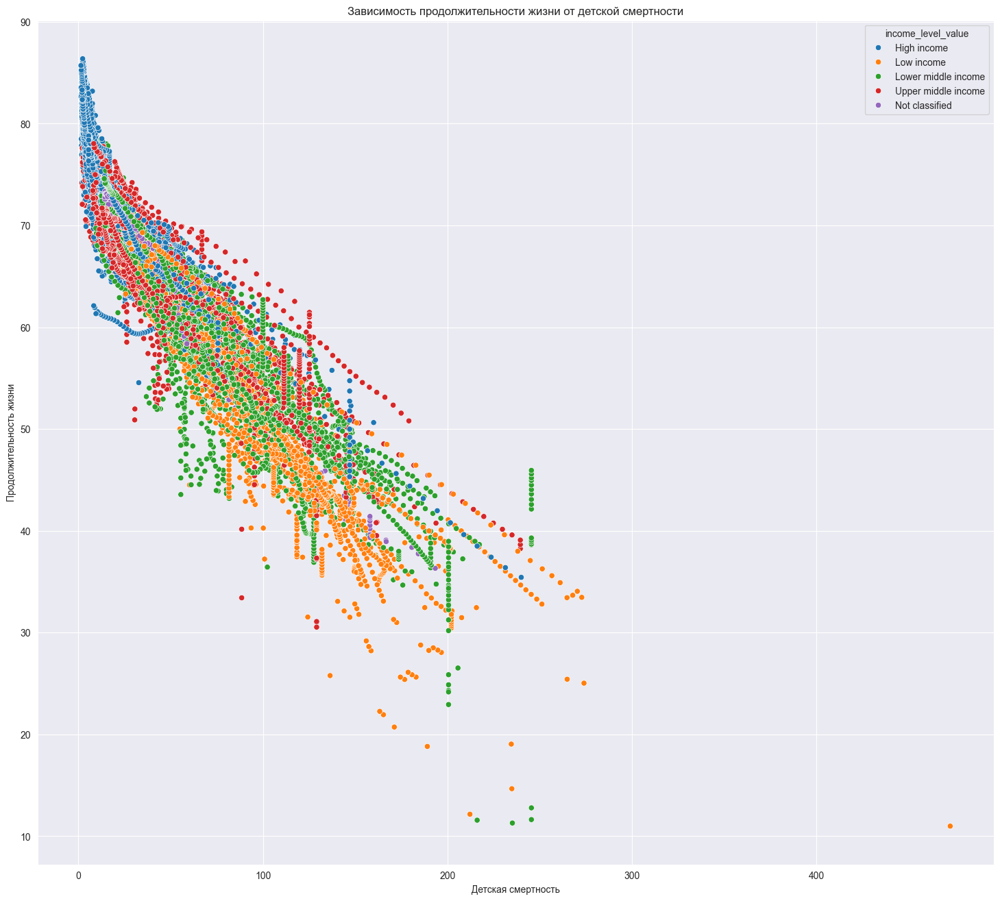

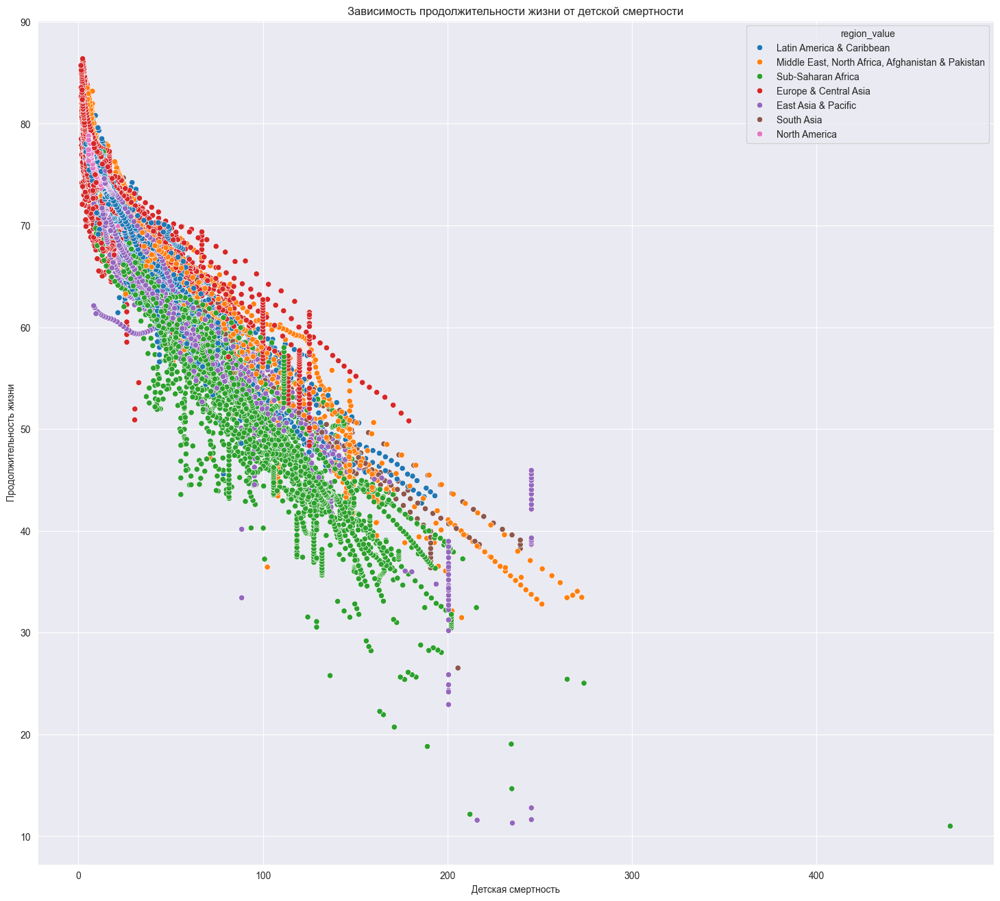

In [205]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.IMRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от детской смертности')
plt.xlabel('Детская смертность')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.DYN.IMRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от детской смертности')
plt.xlabel('Детская смертность')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

## NE.TRD.GNFS.ZS

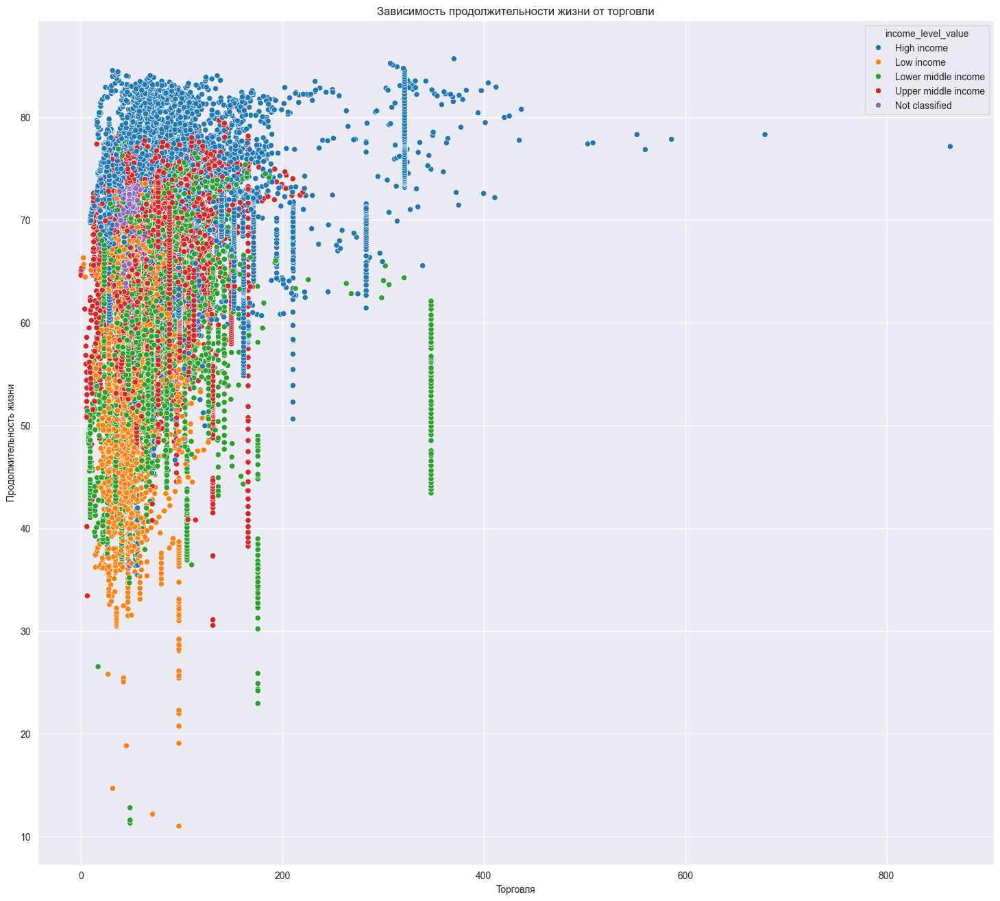

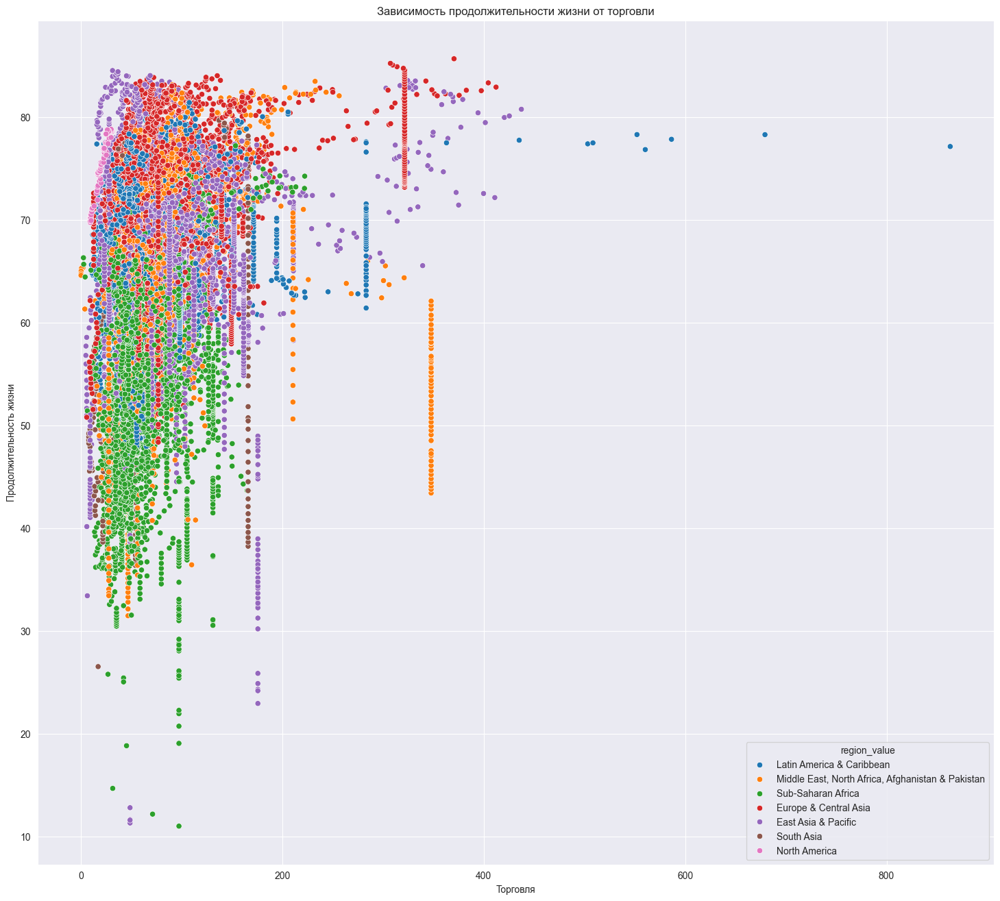

In [206]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NE.TRD.GNFS.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от торговли')
plt.xlabel('Торговля')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NE.TRD.GNFS.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от торговли')
plt.xlabel('Торговля')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

Данная диаграмма отражает отсутсвие взаимосвязи

## EG.USE.PCAP.KG.OE

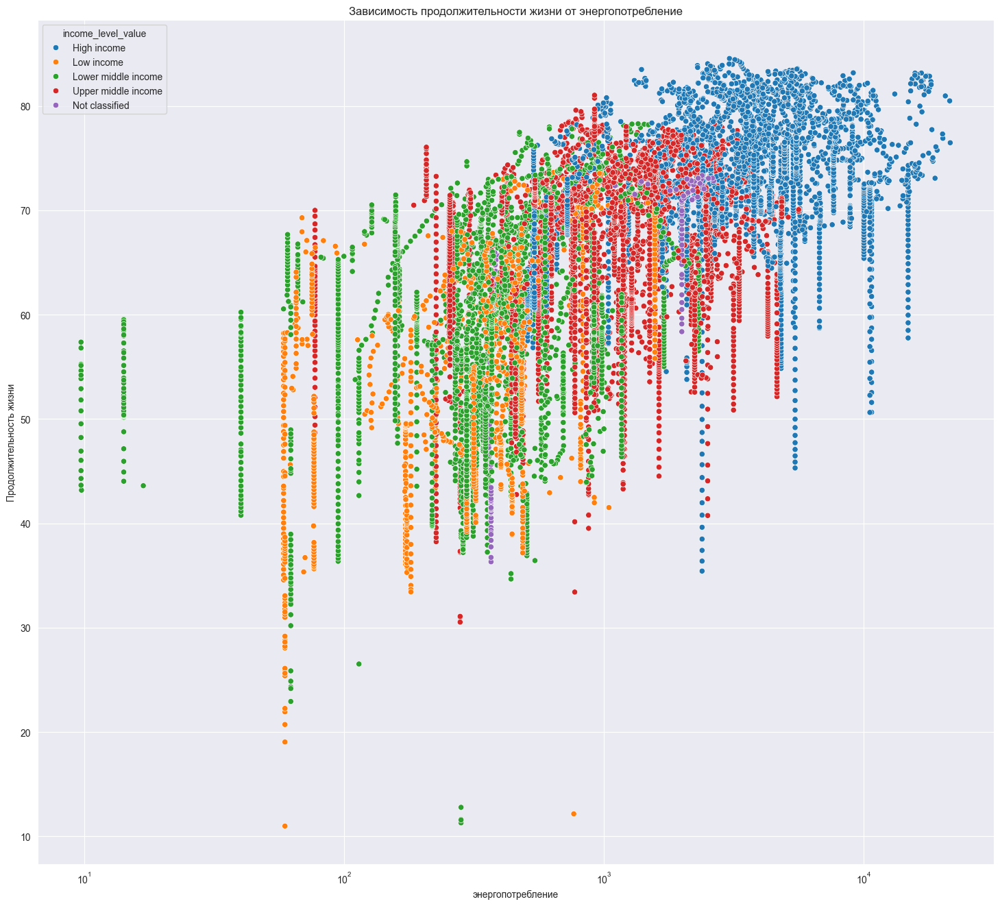

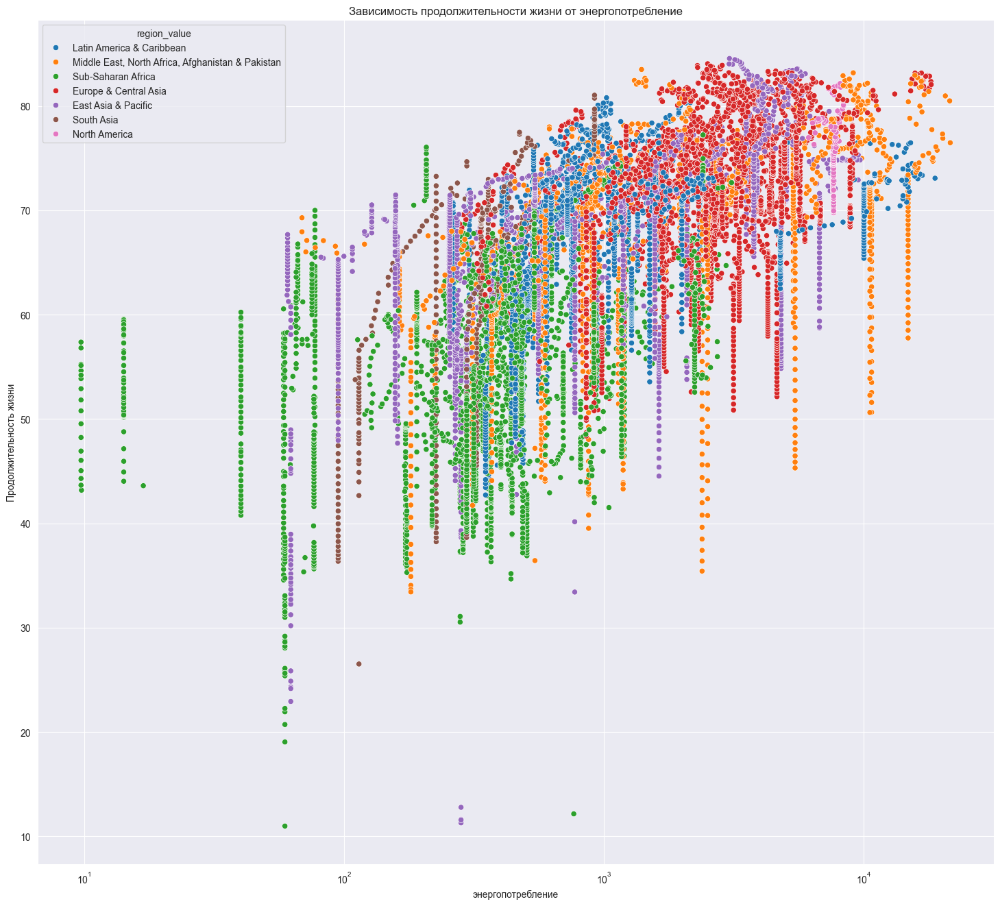

In [207]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='EG.USE.PCAP.KG.OE_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от энергопотребление')
plt.xlabel('энергопотребление')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='EG.USE.PCAP.KG.OE_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от энергопотребление')
plt.xlabel('энергопотребление')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

Связь наблюдается, тольок слабощуутима ввидимое различие силы корреляции в разрезе регионов и уровней дохода как была со сммертностью к примеру. Довольно шумно, возможно как результат интерполяции

## NV.AGR.TOTL.ZS

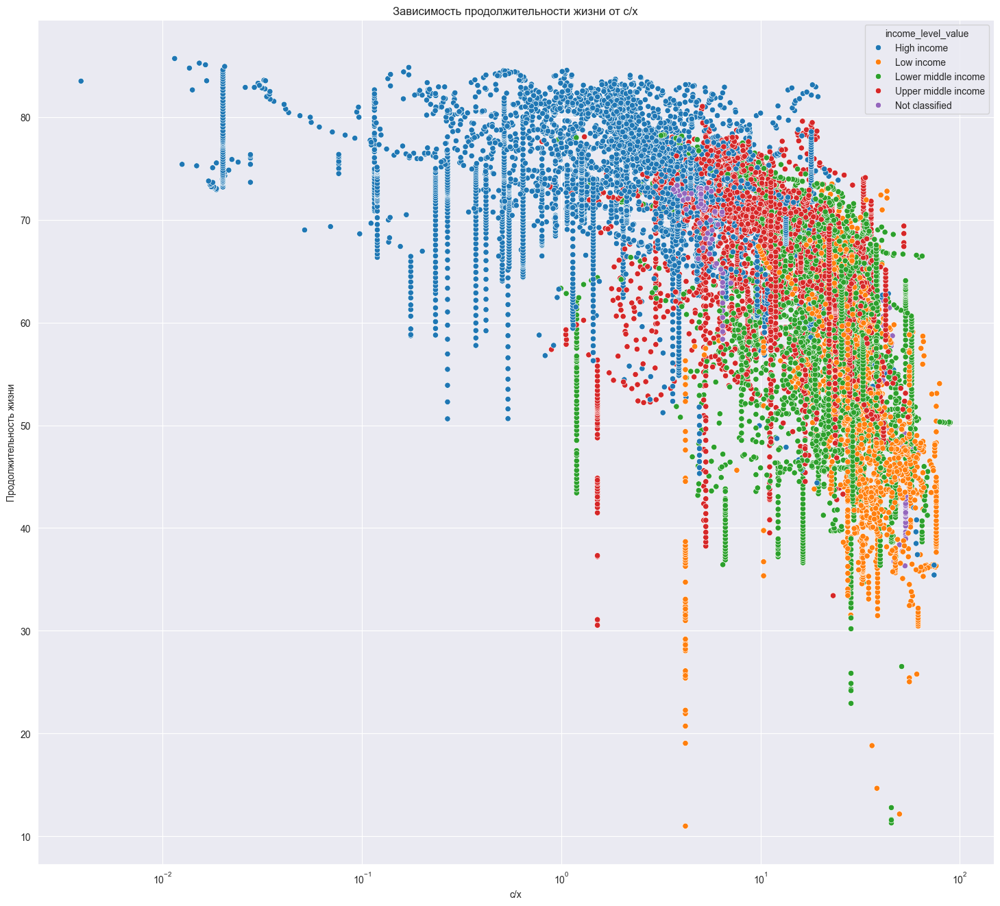

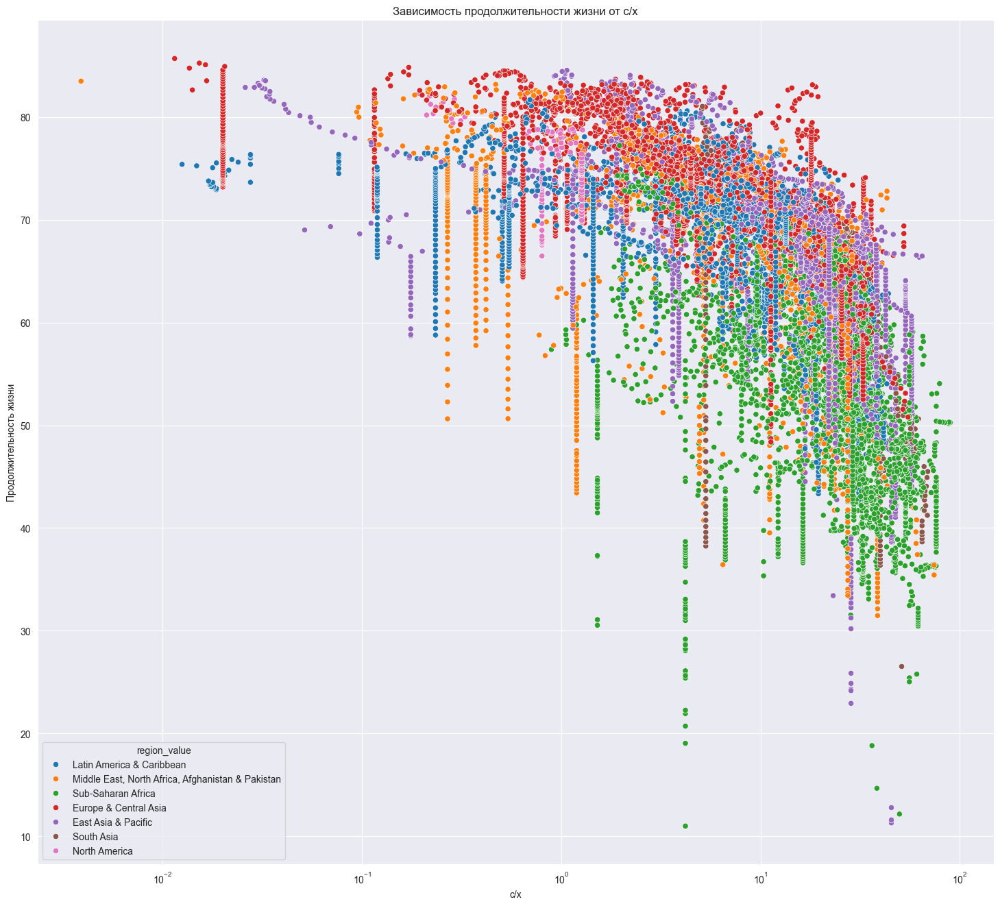

In [208]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NV.AGR.TOTL.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от c/x')
plt.xlabel('c/x')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NV.AGR.TOTL.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от c/x')
plt.xlabel('c/x')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

## NV.IND.TOTL.ZS

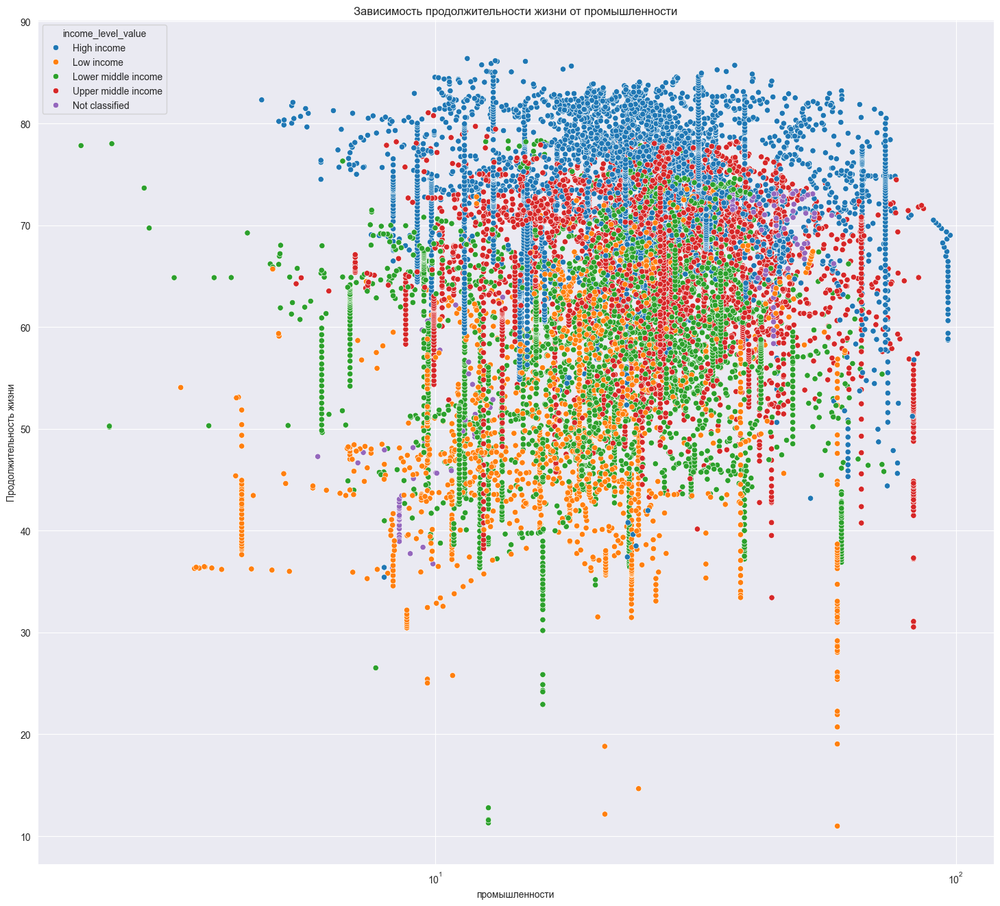

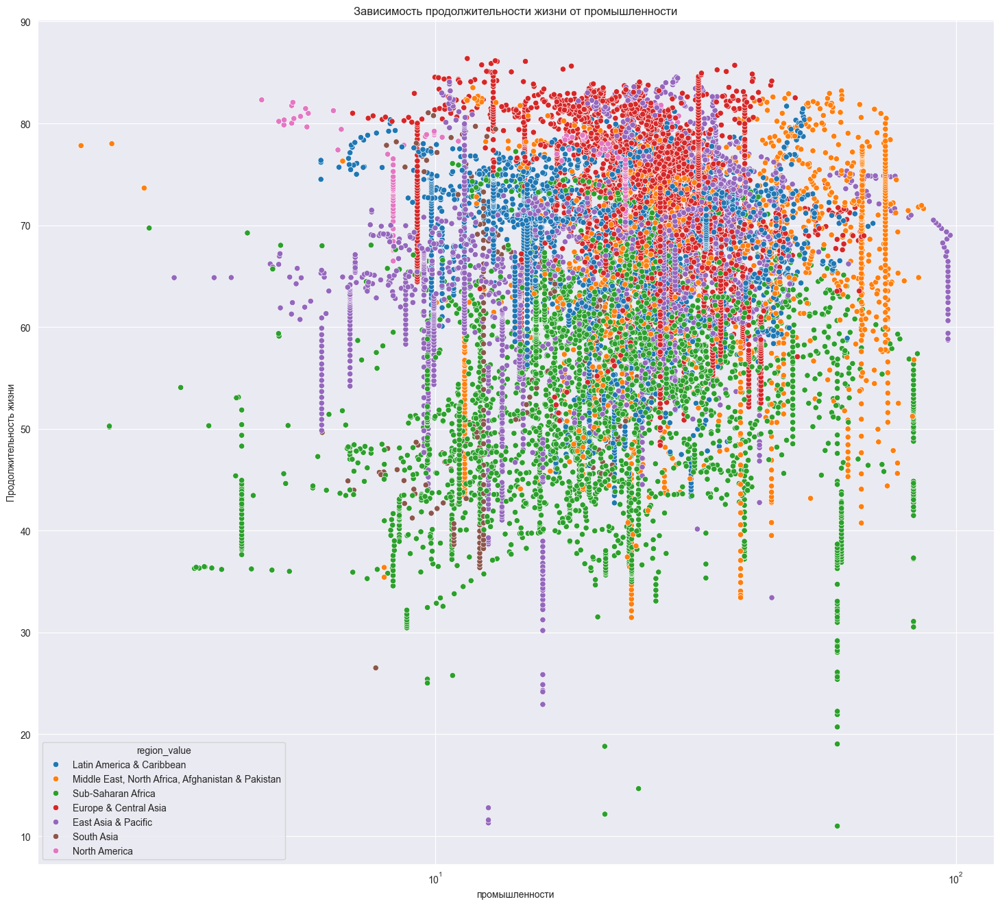

In [209]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NV.IND.TOTL.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от промышленности')
plt.xlabel('промышленности')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='NV.IND.TOTL.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
plt.xscale('log')
plt.title('Зависимость продолжительности жизни от промышленности')
plt.xlabel('промышленности')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

В целом как буд-то никакой связи нет, однако если приглядется в разрезе дохода и региона, можно заметить связи. Наиболее ярко выражено, страны с низкиим уровнем, регион африка, там где действительно уровень промышленности показатель индикатор лучших условий жизни

## SP.URB.TOTL.IN.ZS

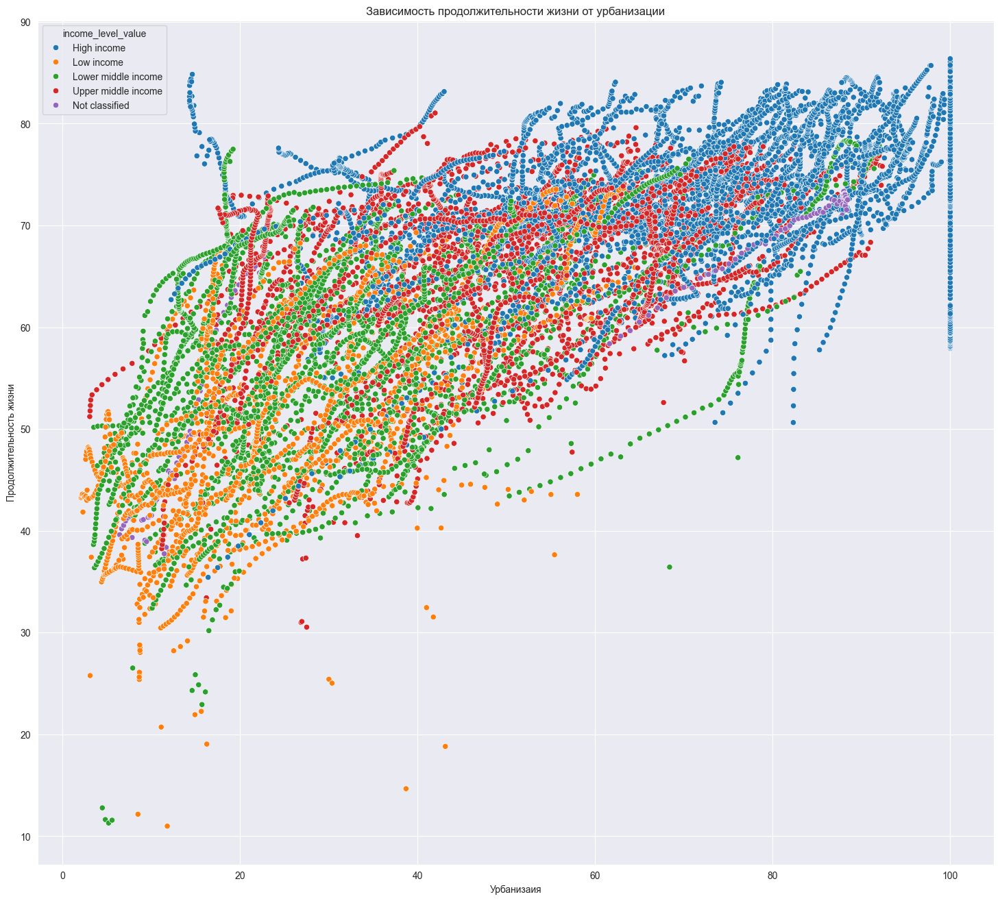

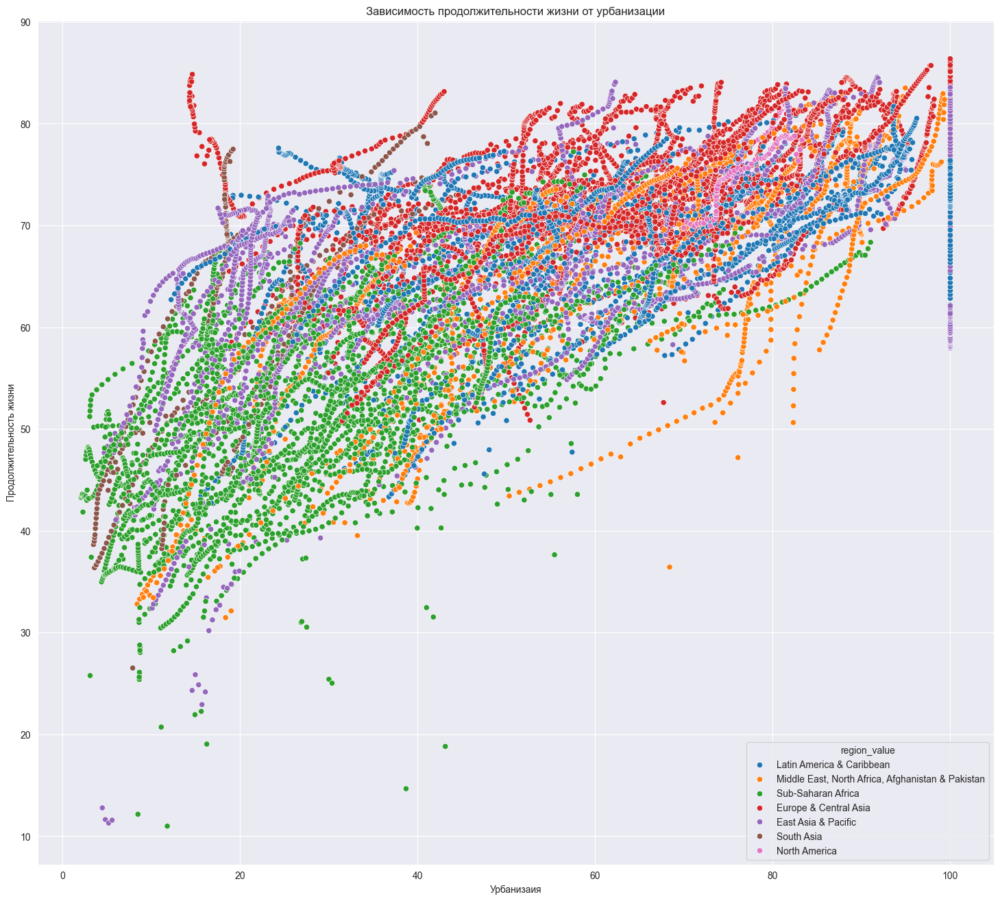

In [210]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.URB.TOTL.IN.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от урбанизации')
plt.xlabel('Урбанизаия')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SP.URB.TOTL.IN.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от урбанизации')
plt.xlabel('Урбанизаия')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

## SE.XPD.TOTL.GD.ZS

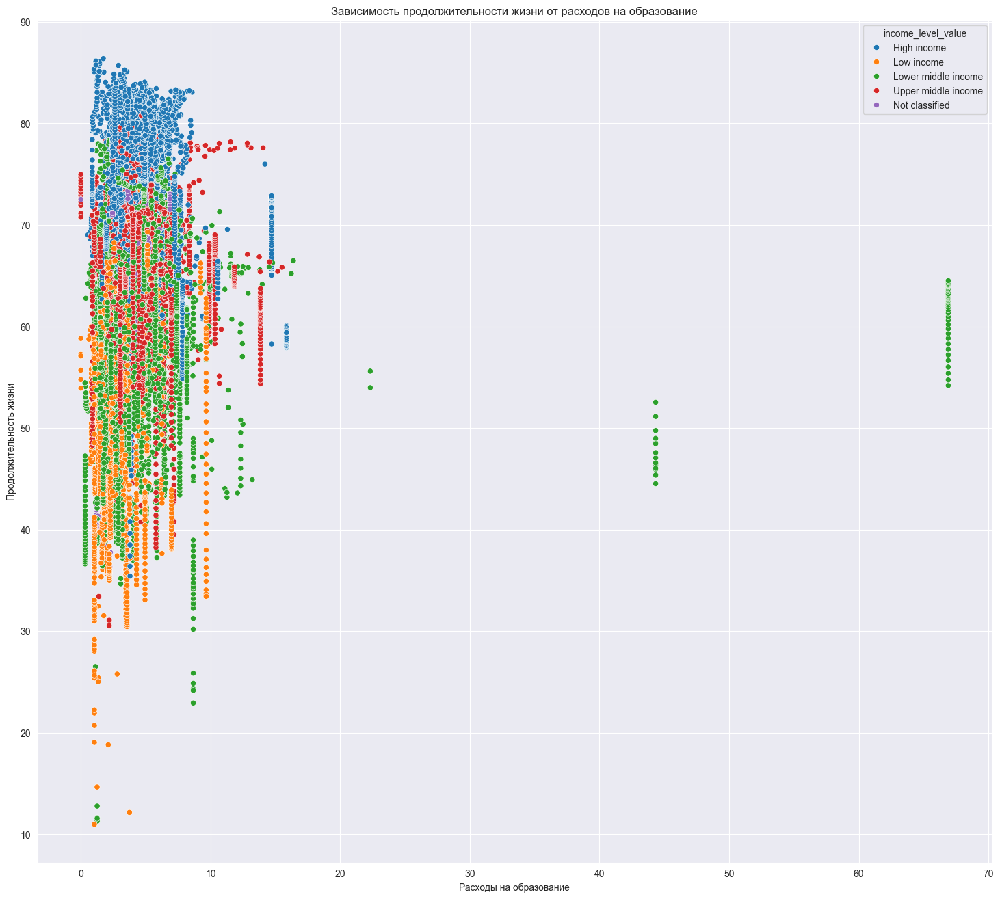

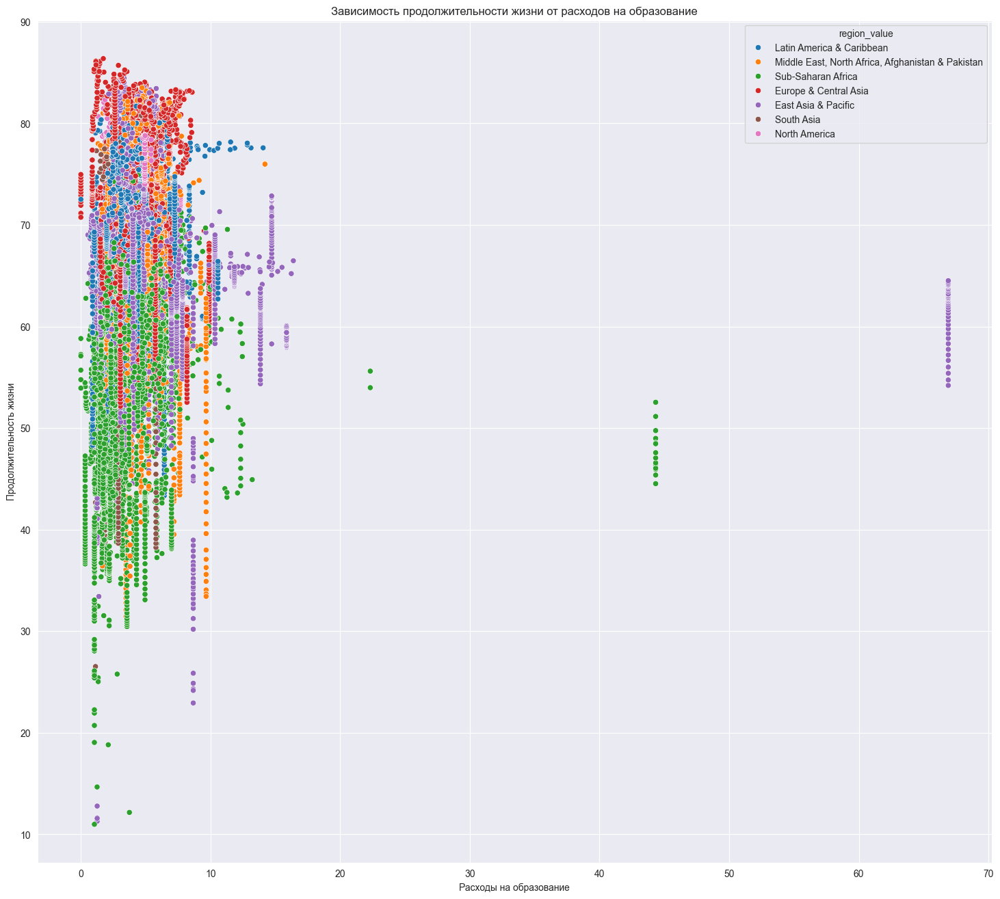

In [211]:
plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SE.XPD.TOTL.GD.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='income_level_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от расходов на образование')
plt.xlabel('Расходы на образование')
plt.ylabel('Продолжительность жизни')
plt.grid(True)
plt.show()

plt.figure(figsize=(18,16))
sns.scatterplot(
    data=df,
    x='SE.XPD.TOTL.GD.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    hue='region_value'
)
#plt.xscale('log')
plt.title('Зависимость продолжительности жизни от расходов на образование')
plt.xlabel('Расходы на образование')
plt.ylabel('Продолжительность жизни')
plt.grid(True)

Яркой связи не ввидно, немного для африки и стран с низким доходом

# Картограмма для показателя продолжительность жизни

In [212]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13504 entries, 448 to 155135
Data columns (total 24 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   country_id              13504 non-null  object 
 1   indicator_id            13504 non-null  object 
 2   date                    13504 non-null  int32  
 3   value                   13504 non-null  float64
 4   id                      13504 non-null  object 
 5   iso2_code               13504 non-null  object 
 6   name                    13504 non-null  object 
 7   capital_city            13504 non-null  object 
 8   longitude               13504 non-null  object 
 9   latitude                13504 non-null  object 
 10  region_id               13504 non-null  object 
 11  adminregion_id          13504 non-null  object 
 12  income_level_id         13504 non-null  object 
 13  lending_type_id         13504 non-null  object 
 14  region_iso2_code        13504 non-null  

In [213]:
import plotly.express as px

min_le = df_1['value'].min()
max_le = df_1['value'].max()

fig = px.choropleth(
    df_1,
    locations="country_id",
    locationmode="ISO-3",
    color="value",
    hover_name="name",
    hover_data={
        "region_value": True,
        "income_level_value": True,
        "value": True
    },
    animation_frame="date",           # Анимация по годам
    color_continuous_scale="Viridis",
    range_color=[min_le, max_le],
    title="Продолжительность жизни по странам (1960-2023)"
)

fig.update_layout(
    width=1400,
    height=800,
    coloraxis_colorbar=dict(title="LE (лет)")
)

fig.show()




В целом все предыдущие умозаключения и идеи о продолжительности жизни в разрезе регинов подтверждаются
Европа, старны Северной Америки Австралия - лидеры, в Центральной африке на ближнем востоке низкая продолжительность жизни
Причем со временем в динамике видно как некоторые страны например Китай некоторые страны ближнего востока, улучшили этот показатель
Также заметен спад продолжительности жизни для всез старн в 2020 году - пандемия COVID

# Структурный анализ

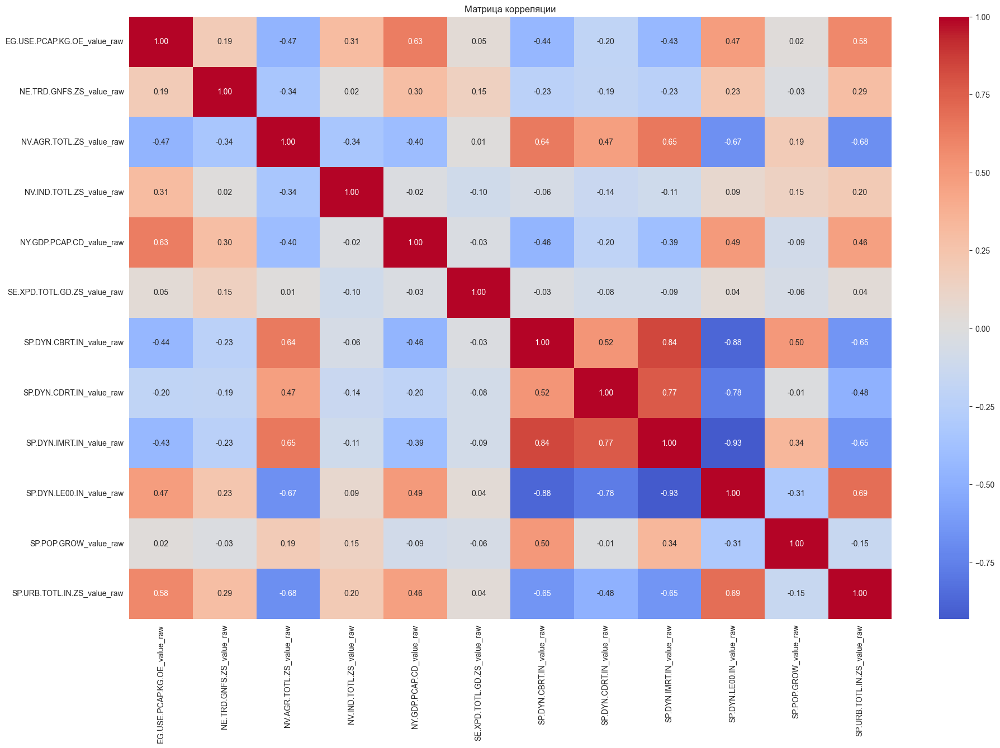

In [214]:
plt.figure(figsize=(22,14))
sns.heatmap(
    corr,
    annot=True,
    fmt=".2f",
    cmap='coolwarm',
    center=0)
plt.title("Матрица корреляции")
plt.show()

После проведенного анализа основные показатели, влияние которых интересно изучить ВВП (экономическая составляющая), детская смертность (как показатель медицины), рождаемость (как демографический показатель), урбанизация (доступ к инфраструктуре), возможно тип экономики
Также основные 4 показателя, являются наиболее ценными, это изначально наиболее полные наборы данных, есть теоретически обоснованная связь с продолжительностью жизни, а также между собой не сильно коррелируют
Продолжительность жизни якорная переменная

In [215]:
fig = px.scatter(
    df,
    x='NY.GDP.PCAP.CD_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    animation_frame='date',
    animation_group='country_id',
    color='income_level_id',
    hover_name='country_id',
    log_x=True,
    labels={
        'NY.GDP.PCAP.CD_value_raw': 'ВВП на душу населения (лог)',
        'SP.DYN.LE00.IN_value_raw': 'Продолжительность жизни'
    },
    title='Динамика: LE и ВВП на душу населения'
)

fig.update_layout(
    width=1400,
    height=800,
    transition={'duration': 300},
    xaxis=dict(range=[np.log10(df['NY.GDP.PCAP.CD_value_raw'].min()),
                      np.log10(df['NY.GDP.PCAP.CD_value_raw'].max())]),
    yaxis=dict(range=[df['SP.DYN.LE00.IN_value_raw'].min()-2,
                      df['SP.DYN.LE00.IN_value_raw'].max()+2])
)

fig.show()

Продолжительность жизни и ВВП на душу населения

Динамическая диаграмма рассеяния «LE - ВВП на душу населения» демонстрирует выраженную положительную, но нелинейную связь между уровнем дохода и продолжительностью жизни. В ранние периоды наблюдается значительный разброс значений LE при низких уровнях ВВП, что указывает на высокую неоднородность стран с низким доходом. По мере времени облако точек смещается вправо и вверх, отражая общий рост как доходов, так и продолжительности жизни.

При этом для стран с высоким уровнем дохода визуально фиксируется эффект насыщения: дальнейший рост ВВП сопровождается лишь незначительным увеличением LE. Это подтверждает гипотезу убывающей отдачи дохода для показателей здоровья и обосновывает использование логарифмической формы ВВП в регрессионном анализе. В динамике также наблюдается сближение стран по уровню LE при сохранении значительных различий в уровне доходов.

In [216]:
fig = px.scatter(
    df,
    x='SP.DYN.IMRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    animation_frame='date',
    animation_group='country_id',
    color='income_level_id',
    hover_name='country_id',
    labels={
        'SP.DYN.IMRT.IN_value_raw': 'Детская смертность (на 1000)',
        'SP.DYN.LE00.IN_value_raw': 'Продолжительность жизни'
    },
    title='Динамика: LE и детская смертность'
)

fig.update_layout(
    width=1400,
    height=900,
    xaxis=dict(autorange='reversed'),
    transition={'duration': 300}
)

fig.show()

Продолжительность жизни и детская смертность

Связь между продолжительностью жизни и детской смертностью носит наиболее устойчивый и структурный характер. Во всех временных срезах наблюдается сильная отрицательная зависимость: снижение детской смертности сопровождается ростом LE. В динамике большинство стран демонстрируют смещение влево по оси детской смертности, что отражает глобальные улучшения в области базовой медицины.

По мере приближения к низким значениям детской смертности разброс продолжительности жизни резко сокращается, что указывает на роль данного показателя в формировании LE. Полученные результаты подтверждают целесообразность включения детской смертности в качестве одного из ключевых факторов как в кластеризацию, так и в регрессионные модели.

In [217]:
fig = px.scatter(
    df,
    x='SP.DYN.CBRT.IN_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    animation_frame='date',
    animation_group='country_id',
    color='income_level_id',
    hover_name='country_id',
    labels={
        'SP.DYN.CBRT.IN_value_raw': 'Рождаемость (на 1000)',
        'SP.DYN.LE00.IN_value_raw': 'Продолжительность жизни'
    },
    title='Динамика: LE и рождаемость'
)

fig.update_layout(
    width=1400,
    height=800,
    transition={'duration': 300}
)

fig.show()

Продолжительность жизни и рождаемость

Диаграмма «LE - рождаемость» наглядно иллюстрирует процесс демографического перехода. В ранние периоды страны характеризуются высокой рождаемостью и низкой продолжительностью жизни. В динамике наблюдается движение стран по криволинейным траекториям в направлении низкой рождаемости и высокой LE.

Важно отметить, что связь между показателями не является линейной: ключевое значение имеет не абсолютное положение страны, а направление её движения во времени. Различия в скорости демографического перехода между регионами приводят к сохранению межстрановой неоднородности. Рождаемость, таким образом, выступает индикатором стадии развития и представляет особую ценность для анализа в разрезе стран.

In [218]:
fig = px.scatter(
    df,
    x='SP.URB.TOTL.IN.ZS_value_raw',
    y='SP.DYN.LE00.IN_value_raw',
    animation_frame='date',
    animation_group='country_id',
    color='income_level_id',
    hover_name='country_id',
    labels={
        'SP.URB.TOTL.IN.ZS_value_raw': 'Уровень урбанизации (%)',
        'SP.DYN.LE00.IN_value_raw': 'Продолжительность жизни'
    },
    title='Динамика: LE и урбанизация'
)

fig.update_layout(
    width=1400,
    height=800,
    transition={'duration': 300}
)

fig.show()

Продолжительность жизни и уровень урбанизации

Анализ связи между продолжительностью жизни и уровнем урбанизации выявляет выраженный нелинейный характер зависимости. На ранних этапах урбанизации рост доли городского населения сопровождается заметным увеличением LE, что связано с улучшением доступа к медицинским, образовательным и инфраструктурным услугам.

Однако после достижения высоких уровней урбанизации (примерно 60–70%) эффект ослабевает, а разброс значений LE увеличивается. Это указывает на насыщение положительного влияния урбанизации и возможное проявление негативных внешних эффектов, таких как экологические и социальные нагрузки. Полученные результаты свидетельствуют о том, что урбанизация является важным фактором роста продолжительности жизни.

## PCA и Кластерный анализ

Ниже приведен PCA (анализ главных компонент) с целью выявления скрытыых структур многомерных даных и оценки степени совместной вариации ключевых социально-экономических и демографических показателей. PCA используется больше для диагностики и описания, который предшествует кластерному анализу.

Результаты PCA будут использоваться для:
- оценки размерности данных и наличия доминирующих осей вариации;
- интерпретации взаимосвязей между показателями;
- визуального анализа расположения стран в пространстве главных компонент;
- проверки предпосылок и устойчивости последующего кластерного анализа.

Для проведения PCA данные были агрегированы в период с 2010-2023, поскольку в этот период данные наиболее полные и менее искаженные интерполяцией, а также отражают современность, при это динамика изменения на всем участке не влияет на результат анализа

Перед применением PCA все переменные были стандартизированы, поскольку метод чувствителен к масштабу измерения. В анализ были включены параметры 5 праметров ( выышеописанные + продолжительность жизни)

In [219]:
features = ['SP.DYN.LE00.IN_value_raw',
            'NY.GDP.PCAP.CD_value_raw',
            'SP.DYN.IMRT.IN_value_raw',
            'SP.DYN.CBRT.IN_value_raw',
            'SP.URB.TOTL.IN.ZS_value_raw']

df_pca = (
    df_panel[df_panel['date'].between(2010, 2023)]
    .groupby(['country_id', 'income_level_id'], as_index=False)
    .agg({col: 'mean' for col in features})
    .dropna()
)

df_pca['NY.GDP.PCAP.CD_value_raw'] = np.log(df_pca['NY.GDP.PCAP.CD_value_raw'])

X = df_pca[features]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA()
X_pca = pca.fit_transform(X_scaled)

explained_variance = pd.DataFrame({
    'PC': [f'PC{i+1}' for i in range(len(features))],
    'ExplainedVariance': pca.explained_variance_ratio_,
    'CumulativeVariance': pca.explained_variance_ratio_.cumsum()
})

explained_variance

,PC,ExplainedVariance,CumulativeVariance
0,PC1,0.812318,0.812318
1,PC2,0.111790,0.924107
2,PC3,0.036871,0.960978
3,PC4,0.025052,0.986030
4,PC5,0.013970,1.000000


In [220]:
loadings = pd.DataFrame(
    pca.components_.T,
    index=features,
    columns=[f'PC{i+1}' for i in range(len(features))]
)

loadings

,PC1,PC2,PC3,PC4,PC5
SP.DYN.LE00.IN_value_raw,0.473523,-0.220470,-0.215462,0.329530,0.756409
NY.GDP.PCAP.CD_value_raw,0.461029,0.166064,0.703788,0.455814,-0.238311
SP.DYN.IMRT.IN_value_raw,-0.459141,0.334801,0.531797,-0.161428,0.606820
SP.DYN.CBRT.IN_value_raw,-0.459402,0.300068,-0.292603,0.781608,-0.048803
SP.URB.TOTL.IN.ZS_value_raw,0.375989,0.849519,-0.299724,-0.216042,0.020977


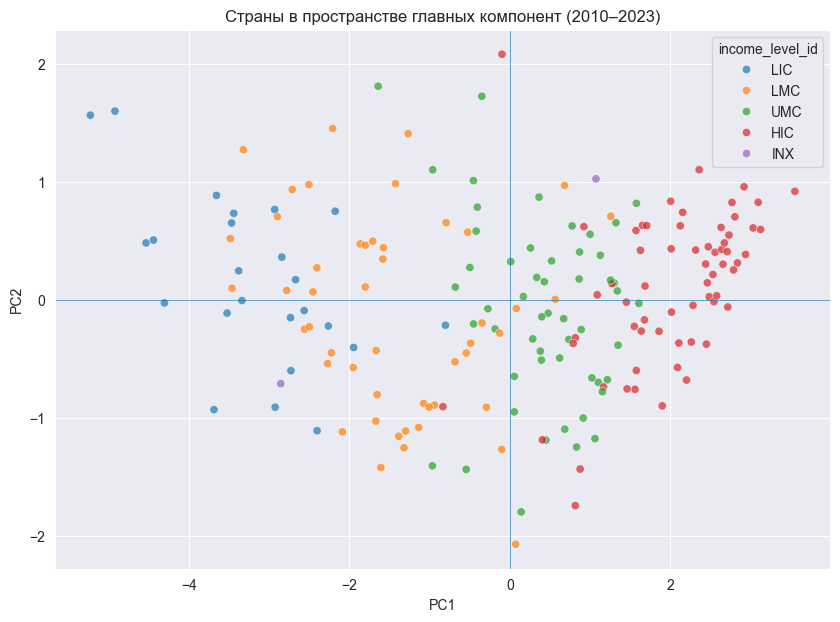

In [221]:

df_pca['PC1'] = X_pca[:, 0]
df_pca['PC2'] = X_pca[:, 1]

plt.figure(figsize=(10, 7))
sns.scatterplot(data=df_pca, x='PC1', y='PC2', hue='income_level_id', alpha=0.7)

plt.axhline(0, linewidth=0.5)
plt.axvline(0, linewidth=0.5)

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Страны в пространстве главных компонент (2010–2023)')
plt.show()

Была выделена доминирующая ярко выраженная ось вариации даных (отражает больше 80% обще дисперсии) отражает собирательный уровень социально-экономического и демографического развития стран. Данная компонента характеризуется положительными нагрузками по ВВП на душу населения, уровню урбанизации и продолжительности жизни, а также отрицательными нагрузками по детской смертности и рождаемости.

Вторая компонента, объясняющая около 11% дисперсии, отражает структурные различия между странами, связанные прежде всего с уровнем урбанизации, и не носит характера шкалы общего развития

Полученнные результаты подтверждают, что выбранные показатели согласованно отражают основные различия между странами, что обосновывает их использование для последующей кластеризации. PCA позволил проверить размерность данных, убедиться в отсутствиии шумных переменных и визуализировать пространственное распределение стран, служащее предварительной диагностикой перед построением кластеров

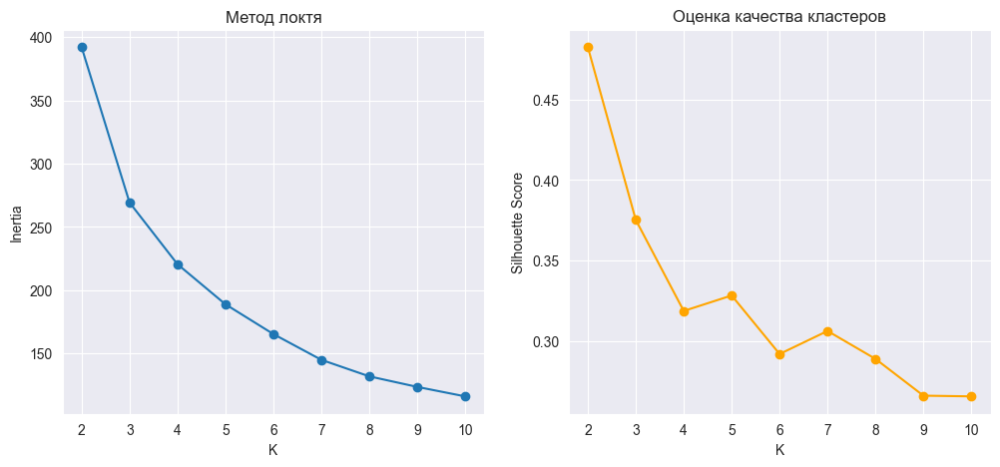

In [222]:
K_range = range(2, 11)  # проверяем от 2 до 10 кластеров
inertia = []
sil_scores = []

for k in K_range:
    kmeans = KMeans(n_clusters=k, init='k-means++', n_init=10, random_state=42)
    labels = kmeans.fit_predict(X_scaled)
    inertia.append(kmeans.inertia_)
    sil_scores.append(silhouette_score(X_scaled, labels))

# График локтя
plt.figure(figsize=(12,5))
plt.subplot(1,2,1)
plt.plot(K_range, inertia, marker='o')
plt.xlabel('K')
plt.ylabel('Inertia')
plt.title('Метод локтя')

# График Silhouette
plt.subplot(1,2,2)
plt.plot(K_range, sil_scores, marker='o', color='orange')
plt.xlabel('K')
plt.ylabel('Silhouette Score')
plt.title('Оценка качества кластеров')
plt.show()

Можно заметить что оптимальное кол-во кластеров 2-3 для большей вариативности выберем 3

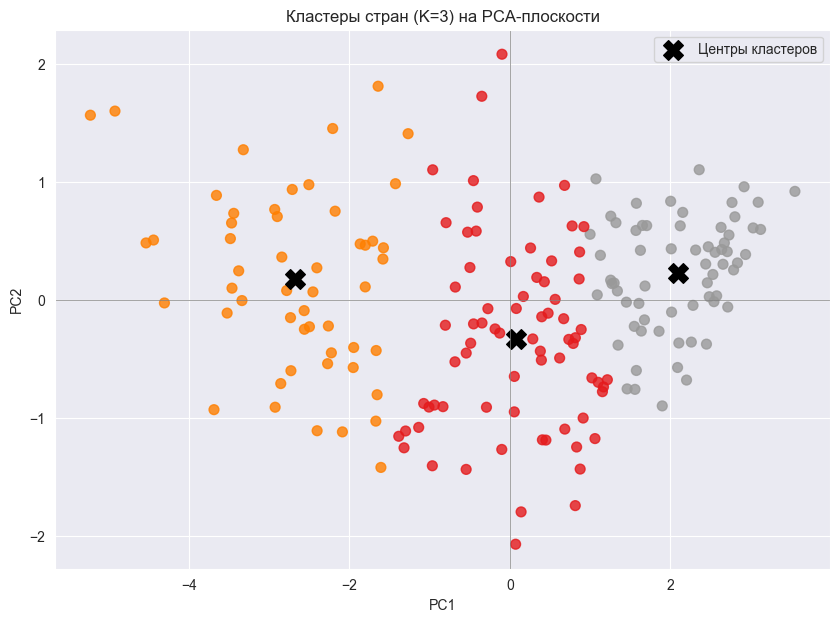

In [223]:
K_opt = 3
kmeans = KMeans(n_clusters=K_opt, init='k-means++', n_init=10, random_state=42)
df_pca['cluster'] = kmeans.fit_predict(X_scaled)


cluster_centers_scaled = kmeans.cluster_centers_
cluster_centers_pca = pca.transform(cluster_centers_scaled)


plt.figure(figsize=(10,7))
scatter = plt.scatter(
    df_pca['PC1'], df_pca['PC2'],
    c=df_pca['cluster'], cmap='Set1', alpha=0.8, s=50
)


plt.scatter(
    cluster_centers_pca[:,0], cluster_centers_pca[:,1],
    c='black', marker='X', s=200, label='Центры кластеров'
)

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title(f'Кластеры стран (K={K_opt}) на PCA-плоскости')
plt.legend()
plt.axhline(0, linewidth=0.5, color='gray')
plt.axvline(0, linewidth=0.5, color='gray')
plt.show()

In [224]:
cluster_summary = df_pca.groupby('cluster')[features].mean().round(2)
cluster_summary['count'] = df_pca.groupby('cluster').size()
display(cluster_summary)

,SP.DYN.LE00.IN_value_raw,NY.GDP.PCAP.CD_value_raw,SP.DYN.IMRT.IN_value_raw,SP.DYN.CBRT.IN_value_raw,SP.URB.TOTL.IN.ZS_value_raw,count
cluster,,,,,,
0,71.65,8.55,17.65,19.08,53.54,73
1,61.35,7.05,51.10,34.09,38.08,53
2,79.22,10.22,5.43,11.64,80.40,65


In [225]:
fig = px.choropleth(
    df_pca,
    locations="country_id",
    color="cluster",
    hover_name="country_id",
    color_continuous_scale=px.colors.qualitative.Set1,
    title="Кластеры стран по уровню развития",
)

fig.update_layout(
    geo=dict(showframe=False, showcoastlines=True),
    coloraxis_showscale=False
)
fig.show()

Кластерный анализ был использован для выявления однородных групп стран на основе совокупности демографических и экономических показателей(их получиилось три). Полученные кластеры отражают различные типы социально-экономического развития и позволяют перейти от анализа отдельных показателей к анализу типологий стран

## Регресионный анализ

In [227]:
features = ['NY.GDP.PCAP.CD_value_raw', 'SP.DYN.IMRT.IN_value_raw',
            'SP.DYN.CBRT.IN_value_raw', 'SP.URB.TOTL.IN.ZS_value_raw']
X = df_pca[features]
y = df_pca['SP.DYN.LE00.IN_value_raw']

# Добавляем константу для intercept
X = sm.add_constant(X)

# Модель
model = sm.OLS(y, X).fit()

# Результаты
print(model.summary())

                               OLS Regression Results                               
Dep. Variable:     SP.DYN.LE00.IN_value_raw   R-squared:                       0.894
Model:                                  OLS   Adj. R-squared:                  0.892
Method:                       Least Squares   F-statistic:                     393.0
Date:                      Mon, 15 Dec 2025   Prob (F-statistic):           1.59e-89
Time:                              23:05:32   Log-Likelihood:                -453.53
No. Observations:                       191   AIC:                             917.1
Df Residuals:                           186   BIC:                             933.3
Df Model:                                 4                                         
Covariance Type:                  nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------

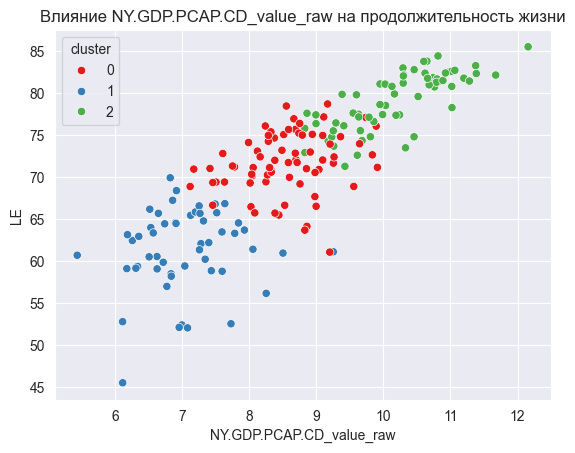

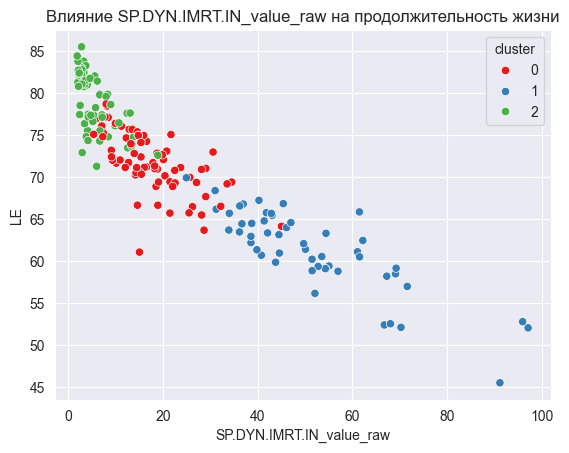

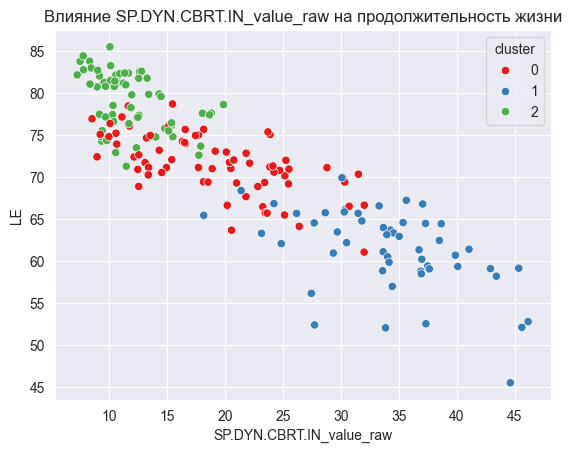

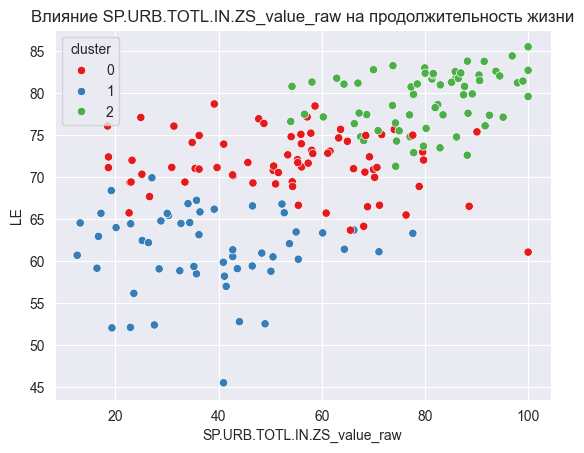

In [228]:
for feat in features:
    sns.scatterplot(x=df_pca[feat], y=y, hue=df_pca['cluster'], palette='Set1')
    plt.xlabel(feat)
    plt.ylabel("LE")
    plt.title(f"Влияние {feat} на продолжительность жизни")
    plt.show()

На данном этапе была построена базовая линейная регрессионная модель для оценки средних связей между продолжительностью жизни и ключевыми показателями
Полученные результаты свидетельствуют о том что продолжительность жизни в среднем по странам тесно связана с уровнем экономического развития и демографическими характеристиками населения
ВВП на душу населения оказывает статистически значимое положительное влияние, что отражает роль экономических ресурсов и доступности медицинских и социальных услуг.
Детская смертность является наиболее сильным негативным фактором, что подчёркивает её роль как интегрального индикатора состояния системы здравоохранения.
Рождаемость имеет отрицательную связь с продолжительностью жизни, что согласуется с теорией демографического перехода.
Урбанизация не демонстрирует статистически значимого эффекта в глобальной модели, что может указывать на неоднородность её влияния между странами.
После выявления типологических групп стран ххочется проверить, являются ли факоторы определяющие продолжительность жизни универсальными или их влияние зависит от уровня социально-экономического развития. Для этого был проведён регрессионный анализ отдельно для каждого кластера стран

In [229]:
results_by_cluster = {}

for cl in sorted(df_pca['cluster'].unique()):
    df_cl = df_pca[df_pca['cluster'] == cl]

    X = df_cl[features]
    y = df_cl['SP.DYN.LE00.IN_value_raw']

    X = sm.add_constant(X)
    model = sm.OLS(y, X).fit()

    results_by_cluster[cl] = model
    print(f"\n===== КЛАСТЕР {cl} =====")
    print(model.summary())


===== КЛАСТЕР 0 =====
                               OLS Regression Results                               
Dep. Variable:     SP.DYN.LE00.IN_value_raw   R-squared:                       0.573
Model:                                  OLS   Adj. R-squared:                  0.547
Method:                       Least Squares   F-statistic:                     22.78
Date:                      Mon, 15 Dec 2025   Prob (F-statistic):           5.74e-12
Time:                              23:05:33   Log-Likelihood:                -165.71
No. Observations:                        73   AIC:                             341.4
Df Residuals:                            68   BIC:                             352.9
Df Model:                                 4                                         
Covariance Type:                  nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------

### Промежуточные выводы

По результатам регресионного анализа в кластерах можно сделать следующие выводы:
- кластер 1 (плохо развитые страны)
Довольно неплохая объясняемость модели R^2 0,73
Можно заметить, что ВВП статистически не значим, как и урбанизация, очень сильная отрицательная стат значимая связь с детской смертности, также отрицательная стат значимая связь с рождаемостью. Для бедных стран рост продолжительность жизни определяется в первую очередь, медициной, санитарными нормами, экономический рост сам по себе не соотв росту продолжительности жизни без базовой инфраструктуры
- кластер 0 (середина)
Можно заметить, что ВВП статистически не значим, как и урбанизация, очень сильная отрицательная стат значимая связь с детской смертности, также отрицательная стат значимая связь с рождаемостью. Большая внутрикластерная неоднородность. Также наименьшая среди всех объясняемость модели, возможно есть скрытые параметры внутри кластера определяющие продолжительность жизни
- кластер 2 (развитые страны)
неплохая объясняемость модели R^2 0,66
Сильная положительная стат значимая связь с ВВП, также отрицательная стат значимая связь с детской смертностью, с рождаемостью связи, однако можно сказать что урбанизация значима условно, небольшая положительная связь. Демографические показатели теряет значение, экономика становится важной но скорее через развитие медицины инфраструктуры


## Статистические тесты

Нулевая гипотеза: Распределения показателя продолжительности жизни одинаковы для всех кластеров
Альтернативная гипотеза: Существует хотя бы один кластер отличающийся от остальных

Ввиду неоднородности распределений и наличия экстремальных значений был использован непараметрический тест Kruskal–Wallis. Он ранжирует данные всех групп, а затем сравнивает суммы рангов, чтобы определить, есть ли статистически значимые различия между группами. Это обобщение критерия Манна-Уитни для трех и более выборок, проверяющее нулевую гипотезу о равенстве медиан

In [230]:

for feat in features:
    groups = [
        df_pca[df_pca['cluster'] == c][feat].dropna()
        for c in sorted(df_pca['cluster'].unique())
    ]
    stat, p = kruskal(*groups)
    print(f"{feat}: H = {stat:.3f}, p-value = {p:.5f}")

NY.GDP.PCAP.CD_value_raw: H = 149.222, p-value = 0.00000
SP.DYN.IMRT.IN_value_raw: H = 155.323, p-value = 0.00000
SP.DYN.CBRT.IN_value_raw: H = 132.409, p-value = 0.00000
SP.URB.TOTL.IN.ZS_value_raw: H = 107.200, p-value = 0.00000


Результаты теста Kruskal–Wallis показали, что все ключевые показатели статистически значимо различаются между выделенными кластерами. Это свидетельствует корректности кластеризации: выявленные группы стран являются структурно различными, а не результатом случайного разбиения данных
Это позволяет утверждать, что выявленные типы стран характеризуются принципиально различными социально-экономическими и демографическими условиями, что обосновывает использование диффференцированного подхода к анализу факторов продолжительности жизни

## Ограничения

1. В первую очередь мы не исследуем на уровне стран и не можем исследовать на уровне регионов стран
2. Данные могут быть ошибочными во-первых за счет интерполяции(пропуски даанных в первоисточнике WB), а также различие методологии получения этих данных
3. Если говорить про регрессию мы использовали линейную модель, которая не может в полной мерее отражать нелинейные тенденции, также полученные регрессионные оценки не позволяют делать однозначные выводы о причинно-следственных связях
Также стоит обратить внимание, что у нас явно есть мультиколлинеарность (можно заметить по показателю Condition Number)
4. Если говорить о кластеризации, то кластеры формальны, предназначены для выявления общих закономерностей, результы кластеризации полностью определяются показателями которые были выбраны, а также методом кластеризации, что может приводить к альтернативным вариантам типологизации стран
5. Анализ фокусируется на относительно коротком и современном временном интервале, что ограничивает возможность изучения долгосрочных исторических эффектов и структурных сдвигов. Это все вне исторического контекста развития стран

## Выводы

В рамках структурного анализа была поставлена задача понять, как страны мира различаются между собой по уровню социально-экономического и демографического развития, и какое место в этой системе занимает продолжительность жизни.

Проведённый анализ главных компонент показал, что между выбранными показателями существует сильная взаимосвязь. Большая часть различий между странами может быть объяснена несколькими обобщающими факторами. В первую очередь это общий уровень развития, который объединяет такие характеристики, как доходы населения, уровень смертности, рождаемость, урбанизация и ожидаемая продолжительность жизни. Это означает, что данные показатели работают не по отдельности, а формируют единую систему.

На основе этих факторов была проведена кластеризация стран, в результате которой удалось выделить три устойчивые группы. Первая группа соответствует развитым странам с высокой продолжительностью жизни, высоким уровнем доходов и благоприятной демографической ситуацией. Вторая группа включает страны со средними значениями показателей, занимающие промежуточное положение. Третья группа представлена развивающимися странами, для которых характерны более низкая продолжительность жизни, высокая младенческая смертность и высокая рождаемость.

Важно отметить, что различия между выделенными кластерами носят не случайный характер. Проведённые статистические тесты подтвердили, что по всем ключевым показателям страны из разных кластеров действительно существенно отличаются друг от друга. Это говорит о том, что полученная типология имеет статистическое обоснование и отражает реальные различия в уровне развития.

Отдельно следует подчеркнуть роль продолжительности жизни. Результаты анализа показывают, что она является итоговым показателем, который аккумулирует влияние экономических, демографических и социальных факторов. Более высокая продолжительность жизни, как правило, наблюдается в странах с высоким уровнем доходов, низкой смертностью и более зрелой демографической структурой.

В целом, структурный анализ позволил перейти от простого сравнения отдельных показателей к более целостному пониманию глобальных различий между странами. Полученные результаты создали логичную основу для последующего регрессионного анализа, в котором уже рассматриваются количественные связи между показателями, а также для более детального изучения факторов, влияющих на продолжительность жизни.